# Prototype Model
---

* Regression
* 2009 data로 class1,2,3 10fold


https://docs.google.com/presentation/d/1cI3teBcQoGBhfrdVrv9rnM4jHGaPToDS7Zh7t0q7GKg/edit#slide=id.g97e66187c6_0_6

In [1]:
import tensorflow as tf 

In [3]:
tf.__version__

'2.4.1'

In [4]:
from random import seed as random_seed
random_seed(50)
from numpy.random import seed as np_random_seed
np_random_seed(50)

tf.random.set_seed(50)

In [5]:
import os

os.sys.path.append(r'/docker_mnt/data5/jin/jin/python/')

os.sys.path

['/whbom/Malocclusion/bom_regression/model',
 '/opt/conda/envs/tensor2.4/lib/python37.zip',
 '/opt/conda/envs/tensor2.4/lib/python3.7',
 '/opt/conda/envs/tensor2.4/lib/python3.7/lib-dynload',
 '',
 '/opt/conda/envs/tensor2.4/lib/python3.7/site-packages',
 '/opt/conda/envs/tensor2.4/lib/python3.7/site-packages/IPython/extensions',
 '/root/.ipython',
 '/docker_mnt/data5/jin/jin/python/']

In [6]:
import tensorflow as tf
tf.__version__
from tensorflow.python.client import device_lib
device_lib.list_local_devices()


[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 14957436086120015951,
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 42991616
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 13715737770349350294
 physical_device_desc: "device: 0, name: TITAN Xp, pci bus id: 0000:02:00.0, compute capability: 6.1"]

In [8]:
%env PYTHONHASHSEED=0
from random import seed as random_seed
random_seed(42)
from numpy.random import seed as np_random_seed
np_random_seed(42)

import glob
import os
import pprint
# from tqdm import tqdm

from IPython import display
import ipywidgets as widgets

# Data Science

%matplotlib inline
from matplotlib import pyplot as plt
plt.style.use('seaborn-white')
import numpy as np
import pandas as pd
import seaborn as sns
sns.set_style('white')

import cv2 as cv

from tensorflow import keras
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
import tensorflow as tf
from tensorflow.keras import models, layers, activations, initializers, regularizers, optimizers, losses, callbacks
from tensorflow.keras import backend as K
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.applications.inception_resnet_v2 import preprocess_input, InceptionResNetV2
from tensorflow.keras.models import load_model

env: PYTHONHASHSEED=0


## Paths
---

In [18]:
so_type = 'so_rl'
input_path_root = r'/whbom/Malocclusion/data/reprocess_data/fullRange_D/'

loss_param=0.5
MODEL_TYPE="prototype"

# <model 저장>
# output_path_root = r'../results/'
output_path_root = r'/whbom/Malocclusion/results/202107_result/'
version="1"
output_path = os.path.join(output_path_root, f'{MODEL_TYPE}_multiout/{loss_param}_frS/full_range_1951', version, so_type)
output_path_weight = os.path.join(output_path, r'weights/')

try:
    os.makedirs(output_path_weight) 
    
except FileExistsError as err:      
    print(err)
# else:
#     print(output_path)
#     print(output_path_weight)

In [19]:
output_path

'/whbom/Malocclusion/results/202107_result/prototype_multiout_multiout/0.5_frS/full_range_1951/1/so_rl'

In [17]:
input_path_root

'/whbom/Malocclusion/data/reprocess_data/fullRange_D/'

In [69]:
output_path_root

'/whbom/Malocclusion/202107_result/'

## Data
---
- Class 0 : 분별하기 어려운 data (65 sample) -> 제외

- Class 3 : 하악이 상악보다 앞으로 돌출된 경우 (1136 sample) -> -1.0
- Class 1 : 상하악의 맞물림 상태는 정상이지만 치열이 고르지 않은 경우 (1707 sample) -> 0.0
- Class 2 : 상악이 하악보다 앞으로 돌출된 경우 (1175 sample) -> 1.0


In [70]:
def convert_label_class2reg(label_df):
    label_r = np.copy(label_df.angle_class_r)
    label_df.loc[label_r == 1, 'angle_class_r'] = 0
    label_df.loc[label_r == 2, 'angle_class_r'] = 1
    label_df.loc[label_r == 3, 'angle_class_r'] = -1
    
    label_l = np.copy(label_df.angle_class_l)
    label_df.loc[label_l == 1, 'angle_class_l'] = 0
    label_df.loc[label_l == 2, 'angle_class_l'] = 1
    label_df.loc[label_l == 3, 'angle_class_l'] = -1
    
    return label_df

def generate_data_by_patient(x, y, y_distance):
    if x.shape[-1] == 12:
        x = np.concatenate([x[..., :3], x[..., 3:6], x[..., 6:9], x[..., 9:]]) 
        y = np.concatenate([y[:, 0], y[:, 1], y[:, 2], y[:, 3]])
    elif x.shape[-1] == 6:
        x = np.concatenate([x[..., :3], x[..., 3:]]) # Right side,Left side !!!
        
        y_r_test= to_categorical(y[:,0], num_classes=3)
        y_l_test= to_categorical(y[:,1], num_classes=3)
        
        y = np.concatenate([y[:, 0], y[:, 1]])
        y_onehot=np.concatenate((y_r_test,y_l_test),axis=0)
        
        y_distance = np.concatenate([y_distance[:, 0], y_distance[:, 1]])
    
    return x, y, y_onehot, y_distance


#### Data load

In [71]:
x = np.load(os.path.join(input_path_root, f'fullRange_D.npy'))
label_df = pd.read_csv(os.path.join(input_path_root, f'fullRange_D.csv'))
label_df = convert_label_class2reg(label_df)

y = label_df.loc[:, ['angle_class_r', 'angle_class_l']].to_numpy()
y_distance= label_df.loc[:, ['distance(r)', 'distance(l)']].to_numpy()

x = x.astype(np.float32)
y = y.astype(np.float32)
y_distance = y_distance.astype(np.float32)

x = preprocess_input(x)

print(x.shape)
print(x.max(), "||", x.min())

#x = np.concatenate((x[::2, ...], x[1::2, ...]), axis=3)
#y = np.concatenate((y[::2, ...], y[1::2, ...]), axis=1)

(1951, 879, 960, 6)
1.0 || -1.0


In [ ]:
#---------onehot function test------------------
x_tt, y_tt, y_onehot_tt,y_distance_tt=generate_data_by_patient(x,y,y_distance)

y_onehot_tt_r=y_onehot_tt[:(y_onehot_tt.shape[0]//2)]
y_onehot_tt_l=y_onehot_tt[(y_onehot_tt.shape[0]//2):]

y_onehot_tt_r=list(y_onehot_tt_r)
y_onehot_tt_l=list(y_onehot_tt_l)

print("regression:",y_tt.min(),"||",y_tt.max())
print("classification:",np.unique(y_onehot_tt))
print("distance:",y_distance_tt.min(),"||",y_distance_tt.max())

label_df["one-hot-r"]=y_onehot_tt_r
label_df["one-hot-l"]=y_onehot_tt_l
label_df

#---------------------------------------------

float32 (1951, 879, 960, 6)
float32 (1951, 2)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1951 entries, 0 to 1950
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Unnamed: 0     1951 non-null   int64  
 1   patient_id     1951 non-null   object 
 2   tx_phase       1951 non-null   object 
 3   angle_class_r  1951 non-null   int64  
 4   angle_class_l  1951 non-null   int64  
 5   distance(r)    1951 non-null   float64
 6   distance(l)    1951 non-null   float64
 7   one-hot-r      1951 non-null   object 
 8   one-hot-l      1951 non-null   object 
dtypes: float64(2), int64(3), object(4)
memory usage: 137.3+ KB


None

,Unnamed: 0,patient_id,tx_phase,angle_class_r,angle_class_l,distance(r),distance(l),one-hot-r,one-hot-l
0,0,QH0026,Pre-Tx,0,0,1.48,1.23,"[1.0, 0.0, 0.0]","[1.0, 0.0, 0.0]"
1,1,QH0026,Post-Tx,0,1,1.22,2.10,"[1.0, 0.0, 0.0]","[0.0, 1.0, 0.0]"
2,2,QH0041,Pre-Tx,1,0,2.57,0.88,"[0.0, 1.0, 0.0]","[1.0, 0.0, 0.0]"
3,3,QH0041,Post-Tx,1,0,3.58,1.05,"[0.0, 1.0, 0.0]","[1.0, 0.0, 0.0]"
4,4,QH0044,Pre-Tx,1,1,6.94,4.63,"[0.0, 1.0, 0.0]","[0.0, 1.0, 0.0]"
...,...,...,...,...,...,...,...,...,...
1946,2069,QH1058,Post-Tx,0,0,2.00,1.00,"[1.0, 0.0, 0.0]","[1.0, 0.0, 0.0]"
1947,2070,QH1072,Pre-Tx,-1,-1,-4.99,-2.83,"[0.0, 0.0, 1.0]","[0.0, 0.0, 1.0]"
1948,2071,QH1072,Post-Tx,1,1,7.41,5.26,"[0.0, 1.0, 0.0]","[0.0, 1.0, 0.0]"
1949,2072,QH1084,Pre-Tx,0,-1,-0.55,-0.55,"[1.0, 0.0, 0.0]","[0.0, 0.0, 1.0]"


/root/miniconda3/envs/tf2.3_python3.7/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


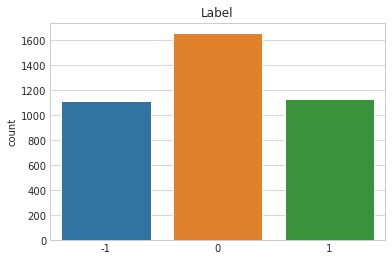

In [13]:
print(x.dtype, x.shape)
print(y.dtype, y.shape)
print()
display.display(label_df.info())
display.display(label_df)

plt.style.use('seaborn-whitegrid')
plt.figure()

plt.title('Label')
sns.countplot(np.concatenate([label_df.angle_class_r, label_df.angle_class_l]))

plt.show()
plt.style.use('seaborn-white')

In [14]:
cnt = np.concatenate([label_df.angle_class_r, label_df.angle_class_l])


print("calss -1:",len(cnt[cnt==-1]))
print("calss 0:",len(cnt[cnt==0]))
print("calss 1:",len(cnt[cnt==1]))

calss -1: 1113
calss 0: 1658
calss 1: 1131


## Model
---

In [72]:
def build_model():
    base_model = InceptionResNetV2(include_top=False, weights=None, input_shape=(None, None, 3))

    base_model.trainable= True
#     set_trainable = False
#     cnt=0
#     for layer in base_model.layers:
#         if layer.name == "block8_10_conv":
#             set_trainable = True
#         if set_trainable:
#             layer.trainable = True
#             cnt +=1
#         else:
#             layer.trainable = False

#     print(len(base_model.layers)-cnt,"||" ,cnt)

    x = base_model.output

    x = layers.GlobalAveragePooling2D(name='gap')(x)
    x = layers.Dense(256, activation='relu', name='dense')(x)
    x = layers.Dropout(0.2, name='dropout')(x)
#    
    regression_prediction=layers.Dense(1, name='regression_prediction')(x)
    one_hot_prediction=layers.Dense(3, activation='softmax', name='classification')(regression_prediction)
    distance_prediction=layers.Dense(1, name='distance_prediction')(x)

    
    model = models.Model(inputs=base_model.input, outputs=[regression_prediction,one_hot_prediction,distance_prediction])
#     model = models.Model(inputs=base_model.input, outputs=[regression_prediction,one_hot_prediction,distance_prediction])
    
    return model

In [73]:
model=build_model()

In [74]:
model.compile(optimizer=optimizers.RMSprop(1e-3),
              loss={'regression_prediction':"mae",'classification':"categorical_crossentropy",'distance_prediction':"mae"},
              loss_weights={'regression_prediction':1,'classification':1,'distance_prediction':0.5},
              metrics={'regression_prediction':"mae",'classification':"acc",'distance_prediction':"mae"})

In [76]:
model.save(os.path.join('/whbom/Malocclusion/model.hdf5'))

## Train the Model
---

In [15]:
print("distance loss weight:", loss_param)

distance loss weight: 0.5


In [17]:
def to299_resize(data_set):
    data=np.empty((data_set.shape[0],299,299,3))
    
    for i in range(data.shape[0]):
        data[i]=cv.resize(data_set[i], dsize=(299, 299), interpolation=cv.INTER_AREA)
#         print(i)
        
    return data

In [16]:
kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)
fine_tun = False

for kfold_idx, (train_idxs, test_idxs) in enumerate(kfold.split(x, y[:, 0])): #left???

    if kfold_idx >= 0:
        display.clear_output(wait=True)
        print(f'K-Fold CV: {kfold_idx + 1:02d}/{kfold.n_splits:02d}')

        # 1. Data
        # ----------------------------------------

        x_train = x[train_idxs]
        y_train = y[train_idxs]
        y_distance_train =y_distance[train_idxs]

        x_train, x_val, y_train, y_val, y_distance_train, y_distance_val = train_test_split(x_train, y_train, y_distance_train, test_size=0.2, 
                                                                                        random_state=42, stratify=y_train[:, 0])

        x_test = x[test_idxs]
        y_test = y[test_idxs]
        y_distance_test =y_distance[test_idxs]

        #distance 누락!
        x_train, y_train,y_train_onehot, y_train_distance = generate_data_by_patient(x_train, y_train, y_distance_train)
        x_val, y_val, y_val_onehot, y_val_distance = generate_data_by_patient(x_val, y_val, y_distance_val)
        x_test, y_test, y_test_onehot, y_test_distance = generate_data_by_patient(x_test, y_test, y_distance_test)
        
        x_train, y_train,y_train_onehot, y_train_distance = without_m1(x_train, y_train,y_train_onehot, y_train_distance)
        x_val, y_val, y_val_onehot, y_val_distance = without_m1(x_val, y_val, y_val_onehot, y_val_distance)
        x_test, y_test, y_test_onehot, y_test_distance = without_m1(x_test, y_test, y_test_onehot, y_test_distance)
#         x_train=to299_resize(x_train)
#         x_val=to299_resize(x_val)
#         x_test=to299_resize(x_test)

#         weight_for_m1 = (1 / len(y_train[y_train==-1]))*(len(y_train))/3.0 
        weight_for_0 = (1 / len(y_train[y_train==0]))*(len(y_train))/3.0 
        weight_for_1 = (1 / len(y_train[y_train==1]))*(len(y_train))/3.0

        class_weight={0:weight_for_0,1:weight_for_1}

        # 2. Paths
        # ----------------------------------------

        output_path_kfold = os.path.join(output_path, f'kfold_{kfold_idx + 1:02d}/')
        output_path_weight = os.path.join(output_path_kfold, r'weights/')

        if os.path.isdir(output_path_weight)==False:
            os.makedirs(output_path_weight)

        # 3. Build a Model.
        # ----------------------------------------

        learning_rate=1e-3
        initial_epochs=0
        total_epoch=50

        if fine_tun ==True:
            model = load_model("/sgcwhb/Malocclusion/results/prototype_multiout/5fold/v1_0.5_prototype_rg_multiO3_so_img/so_rl/model.hdf5")
            log_df = pd.read_csv(os.path.join("/sgcwhb/Malocclusion/results/prototype_multiout/5fold/v1_0.5_prototype_rg_multiO3_so_img/so_rl",f'kfold_{kfold_idx + 1:02d}/', r'log.csv'))

            initial_epochs=30
            total_epoch=total_epoch+initial_epochs
            
            model.load_weights(os.path.join("/sgcwhb/Malocclusion/results/prototype_multiout/5fold/v1_0.5_prototype_rg_multiO3_so_img/so_rl",f'kfold_{kfold_idx + 1:02d}/',"weights/",f"weights_{initial_epochs+1:08d}_{log_df.val_loss[initial_epochs]:.4g}.hdf5"))
            learning_rate=learning_rate/10

            #------------------FINE TUNING--------------------
            model.trainable= False
            set_trainable = False
            cnt=0

            for layer in model.layers[-24:]:
                layer.trainable = True
                cnt +=1
                if layer == "conv2d_200":
                    set_trainable = True
                if set_trainable:
                    print(layer.name)
                else:
                    layer.trainable = False

            print(cnt,"||", len(model.layers)-cnt)
            #--------------------------------------------------

        else:
            if kfold_idx==0:
                model = build_model()
                model.save(os.path.join(output_path, r'model.hdf5'))
                
            else:
                model = models.load_model(os.path.join(output_path, r'model.hdf5'))

        model.compile(optimizer=optimizers.RMSprop(learning_rate),
                      loss={'regression_prediction':"mae",'classification':"categorical_crossentropy",'distance_prediction':"mae"},
                      loss_weights={'regression_prediction':1,'classification':1,'distance_prediction':loss_param},
                      metrics={'regression_prediction':"mae",'classification':"acc",'distance_prediction':"mae"})

        print(len(model.trainable_weights),model.trainable_weights[0].shape)

        # 4. Train the Model.
        # ----------------------------------------

        # Callbacks
        checkpointer = callbacks.ModelCheckpoint(os.path.join(output_path_weight, 'weights_{epoch:08d}_{val_loss:.4g}.hdf5'),
                                                 save_weights_only=True)
        csv_logger = callbacks.CSVLogger(os.path.join(output_path_kfold, r'log.csv'), append=True)

        # Training batch size 16 -> 8
        model.fit(x_train,{'regression_prediction':y_train, 'classification':y_train_onehot,'distance_prediction':y_train_distance},
                  batch_size=16,
                  epochs=total_epoch,
                  validation_data=(x_val, {'regression_prediction':y_val,'classification':y_val_onehot,'distance_prediction':y_val_distance}),
                  callbacks=[checkpointer, csv_logger],
                  initial_epoch=initial_epochs,
                  verbose=1)

        K.clear_session()
        del model

K-Fold CV: 01/10
496 (3, 3, 3, 32)
Epoch 1/50


ValueError: in user code:

    /root/miniconda3/envs/tf2.3_python3.7/lib/python3.7/site-packages/tensorflow/python/keras/engine/training.py:571 train_function  *
        outputs = self.distribute_strategy.run(
    /root/miniconda3/envs/tf2.3_python3.7/lib/python3.7/site-packages/tensorflow/python/distribute/distribute_lib.py:951 run  **
        return self._extended.call_for_each_replica(fn, args=args, kwargs=kwargs)
    /root/miniconda3/envs/tf2.3_python3.7/lib/python3.7/site-packages/tensorflow/python/distribute/distribute_lib.py:2290 call_for_each_replica
        return self._call_for_each_replica(fn, args, kwargs)
    /root/miniconda3/envs/tf2.3_python3.7/lib/python3.7/site-packages/tensorflow/python/distribute/distribute_lib.py:2649 _call_for_each_replica
        return fn(*args, **kwargs)
    /root/miniconda3/envs/tf2.3_python3.7/lib/python3.7/site-packages/tensorflow/python/keras/engine/training.py:533 train_step  **
        y, y_pred, sample_weight, regularization_losses=self.losses)
    /root/miniconda3/envs/tf2.3_python3.7/lib/python3.7/site-packages/tensorflow/python/keras/engine/compile_utils.py:205 __call__
        loss_value = loss_obj(y_t, y_p, sample_weight=sw)
    /root/miniconda3/envs/tf2.3_python3.7/lib/python3.7/site-packages/tensorflow/python/keras/losses.py:143 __call__
        losses = self.call(y_true, y_pred)
    /root/miniconda3/envs/tf2.3_python3.7/lib/python3.7/site-packages/tensorflow/python/keras/losses.py:246 call
        return self.fn(y_true, y_pred, **self._fn_kwargs)
    /root/miniconda3/envs/tf2.3_python3.7/lib/python3.7/site-packages/tensorflow/python/keras/losses.py:1527 categorical_crossentropy
        return K.categorical_crossentropy(y_true, y_pred, from_logits=from_logits)
    /root/miniconda3/envs/tf2.3_python3.7/lib/python3.7/site-packages/tensorflow/python/keras/backend.py:4561 categorical_crossentropy
        target.shape.assert_is_compatible_with(output.shape)
    /root/miniconda3/envs/tf2.3_python3.7/lib/python3.7/site-packages/tensorflow/python/framework/tensor_shape.py:1117 assert_is_compatible_with
        raise ValueError("Shapes %s and %s are incompatible" % (self, other))

    ValueError: Shapes (None, 3) and (None, 2) are incompatible


## Evaluation
---

In [51]:
info_df = label_df.copy()
info_df

,Unnamed: 0,patient_id,tx_phase,angle_class_r,angle_class_l,distance(r),distance(l),one-hot-r,one-hot-l
0,0,QH0026,Pre-Tx,0,0,1.48,1.23,"[1.0, 0.0, 0.0]","[1.0, 0.0, 0.0]"
1,1,QH0026,Post-Tx,0,1,1.22,2.10,"[1.0, 0.0, 0.0]","[0.0, 1.0, 0.0]"
2,2,QH0041,Pre-Tx,1,0,2.57,0.88,"[0.0, 1.0, 0.0]","[1.0, 0.0, 0.0]"
3,3,QH0041,Post-Tx,1,0,3.58,1.05,"[0.0, 1.0, 0.0]","[1.0, 0.0, 0.0]"
4,4,QH0044,Pre-Tx,1,1,6.94,4.63,"[0.0, 1.0, 0.0]","[0.0, 1.0, 0.0]"
...,...,...,...,...,...,...,...,...,...
1946,2069,QH1058,Post-Tx,0,0,2.00,1.00,"[1.0, 0.0, 0.0]","[1.0, 0.0, 0.0]"
1947,2070,QH1072,Pre-Tx,-1,-1,-4.99,-2.83,"[0.0, 0.0, 1.0]","[0.0, 0.0, 1.0]"
1948,2071,QH1072,Post-Tx,1,1,7.41,5.26,"[0.0, 1.0, 0.0]","[0.0, 1.0, 0.0]"
1949,2072,QH1084,Pre-Tx,0,-1,-0.55,-0.55,"[1.0, 0.0, 0.0]","[0.0, 0.0, 1.0]"


In [52]:
info_df.iloc[[0,3,5,6,7]]

,Unnamed: 0,patient_id,tx_phase,angle_class_r,angle_class_l,distance(r),distance(l),one-hot-r,one-hot-l
0,0,QH0026,Pre-Tx,0,0,1.48,1.23,"[1.0, 0.0, 0.0]","[1.0, 0.0, 0.0]"
3,3,QH0041,Post-Tx,1,0,3.58,1.05,"[0.0, 1.0, 0.0]","[1.0, 0.0, 0.0]"
5,5,QH0044,Post-Tx,1,1,9.15,7.06,"[0.0, 1.0, 0.0]","[0.0, 1.0, 0.0]"
6,6,QH0059,Pre-Tx,0,0,1.13,0.81,"[1.0, 0.0, 0.0]","[1.0, 0.0, 0.0]"
7,7,QH0059,Post-Tx,1,-1,1.53,0.49,"[0.0, 1.0, 0.0]","[0.0, 0.0, 1.0]"


In [130]:
metrics = []
predictions_kfold = []
labels_kfold = []
distance_regression = [] 

total_info =[]
total_info_2 =[]

fold_testidx=[]
kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

for kfold_idx, (train_idxs, test_idxs) in enumerate(kfold.split(x, y[:, 0])):
    
    if kfold_idx >=0:
        print(kfold_idx)

        print(f'K-Fold CV: {kfold_idx + 1:02d}/{kfold.n_splits:02d}')

        print(test_idxs)
        fold_testidx.append(test_idxs)
        # 1. Data
        # ----------------------------------------
        x_test = x[test_idxs]
        y_test = y[test_idxs]
        y_test_distance= y_distance[test_idxs]

        label_df_test = label_df.iloc[test_idxs]

        x_test, y_test, y_test_onehot, y_test_distance = generate_data_by_patient(x_test, y_test,y_test_distance)

        x_test=to299_resize(x_test)

        # 2. Paths
        # ----------------------------------------

    #     output_path_kfold = os.path.join(output_path, model_parm_name, f'kfold_{kfold_idx + 1:02d}/')
        output_path_kfold = os.path.join(output_path,  f'kfold_{kfold_idx + 1:02d}/')
        output_path_weight = os.path.join(output_path_kfold, r'weights/')

        # 3. Plot Learning Curves.
        # ----------------------------------------

        # log 저장: loss, mae, val_loss, val_mae
        log_df = pd.read_csv(os.path.join(output_path_kfold, r'log.csv'))


        plt.style.use('seaborn-whitegrid')
        plt.figure(figsize=(16, 6))

        plt.subplot(2,2,1)
        plt.title(f'Learning Curves ({kfold_idx + 1:02d}/{kfold.n_splits:02d})')
        plt.plot(log_df.loss)
        plt.plot(log_df.val_loss)
        plt.legend(('Train Loss', 'Validation Loss'))
        plt.ylim(0,5)

        plt.subplot(2,2,2)
        plt.plot(log_df.classification_acc)
        plt.plot(log_df.val_classification_acc)
        plt.ylim(0, 1)
        plt.legend(('Train Classification ACC', 'Validation Classification ACC'))

        plt.subplot(2,2,3)
        plt.plot(log_df.distance_prediction_mae)
        plt.plot(log_df.val_distance_prediction_mae)
        plt.ylim(0,5)
        plt.legend(('Train distance regression MAE', 'Validation distance regression MAE'))

        plt.subplot(2,2,4)
        plt.plot(log_df.regression_prediction_mae)
        plt.plot(log_df.val_regression_prediction_mae)
        plt.legend(('Train regression MAE', 'Validation regression MAE'))
        plt.ylim(0,5)

        plt.show()
        plt.style.use('seaborn-white')
        print(f'Min. validation loss epoch: {log_df.val_loss.idxmin() + 1}')
        print(f'Max. Classification ACC epoch: {log_df.val_classification_acc.idxmax() + 1}')
        print(f'Max. Classification ACC: {log_df.val_classification_acc[log_df.val_classification_acc.idxmax()]}')
        print(f'Min. distance regression validation MAE epoch: {log_df.val_distance_prediction_mae.idxmin() + 1}')
        print(f'Min. regression validation MAE epoch: {log_df.val_regression_prediction_mae.idxmin() + 1}')



        info_df = label_df.copy()

        result_info_df = info_df.iloc[test_idxs]

        inference_df = result_info_df.copy()
        inference_df2 = result_info_df.copy()

        # 4. Load a Model.
        # ----------------------------------------

    #         K.clear_session()

        #sgcwhb/Malocclusion/results/prototype_regression_so_img/so_rl/model.hdf5
        model = models.load_model(os.path.join(output_path, r'model.hdf5'))
        model2 = models.load_model(os.path.join(output_path, r'model.hdf5'))
        #validation mae가 가장 적은 model weight load
        model.load_weights(glob.glob(os.path.join(output_path_weight, f'weights_{log_df.val_regression_prediction_mae.idxmin() + 1:08d}*.hdf5'))[0])
        model2.load_weights(glob.glob(os.path.join(output_path_weight, f'weights_{log_df.val_classification_acc.idxmax() + 1:08d}*.hdf5'))[0])
        # 5. Display
        # ----------------------------------------


        prediction = model.predict(x_test)
        prediction2 = model2.predict(x_test)

        prediction_distance_r = prediction[0][:int(prediction[0].shape[0]/2),0] #Right
        prediction_distance_l = prediction[0][int(prediction[0].shape[0]/2):,0] #left

        prediction_class_r = prediction2[1][:int(prediction[1].shape[0]/2)] #Right
        prediction_class_l = prediction2[1][int(prediction[1].shape[0]/2):] #left

        r = prediction_distance_r.copy()
        l = prediction_distance_l.copy()

        r2 = prediction_class_r.copy()
        l2 = prediction_class_l.copy()

        #-1~1사이 score
        r = np.round(r) #반올림
        r[r<-1]= -1
        r[r>1] = 1


        l = np.round(l)
        l[l<-1]= -1
        l[l>1] = 1  

        # onehot value score
        r2= r2.tolist()
        r2_2=[]
        for xx in r2:
            if xx[0]==np.max(xx):
                xx=0
            elif xx[1]==np.max(xx):
                xx=1
            elif xx[2]==np.max(xx):
                xx=-1
            r2_2.append(xx)

        l2= l2.tolist()
        l2_2=[]
        for xy in l2:
            if xy[0]==np.max(xy):
                xy=0
            elif xy[1]==np.max(xy):
                xy=1
            elif xy[2]==np.max(xy):
                xy=-1
            l2_2.append(xy)
    #     print(l.shape)
    #     print(r.shape)
    #     print(info_df.shape)
    #     print(result_info_df.shape)

        inference_df['prediction_class_r'] = r
        inference_df['prediction_class_l'] =l
        inference_df['regression_distance_r'] = np.round(prediction_distance_r,3)
        inference_df['regression_distance_l'] = np.round(prediction_distance_l,3)

        inference_df2['prediction_class_r']=r2_2
        inference_df2['prediction_class_l']=l2_2
        inference_df2['prediction_onehot_class_r']=r2
        inference_df2['prediction_onehot_class_l']=l2


        inference_df.to_csv(os.path.join(output_path_kfold, r'info_v1_2.csv')) # log_df.val_regression_prediction_mae.idxmin()
        inference_df2.to_csv(os.path.join(output_path_kfold, r'info_v2_2.csv')) # log_df.val_classification_acc.idxmax()

        total_info.append(inference_df)
        total_info_2.append(inference_df2)

    total_df = pd.concat(total_info)
    total_df.to_csv(os.path.join(output_path,'total_v1_2.csv'))

    total_df2 = pd.concat(total_info_2)
    total_df2.to_csv(os.path.join(output_path,'total_v2_2.csv'))

0
K-Fold CV: 01/10
[  13   15   25   36   62   67   68   81   87  101  124  130  154  156
  158  160  161  164  171  177  193  195  206  215  216  219  231  234
  252  263  264  287  309  310  311  320  329  359  363  366  375  376
  393  403  417  427  434  440  455  462  484  493  496  500  502  509
  514  517  537  542  545  563  569  576  579  584  586  599  612  614
  622  623  664  675  687  706  708  709  713  725  733  737  749  750
  770  784  787  794  819  822  824  832  836  842  855  864  866  880
  913  934  946  954  979  982  995 1008 1014 1040 1043 1044 1046 1057
 1060 1065 1086 1088 1090 1098 1104 1113 1117 1119 1124 1186 1209 1225
 1233 1236 1241 1251 1253 1254 1263 1320 1322 1338 1342 1347 1365 1374
 1380 1385 1404 1419 1478 1489 1506 1532 1543 1568 1571 1580 1591 1604
 1616 1650 1654 1656 1660 1665 1667 1670 1672 1705 1718 1719 1742 1743
 1744 1745 1750 1762 1773 1779 1785 1787 1789 1812 1815 1818 1822 1825
 1831 1835 1844 1847 1853 1857 1864 1877 1890 1898 1901 19

NameError: name 'to299_resize' is not defined

In [28]:
inference_df

,Unnamed: 0,patient_id,tx_phase,angle_class_r,angle_class_l,distance(r),distance(l),one-hot-r,one-hot-l,prediction_class_r,prediction_class_l,regression_distance_r,regression_distance_l
13,13,QH0083,Post-Tx,-1,-1,-5.30,-5.43,"[0.0, 0.0, 1.0]","[0.0, 0.0, 1.0]",-1.0,-1.0,-0.935,-0.866
15,15,QH0093,Post-Tx,0,0,0.60,1.62,"[1.0, 0.0, 0.0]","[1.0, 0.0, 0.0]",-0.0,1.0,-0.001,0.927
25,25,QH0115,Post-Tx,0,1,0.51,1.87,"[1.0, 0.0, 0.0]","[0.0, 1.0, 0.0]",-0.0,-0.0,-0.001,-0.001
36,37,QH0158,Post-Tx,0,-1,4.39,2.69,"[1.0, 0.0, 0.0]","[0.0, 0.0, 1.0]",-0.0,-0.0,-0.001,-0.001
62,63,QH0349,Post-Tx,-1,-1,-1.21,-1.06,"[0.0, 0.0, 1.0]","[0.0, 0.0, 1.0]",-1.0,-1.0,-1.105,-1.105
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1898,2017,QH0523,Post-Tx,0,0,-1.16,-0.68,"[1.0, 0.0, 0.0]","[1.0, 0.0, 0.0]",-1.0,-0.0,-1.137,-0.411
1901,2022,QH0541,Pre-Tx,-1,-1,-1.88,-1.79,"[0.0, 0.0, 1.0]","[0.0, 0.0, 1.0]",-1.0,-1.0,-1.083,-0.936
1917,2038,QH0777,Pre-Tx,1,0,4.79,1.53,"[0.0, 1.0, 0.0]","[1.0, 0.0, 0.0]",1.0,1.0,0.922,0.851
1941,2064,QH1037,Pre-Tx,0,0,0.95,-0.46,"[1.0, 0.0, 0.0]","[1.0, 0.0, 0.0]",-0.0,-0.0,-0.381,-0.001


In [131]:
output_path

'/whbom/Malocclusion/202107_result/prototype_multiout/0.5_frS/full_range_1951/1/so_rl'

In [37]:
total_df=pd.read_csv(os.path.join(output_path,'total_v1_2.csv'))
total_df2=pd.read_csv(os.path.join(output_path,'total_v2_2.csv'))

In [38]:
data = total_df['angle_class_r'].append(total_df['angle_class_l'])
prediction =  total_df['prediction_class_r'].append(total_df['prediction_class_l'])
data = np.array(data)
prediction=np.array(prediction,dtype = int)

cm = confusion_matrix(data, prediction, labels=[-1, 0, 1])

print(cm)
print("")
print(f'Accuracy: {(cm[0, 0] + cm[1, 1] + cm[2, 2]) / cm.sum():.3f}')

[[ 783  311   19]
 [ 122 1391  145]
 [  16  198  917]]

Accuracy: 0.792


In [39]:
data = total_df2['angle_class_r'].append(total_df2['angle_class_l'])
prediction =  total_df2['prediction_class_r'].append(total_df2['prediction_class_l'])
data = np.array(data)
prediction=np.array(prediction,dtype = int)

cm = confusion_matrix(data, prediction, labels=[-1, 0, 1])

print(cm)
print("")
print(f'Accuracy: {(cm[0, 0] + cm[1, 1] + cm[2, 2]) / cm.sum():.3f}')

[[ 826  268   19]
 [ 123 1390  145]
 [  19  202  910]]

Accuracy: 0.801


In [66]:
total_df=pd.read_csv("/whbom/Malocclusion/bom_regression/prototype_frs/total_v1_2.csv")

In [67]:
test_df=total_df.loc[list(test_idxs)]

In [68]:
data = test_df['angle_class_r'].append(test_df['angle_class_l'])
prediction =  test_df['prediction_class_r'].append(test_df['prediction_class_l'])
data = np.array(data)
prediction=np.array(prediction,dtype = int)

cm = confusion_matrix(data, prediction, labels=[-1, 0, 1])

print(cm)
print("")
print(f'Accuracy: {(cm[0, 0] + cm[1, 1] + cm[2, 2]) / cm.sum():.3f}')

[[ 89  17   1]
 [  9 147  16]
 [  2  18  91]]

Accuracy: 0.838


In [71]:
np.unique(data, return_counts=True)

(array([-1,  0,  1]), array([107, 172, 111]))

# grad_CAM

In [31]:
model.load_weights("/whbom/Malocclusion/bom_regression/prototype_frs/kfold_01/weights_00000044_0.9204.hdf5")

In [24]:
kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

# model_parm_name="D"+depth+"_"+dropout_rat

for kfold_idx, (train_idxs, test_idxs) in enumerate(kfold.split(x, y[:, 0])):
    
    if kfold_idx ==0:
        # 1. Data
        # ----------------------------------------
        x_test = x[test_idxs]
        y_test = y[test_idxs]
        y_test_distance= y_distance[test_idxs]

        label_df_test = label_df.iloc[test_idxs]

        x_test, y_test, y_test_onehot, y_test_distance = generate_data_by_patient(x_test, y_test,y_test_distance)

In [58]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = tf.keras.models.Model(
        model.inputs, [model.get_layer(last_conv_layer_name).output, model.outputs]
    )

    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
                
        if pred_index is None:
            pred_index = int(np.array(tf.argmax(preds[1][0])))
        class_channel = preds[1][:, pred_index]

    grads = tape.gradient(class_channel, last_conv_layer_output)
    
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    
#     plt.imshow(np.array(heatmap),cmap="gray")
#     plt.show()
    
    heatmap = tf.abs(heatmap)  
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
#     plt.imshow(np.array(heatmap),cmap="gray")
#     plt.show()
    
    return preds, heatmap

In [59]:
def overlay(heatmap, img):
    # We use jet colormap to colorize heatmap
    jet = cm.get_cmap("jet")
    
    heatmap= np.uint8(255 * np.array(heatmap))

    # We use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # We create an image with RGB colorized heatmap
    jet_heatmap = keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.preprocessing.image.img_to_array(jet_heatmap)
#     print(jet_heatmap.min(), jet_heatmap.max())

    # Superimpose the heatmap on original image
    jet_heatmap = jet_heatmap / jet_heatmap.max()
    superimposed_img = jet_heatmap + img
    superimposed_img = keras.preprocessing.image.array_to_img(superimposed_img)
        
    return jet_heatmap, superimposed_img

  0%|          | 0/10 [00:00<?, ?it/s]

0 _label =  -1.0    predict =  -1 , pred =  [0.0633 0.     0.9367]


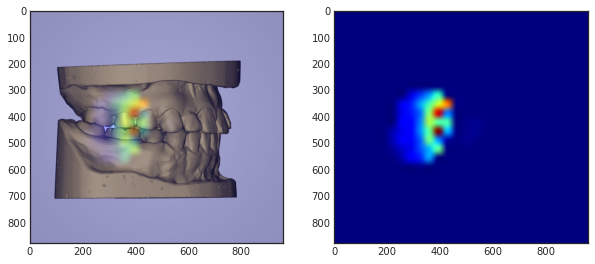

 10%|█         | 1/10 [00:01<00:11,  1.30s/it]

1 _label =  0.0    predict =  0 , pred =  [0.8757 0.0709 0.0534]


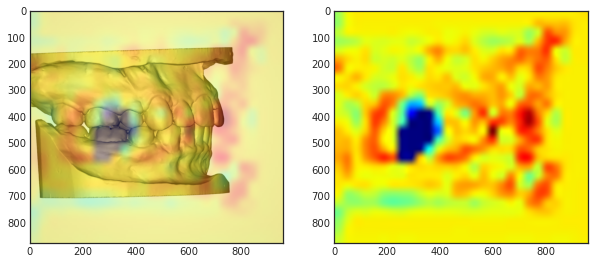

 20%|██        | 2/10 [00:02<00:10,  1.27s/it]

2 _label =  0.0    predict =  0 , pred =  [0.8767 0.0668 0.0566]


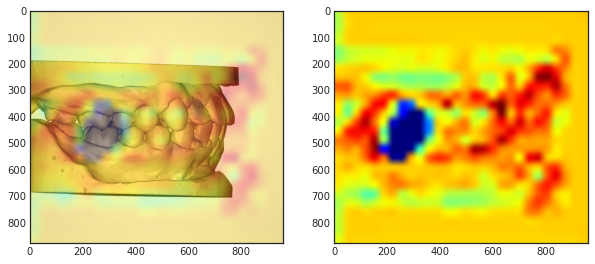

 30%|███       | 3/10 [00:03<00:08,  1.17s/it]

3 _label =  0.0    predict =  0 , pred =  [0.8775 0.0586 0.0639]


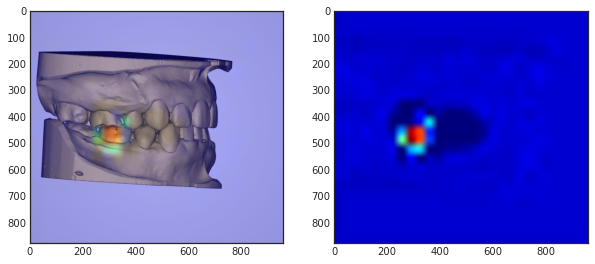

 40%|████      | 4/10 [00:04<00:06,  1.11s/it]

4 _label =  -1.0    predict =  -1 , pred =  [0.0746 0.     0.9254]


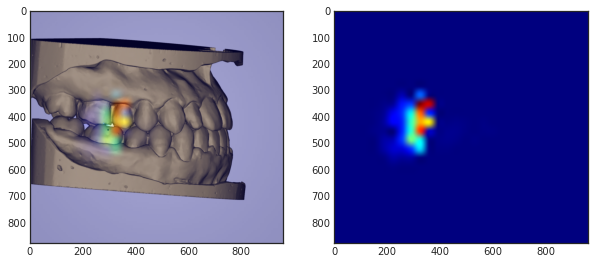

 50%|█████     | 5/10 [00:05<00:05,  1.08s/it]

5 _label =  -1.0    predict =  -1 , pred =  [0.0779 0.     0.9221]


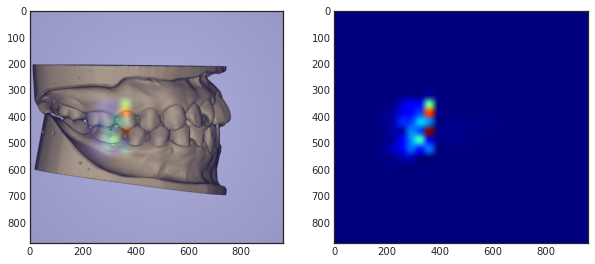

 60%|██████    | 6/10 [00:07<00:04,  1.22s/it]

6 _label =  0.0    predict =  0 , pred =  [0.8723 0.0804 0.0473]


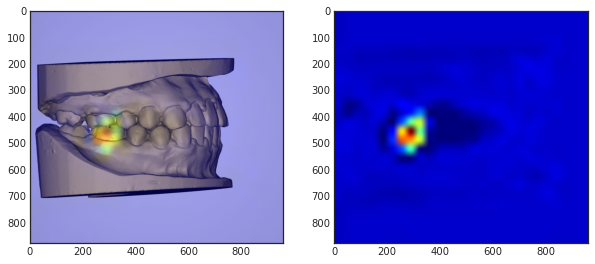

 70%|███████   | 7/10 [00:08<00:03,  1.17s/it]

7 _label =  1.0    predict =  1 , pred =  [0.0405 0.9595 0.    ]


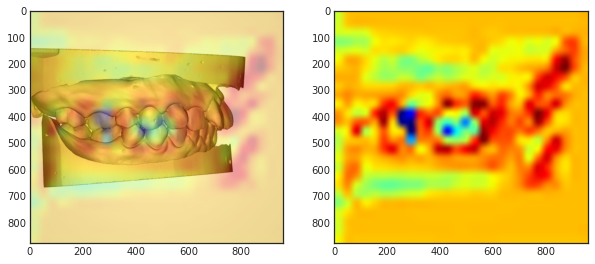

 80%|████████  | 8/10 [00:09<00:02,  1.15s/it]

8 _label =  -1.0    predict =  -1 , pred =  [0.0604 0.     0.9396]


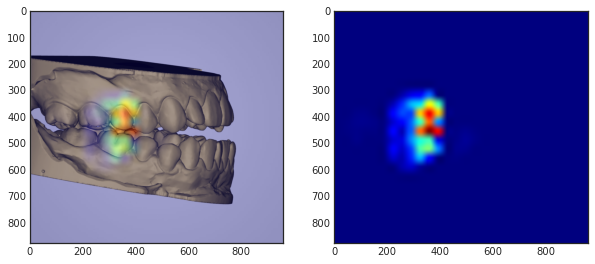

 90%|█████████ | 9/10 [00:10<00:01,  1.12s/it]

9 _label =  0.0    predict =  0 , pred =  [0.8736 0.0772 0.0492]


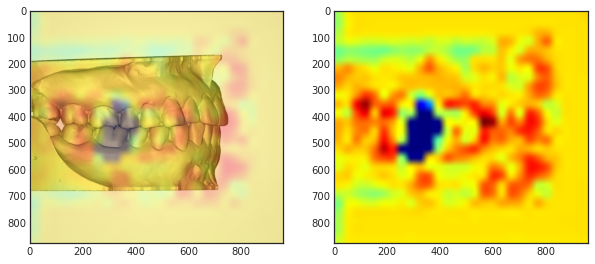

100%|██████████| 10/10 [00:11<00:00,  1.16s/it]


In [56]:
import matplotlib.cm as cm

# idx = widgets.IntSlider(min=0, max=len(x_test), step=1)

model_list = []
for i in model.layers:
    model_list.append(i.name)
    
last_conv_layer_name = "conv_7b_ac"
last_c_idx = model_list.index(last_conv_layer_name)
classifier_layer_names = model_list[last_c_idx+1:]

# disable classification softmax
model.layers[-2].activation = None
count=0

for idx in tqdm(range(10)):
    #input
    gen_img= x_test[idx:idx+1]
    gen_label= y_test[idx:idx+1]
    
    preds, heatmap = make_gradcam_heatmap(gen_img, model, last_conv_layer_name, pred_index = None)


    pred_idx = np.argmax(np.array(preds[1][0]))
    if pred_idx==2:
        pred_idx = int(-1)
    
    count +=1
    img= cv.cvtColor(gen_img[0], cv.COLOR_BGR2RGB)
    jet_heatmap, superimposed_img = overlay(heatmap, img)

    plt.figure(figsize=(10,5))
    plt.subplot(1,2,1)
    plt.imshow(superimposed_img)
    plt.subplot(1,2,2)
    plt.imshow(jet_heatmap)

    print(idx,'_label = ', y_test[idx], '   predict = ', pred_idx , ", pred = ", np.round(tf.nn.softmax(np.array(preds[1][0])), decimals=4))
    plt.show()

  0%|          | 0/392 [00:00<?, ?it/s]

0 _label =  -1.0    predict =  -1 , pred =  [0.0633 0.     0.9367]


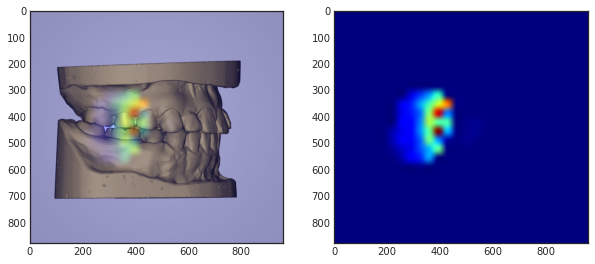

  0%|          | 1/392 [00:01<08:13,  1.26s/it]

1 _label =  0.0    predict =  0 , pred =  [0.8757 0.0709 0.0534]


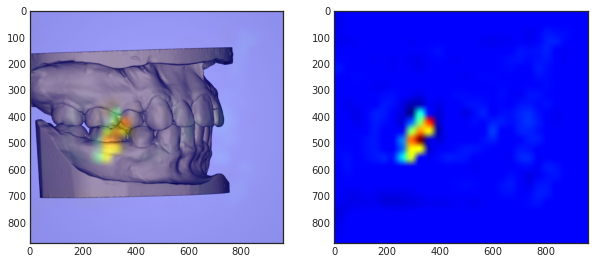

  1%|          | 2/392 [00:02<07:24,  1.14s/it]

2 _label =  0.0    predict =  0 , pred =  [0.8767 0.0668 0.0566]


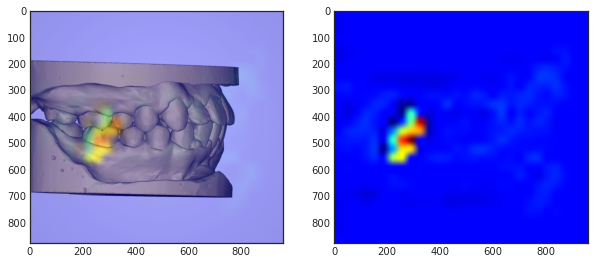

  1%|          | 3/392 [00:03<07:12,  1.11s/it]

3 _label =  0.0    predict =  0 , pred =  [0.8775 0.0586 0.0639]


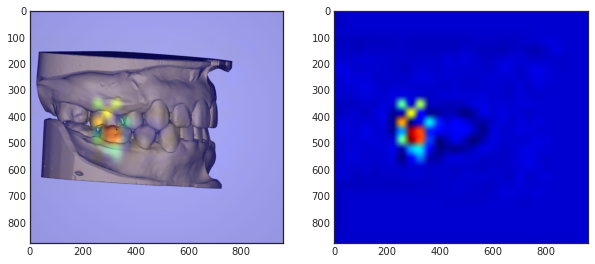

  1%|          | 4/392 [00:04<07:02,  1.09s/it]

4 _label =  -1.0    predict =  -1 , pred =  [0.0746 0.     0.9254]


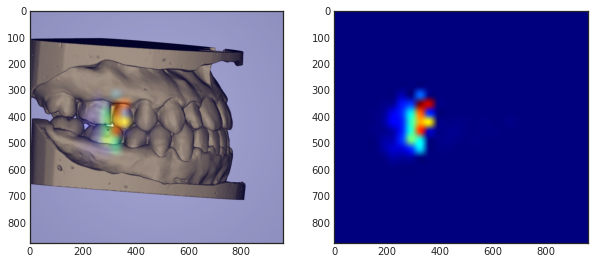

  1%|▏         | 5/392 [00:05<06:54,  1.07s/it]

5 _label =  -1.0    predict =  -1 , pred =  [0.0779 0.     0.9221]


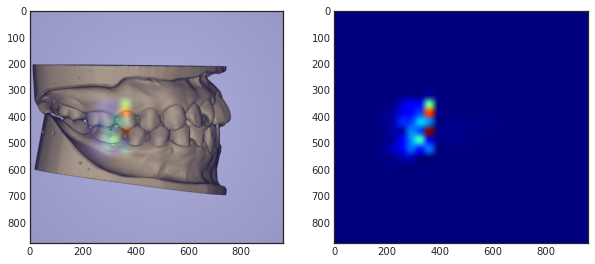

  2%|▏         | 6/392 [00:06<06:57,  1.08s/it]

6 _label =  0.0    predict =  0 , pred =  [0.8723 0.0804 0.0473]


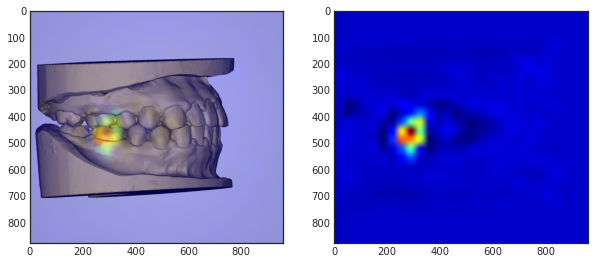

  2%|▏         | 7/392 [00:07<06:51,  1.07s/it]

7 _label =  1.0    predict =  1 , pred =  [0.0405 0.9595 0.    ]


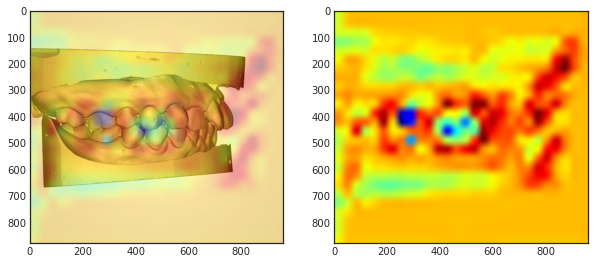

  2%|▏         | 8/392 [00:08<06:47,  1.06s/it]

8 _label =  -1.0    predict =  -1 , pred =  [0.0604 0.     0.9396]


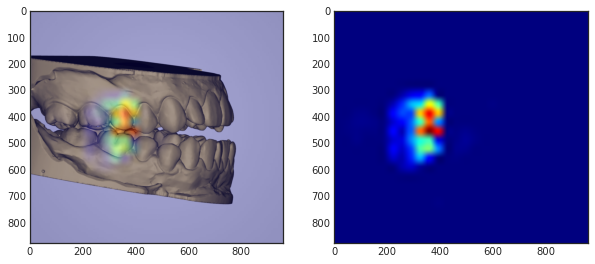

  2%|▏         | 9/392 [00:09<06:47,  1.07s/it]

9 _label =  0.0    predict =  0 , pred =  [0.8736 0.0772 0.0492]


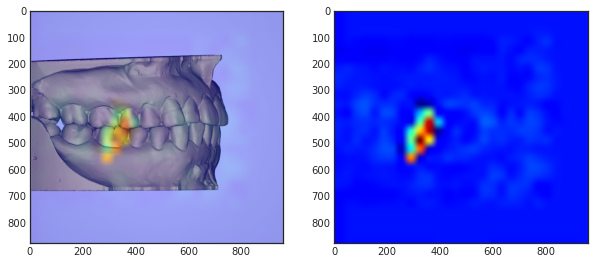

  3%|▎         | 10/392 [00:10<06:45,  1.06s/it]

10 _label =  1.0    predict =  1 , pred =  [0.3221 0.6769 0.001 ]


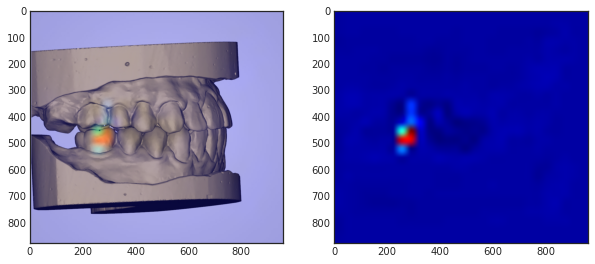

  3%|▎         | 11/392 [00:11<06:44,  1.06s/it]

11 _label =  0.0    predict =  0 , pred =  [0.8718 0.0817 0.0465]


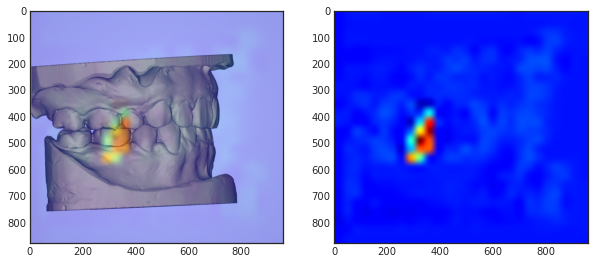

  3%|▎         | 12/392 [00:12<06:43,  1.06s/it]

12 _label =  1.0    predict =  1 , pred =  [0.0617 0.9383 0.    ]


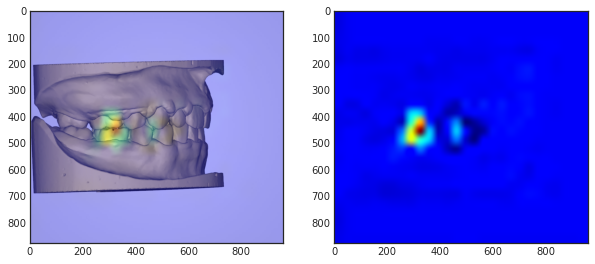

  3%|▎         | 13/392 [00:15<08:57,  1.42s/it]

13 _label =  -1.0    predict =  -1 , pred =  [0.0892 0.     0.9107]


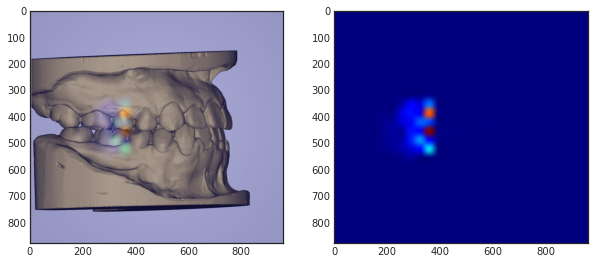

  4%|▎         | 14/392 [00:16<08:27,  1.34s/it]

14 _label =  1.0    predict =  1 , pred =  [0.0387 0.9613 0.    ]


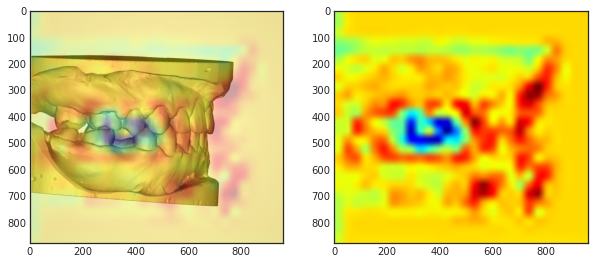

  4%|▍         | 15/392 [00:17<08:07,  1.29s/it]

15 _label =  -1.0    predict =  -1 , pred =  [0.0899 0.     0.9101]


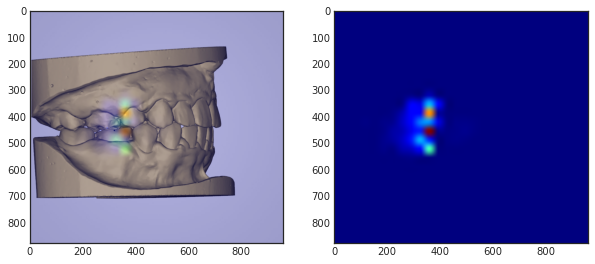

  4%|▍         | 16/392 [00:18<07:46,  1.24s/it]

16 _label =  -1.0    predict =  -1 , pred =  [0.0637 0.     0.9363]


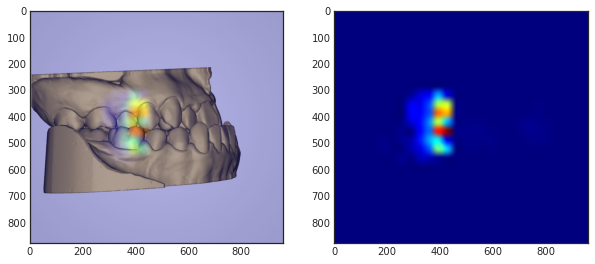

  4%|▍         | 17/392 [00:19<07:20,  1.18s/it]

17 _label =  0.0    predict =  0 , pred =  [0.8696 0.0864 0.044 ]


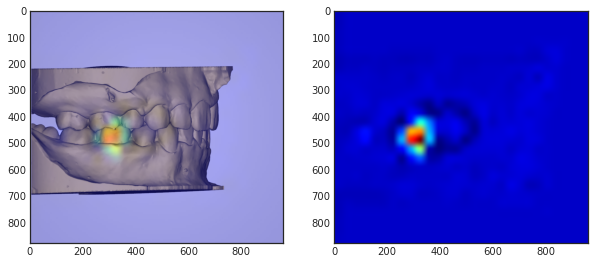

  5%|▍         | 18/392 [00:20<07:08,  1.15s/it]

18 _label =  1.0    predict =  1 , pred =  [0.0113 0.9887 0.    ]


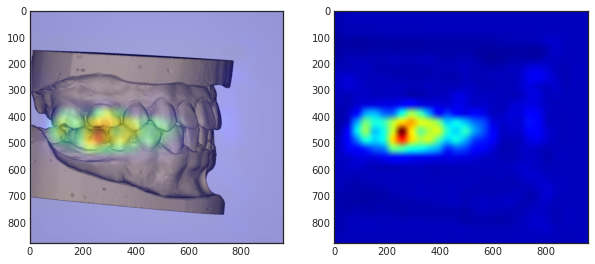

  5%|▍         | 19/392 [00:21<07:13,  1.16s/it]

19 _label =  0.0    predict =  0 , pred =  [0.8741 0.0758 0.0501]


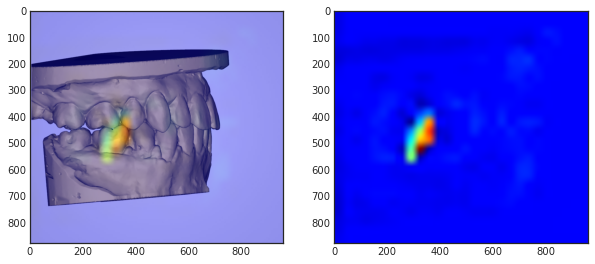

  5%|▌         | 20/392 [00:23<07:03,  1.14s/it]

20 _label =  -1.0    predict =  -1 , pred =  [0.0971 0.     0.9029]


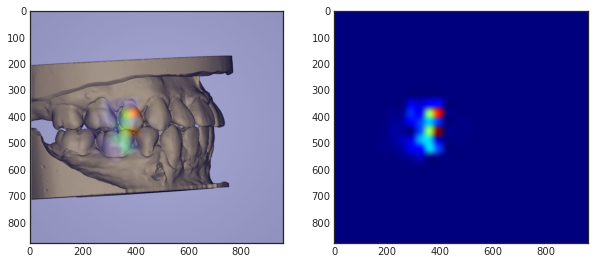

  5%|▌         | 21/392 [00:24<07:03,  1.14s/it]

21 _label =  1.0    predict =  0 , pred =  [0.8737 0.077  0.0493]


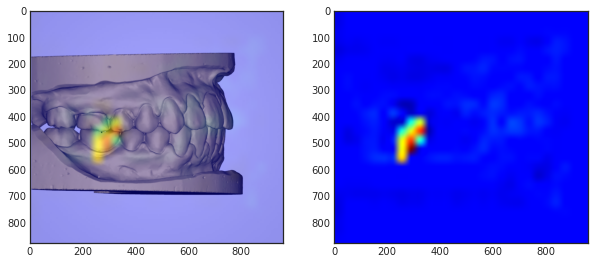

  6%|▌         | 22/392 [00:25<07:12,  1.17s/it]

22 _label =  0.0    predict =  0 , pred =  [0.8726 0.0798 0.0476]


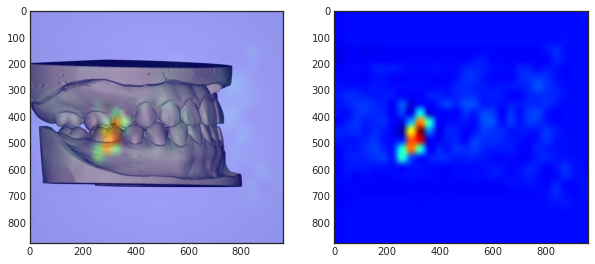

  6%|▌         | 23/392 [00:26<07:15,  1.18s/it]

23 _label =  0.0    predict =  0 , pred =  [0.8737 0.077  0.0493]


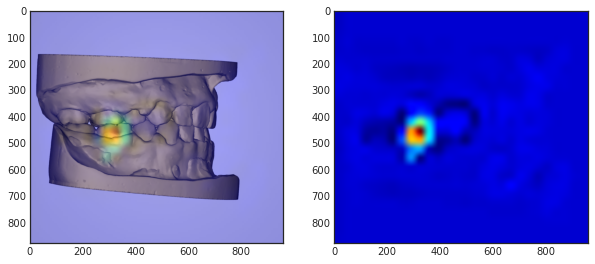

  6%|▌         | 24/392 [00:27<07:00,  1.14s/it]

24 _label =  0.0    predict =  0 , pred =  [0.8734 0.0779 0.0488]


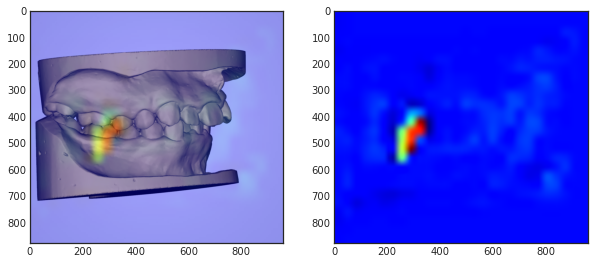

  6%|▋         | 25/392 [00:28<07:05,  1.16s/it]

25 _label =  -1.0    predict =  -1 , pred =  [0.091 0.    0.909]


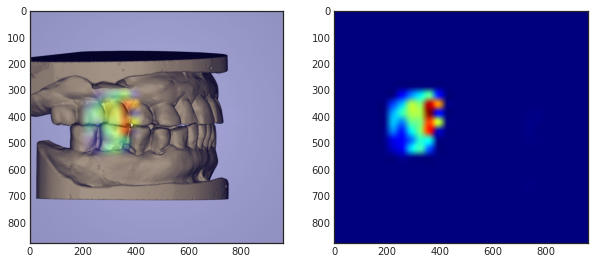

  7%|▋         | 26/392 [00:29<06:52,  1.13s/it]

26 _label =  0.0    predict =  0 , pred =  [0.8682 0.0893 0.0425]


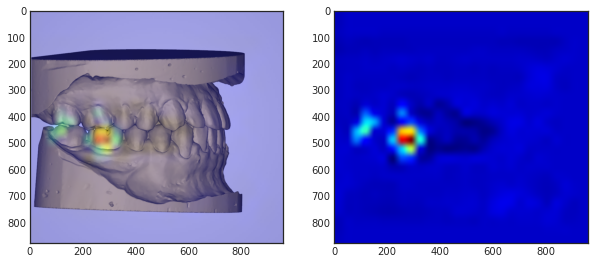

  7%|▋         | 27/392 [00:30<06:40,  1.10s/it]

27 _label =  0.0    predict =  -1 , pred =  [0.1003 0.     0.8997]


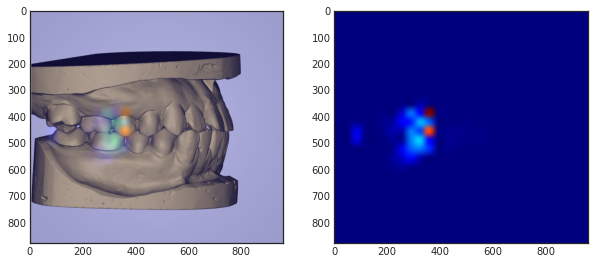

  7%|▋         | 28/392 [00:31<06:31,  1.07s/it]

28 _label =  1.0    predict =  1 , pred =  [0.0392 0.9608 0.    ]


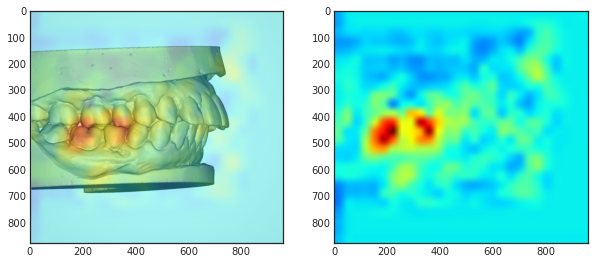

  7%|▋         | 29/392 [00:33<06:28,  1.07s/it]

29 _label =  0.0    predict =  0 , pred =  [0.875  0.0733 0.0517]


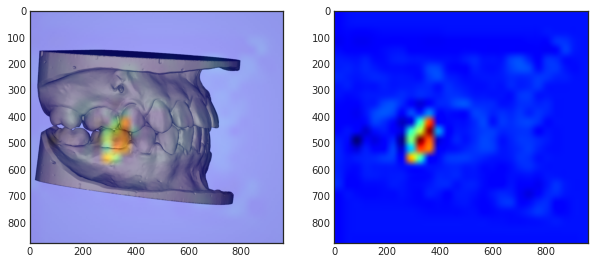

  8%|▊         | 30/392 [00:34<06:28,  1.07s/it]

30 _label =  0.0    predict =  0 , pred =  [0.8673 0.0911 0.0417]


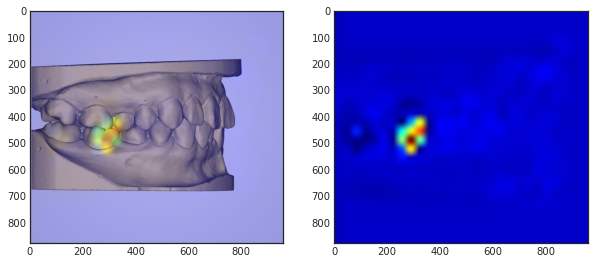

  8%|▊         | 31/392 [00:35<06:23,  1.06s/it]

31 _label =  0.0    predict =  0 , pred =  [0.872  0.0811 0.0469]


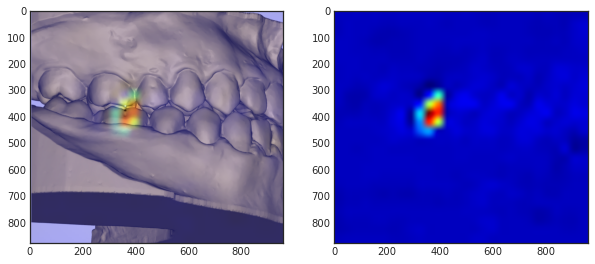

  8%|▊         | 32/392 [00:36<06:23,  1.06s/it]

32 _label =  0.0    predict =  0 , pred =  [0.8744 0.075  0.0506]


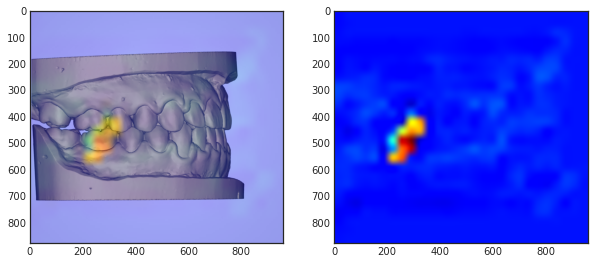

  8%|▊         | 33/392 [00:37<06:22,  1.06s/it]

33 _label =  1.0    predict =  1 , pred =  [0.0414 0.9586 0.    ]


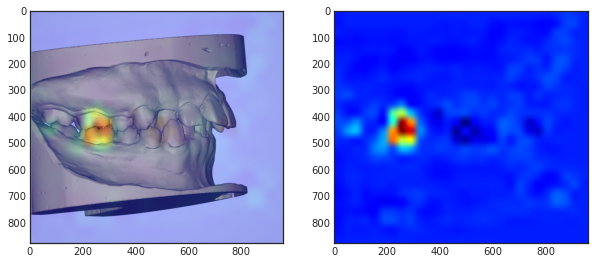

  9%|▊         | 34/392 [00:38<06:21,  1.07s/it]

34 _label =  0.0    predict =  0 , pred =  [0.8735 0.0774 0.049 ]


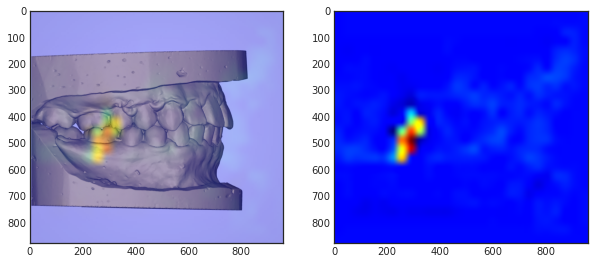

  9%|▉         | 35/392 [00:40<07:26,  1.25s/it]

35 _label =  0.0    predict =  0 , pred =  [0.8728 0.0792 0.048 ]


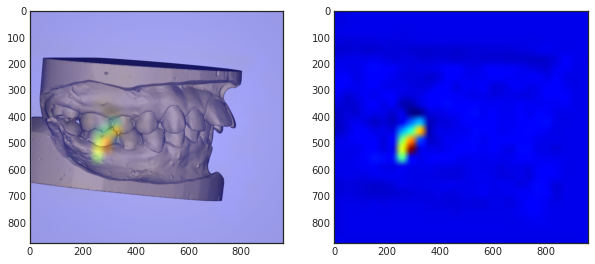

  9%|▉         | 36/392 [00:41<07:03,  1.19s/it]

36 _label =  0.0    predict =  0 , pred =  [0.8714 0.0826 0.046 ]


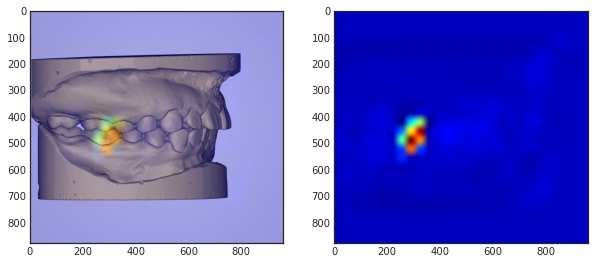

  9%|▉         | 37/392 [00:42<06:44,  1.14s/it]

37 _label =  0.0    predict =  0 , pred =  [0.875  0.0466 0.0783]


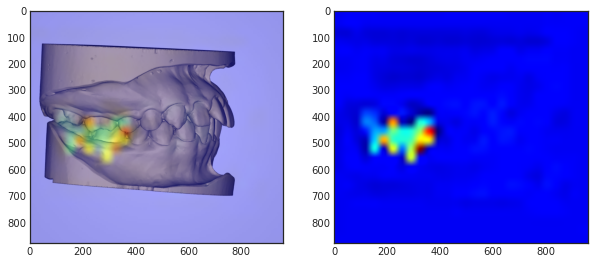

 10%|▉         | 38/392 [00:43<06:34,  1.11s/it]

38 _label =  -1.0    predict =  -1 , pred =  [0.115  0.     0.8849]


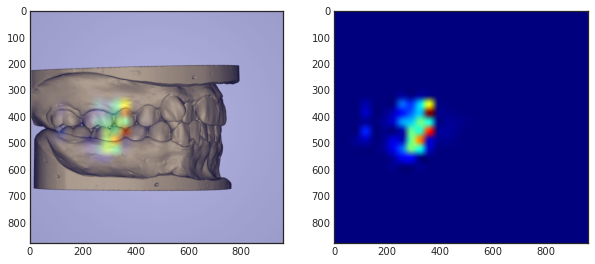

 10%|▉         | 39/392 [00:44<06:28,  1.10s/it]

39 _label =  -1.0    predict =  -1 , pred =  [0.0917 0.     0.9083]


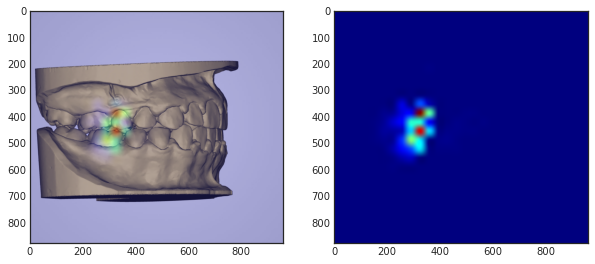

 10%|█         | 40/392 [00:45<06:20,  1.08s/it]

40 _label =  1.0    predict =  1 , pred =  [0.0353 0.9646 0.    ]


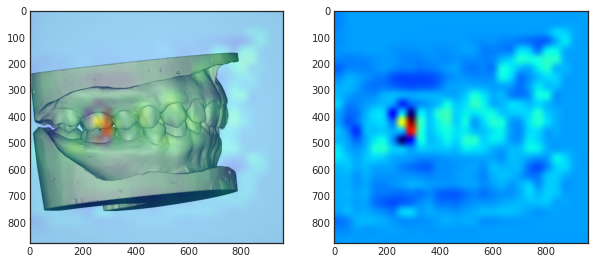

 10%|█         | 41/392 [00:46<06:14,  1.07s/it]

41 _label =  0.0    predict =  0 , pred =  [0.8748 0.0737 0.0515]


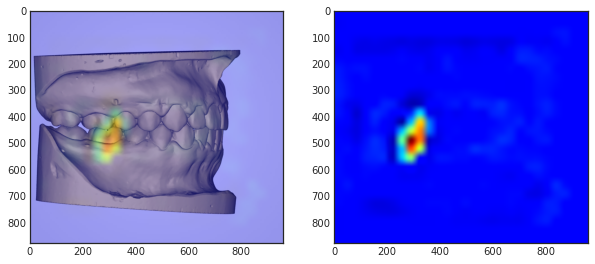

 11%|█         | 42/392 [00:47<06:13,  1.07s/it]

42 _label =  1.0    predict =  0 , pred =  [0.857  0.1082 0.0348]


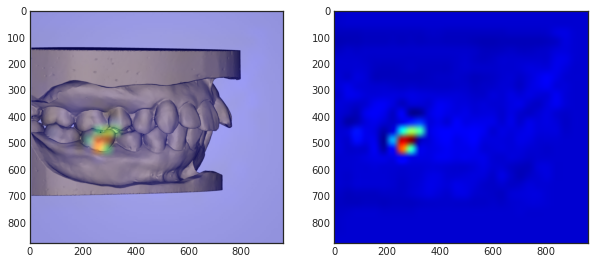

 11%|█         | 43/392 [00:48<06:18,  1.08s/it]

43 _label =  0.0    predict =  0 , pred =  [0.8703 0.0851 0.0447]


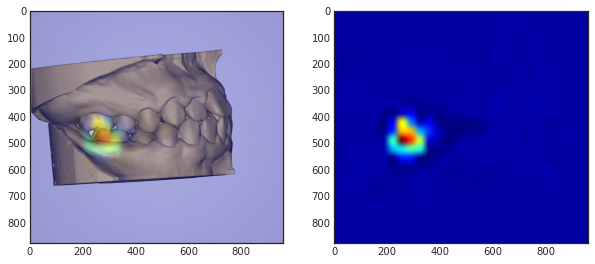

 11%|█         | 44/392 [00:49<06:13,  1.07s/it]

44 _label =  -1.0    predict =  -1 , pred =  [0.0451 0.     0.9549]


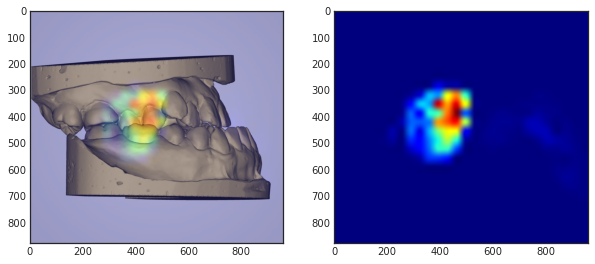

 11%|█▏        | 45/392 [00:50<06:10,  1.07s/it]

45 _label =  1.0    predict =  0 , pred =  [0.81   0.1693 0.0207]


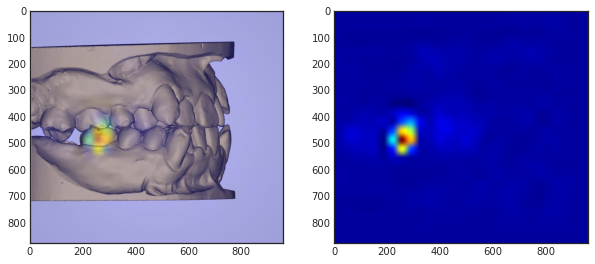

 12%|█▏        | 46/392 [00:51<06:07,  1.06s/it]

46 _label =  0.0    predict =  0 , pred =  [0.8736 0.0773 0.0491]


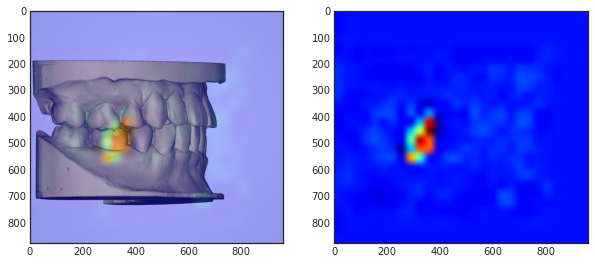

 12%|█▏        | 47/392 [00:52<06:05,  1.06s/it]

47 _label =  -1.0    predict =  -1 , pred =  [0.0921 0.     0.9079]


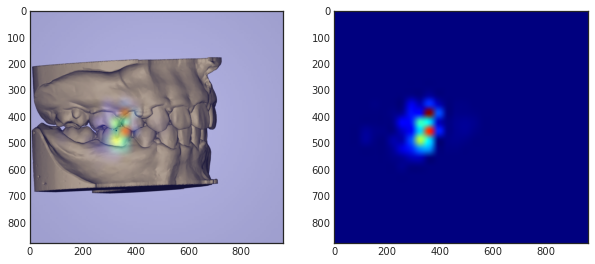

 12%|█▏        | 48/392 [00:53<06:03,  1.06s/it]

48 _label =  1.0    predict =  1 , pred =  [0.0293 0.9707 0.    ]


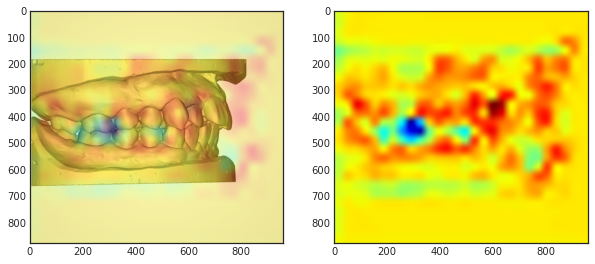

 12%|█▎        | 49/392 [00:54<06:17,  1.10s/it]

49 _label =  0.0    predict =  0 , pred =  [0.8752 0.0724 0.0524]


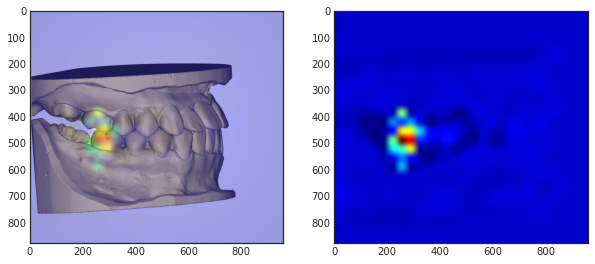

 13%|█▎        | 50/392 [00:55<06:11,  1.09s/it]

50 _label =  -1.0    predict =  -1 , pred =  [0.0889 0.     0.9111]


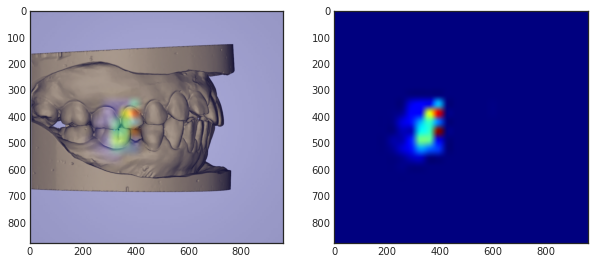

 13%|█▎        | 51/392 [00:57<06:07,  1.08s/it]

51 _label =  0.0    predict =  0 , pred =  [0.8775 0.06   0.0626]


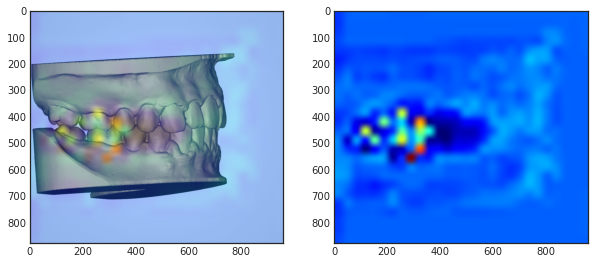

 13%|█▎        | 52/392 [00:58<06:21,  1.12s/it]

52 _label =  1.0    predict =  1 , pred =  [2.161e-01 7.835e-01 4.000e-04]


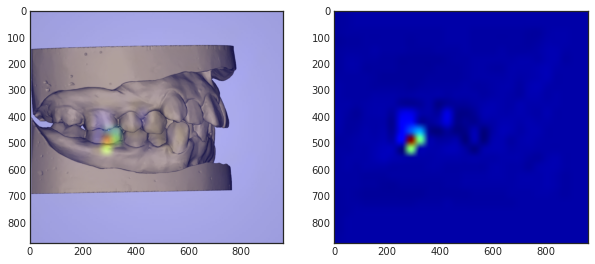

 14%|█▎        | 53/392 [00:59<06:14,  1.10s/it]

53 _label =  0.0    predict =  0 , pred =  [0.8759 0.07   0.0541]


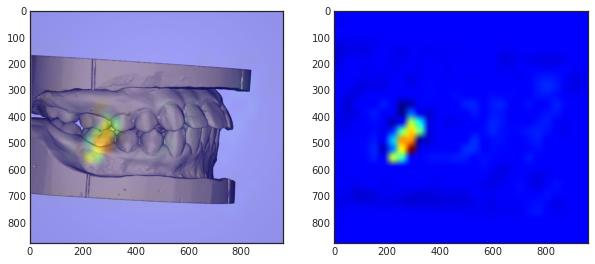

 14%|█▍        | 54/392 [01:00<06:08,  1.09s/it]

54 _label =  0.0    predict =  0 , pred =  [0.874  0.076  0.0499]


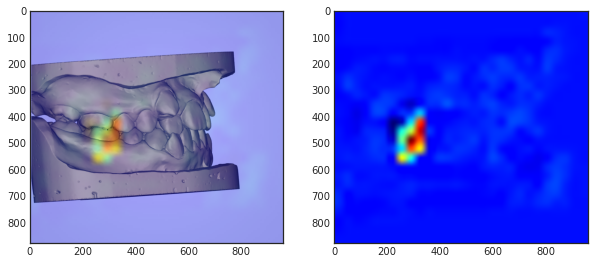

 14%|█▍        | 55/392 [01:01<06:03,  1.08s/it]

55 _label =  0.0    predict =  0 , pred =  [0.8737 0.0769 0.0494]


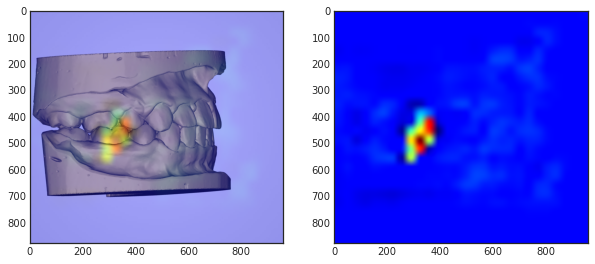

 14%|█▍        | 56/392 [01:02<05:58,  1.07s/it]

56 _label =  1.0    predict =  0 , pred =  [0.583  0.4121 0.0049]


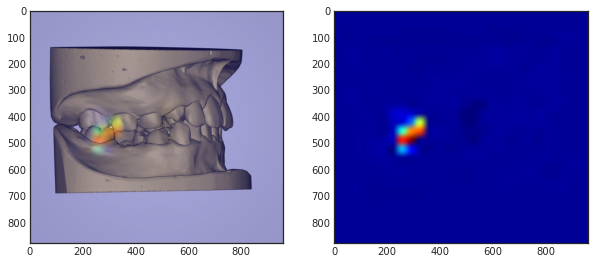

 15%|█▍        | 57/392 [01:03<06:42,  1.20s/it]

57 _label =  0.0    predict =  0 , pred =  [0.8749 0.0734 0.0516]


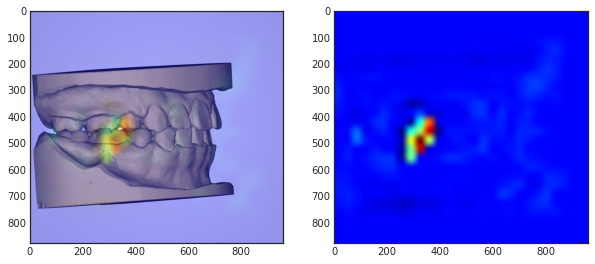

 15%|█▍        | 58/392 [01:05<06:24,  1.15s/it]

58 _label =  0.0    predict =  0 , pred =  [0.8713 0.0827 0.0459]


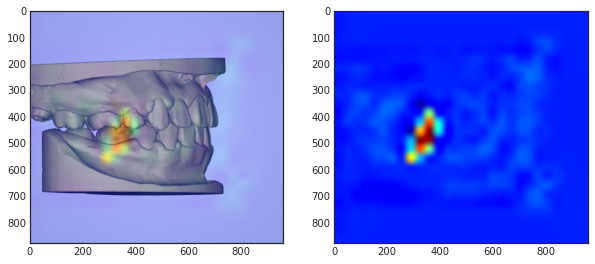

 15%|█▌        | 59/392 [01:06<06:11,  1.12s/it]

59 _label =  1.0    predict =  0 , pred =  [0.8401 0.132  0.0279]


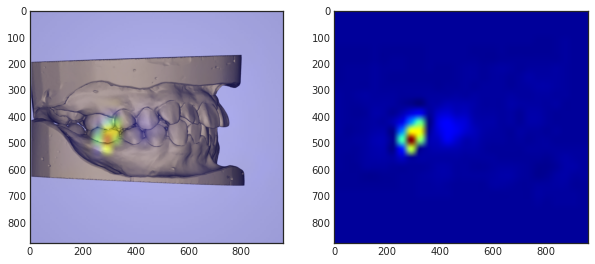

 15%|█▌        | 60/392 [01:07<06:02,  1.09s/it]

60 _label =  0.0    predict =  0 , pred =  [0.873  0.0788 0.0482]


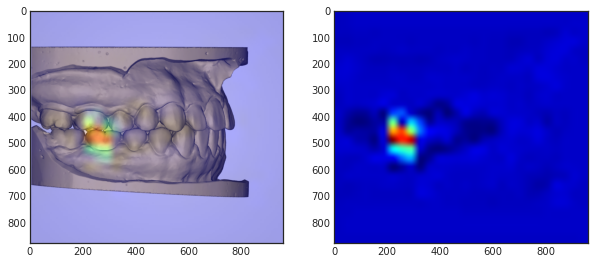

 16%|█▌        | 61/392 [01:08<06:00,  1.09s/it]

61 _label =  1.0    predict =  1 , pred =  [0.0451 0.9549 0.    ]


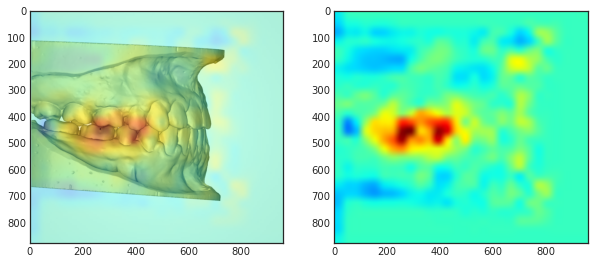

 16%|█▌        | 62/392 [01:09<06:11,  1.13s/it]

62 _label =  0.0    predict =  0 , pred =  [0.8711 0.0832 0.0457]


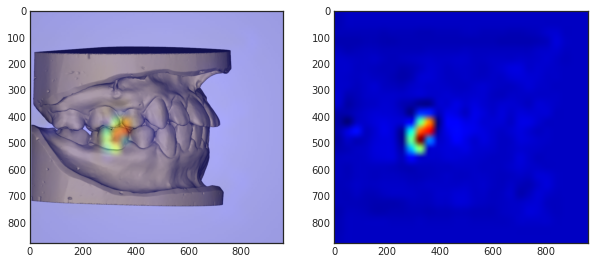

 16%|█▌        | 63/392 [01:10<06:22,  1.16s/it]

63 _label =  0.0    predict =  0 , pred =  [0.8766 0.0669 0.0565]


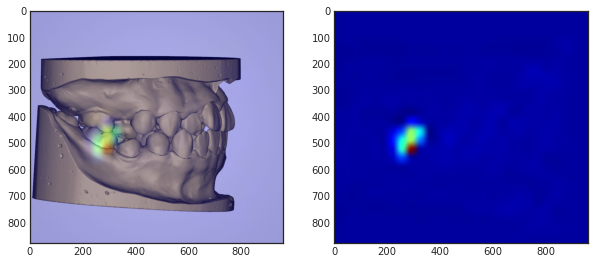

 16%|█▋        | 64/392 [01:11<06:12,  1.14s/it]

64 _label =  1.0    predict =  1 , pred =  [0.0087 0.9913 0.    ]


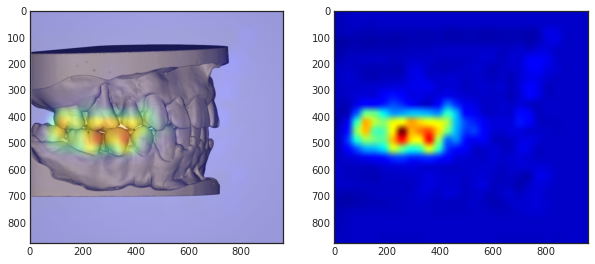

 17%|█▋        | 65/392 [01:12<06:11,  1.14s/it]

65 _label =  0.0    predict =  0 , pred =  [0.8772 0.0638 0.0591]


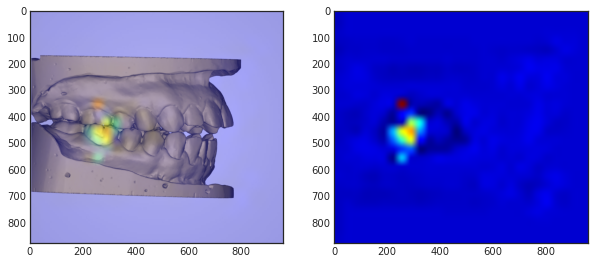

 17%|█▋        | 66/392 [01:13<06:01,  1.11s/it]

66 _label =  1.0    predict =  1 , pred =  [0.0521 0.9479 0.    ]


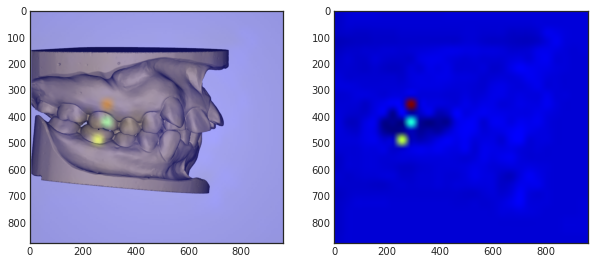

 17%|█▋        | 67/392 [01:14<05:53,  1.09s/it]

67 _label =  0.0    predict =  -1 , pred =  [1.23e-01 1.00e-04 8.77e-01]


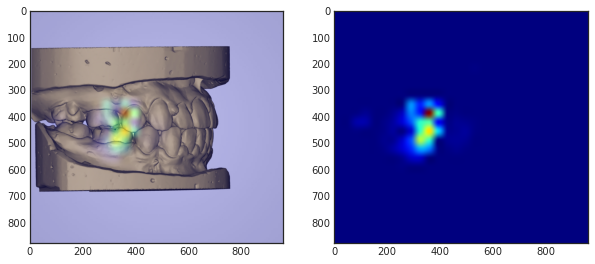

 17%|█▋        | 68/392 [01:15<05:46,  1.07s/it]

68 _label =  1.0    predict =  1 , pred =  [0.0311 0.9689 0.    ]


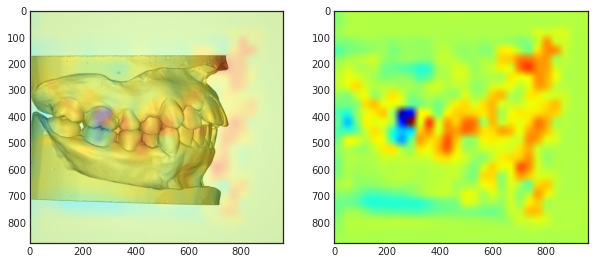

 18%|█▊        | 69/392 [01:17<05:42,  1.06s/it]

69 _label =  0.0    predict =  0 , pred =  [0.8746 0.0744 0.051 ]


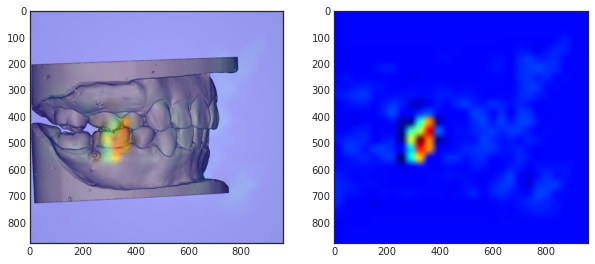

 18%|█▊        | 70/392 [01:18<05:43,  1.07s/it]

70 _label =  0.0    predict =  0 , pred =  [0.8736 0.0772 0.0492]


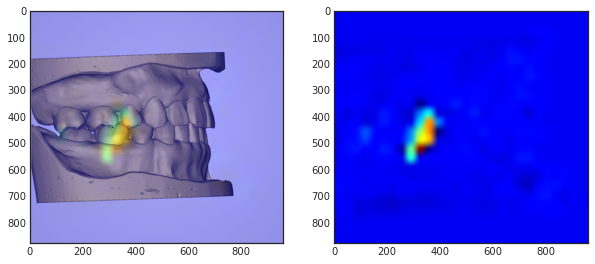

 18%|█▊        | 71/392 [01:19<05:42,  1.07s/it]

71 _label =  0.0    predict =  0 , pred =  [0.8752 0.047  0.0778]


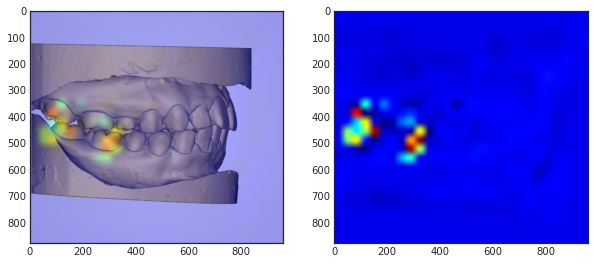

 18%|█▊        | 72/392 [01:20<05:42,  1.07s/it]

72 _label =  0.0    predict =  0 , pred =  [0.7977 0.0149 0.1874]


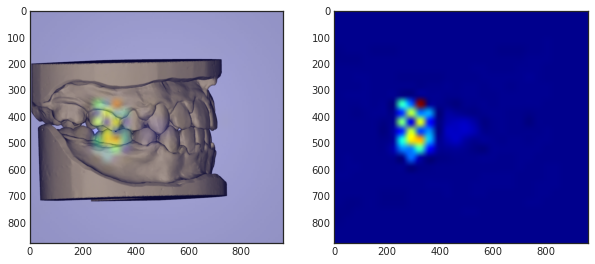

 19%|█▊        | 73/392 [01:21<05:54,  1.11s/it]

73 _label =  -1.0    predict =  -1 , pred =  [0.0721 0.     0.9279]


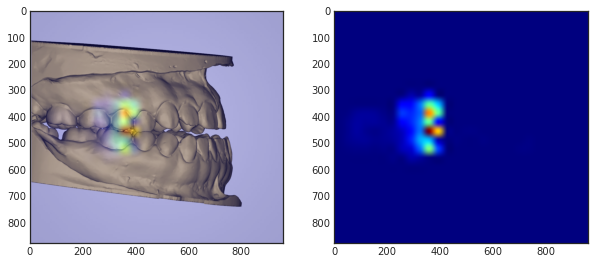

 19%|█▉        | 74/392 [01:22<05:49,  1.10s/it]

74 _label =  -1.0    predict =  -1 , pred =  [2.024e-01 2.000e-04 7.974e-01]


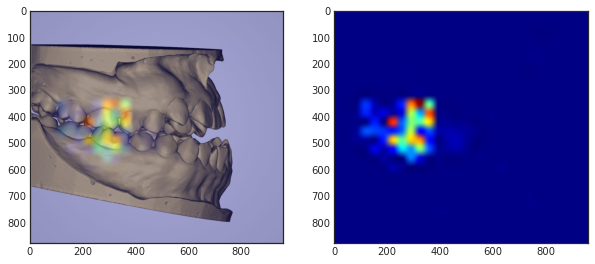

 19%|█▉        | 75/392 [01:23<06:00,  1.14s/it]

75 _label =  0.0    predict =  0 , pred =  [0.8744 0.0749 0.0507]


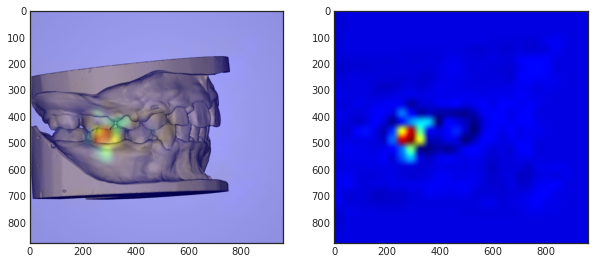

 19%|█▉        | 76/392 [01:24<05:54,  1.12s/it]

76 _label =  0.0    predict =  0 , pred =  [0.8286 0.1468 0.0246]


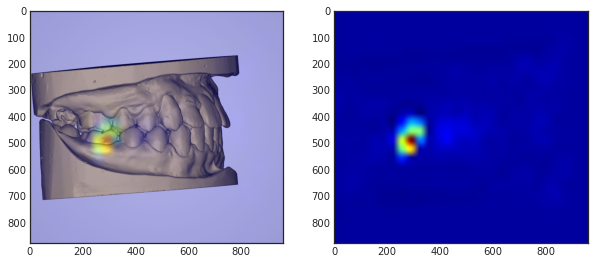

 20%|█▉        | 77/392 [01:25<05:57,  1.14s/it]

77 _label =  0.0    predict =  0 , pred =  [0.8528 0.1145 0.0327]


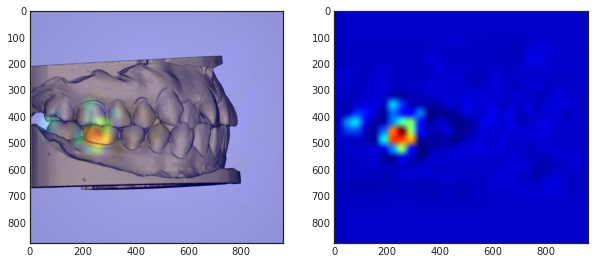

 20%|█▉        | 78/392 [01:27<06:01,  1.15s/it]

78 _label =  1.0    predict =  1 , pred =  [0.4785 0.5188 0.0027]


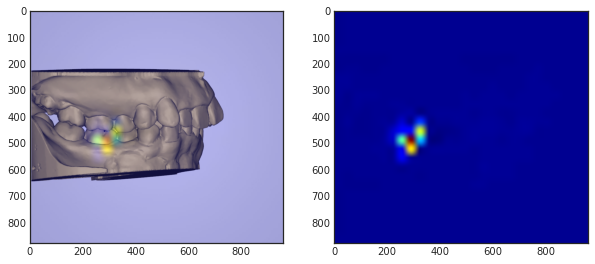

 20%|██        | 79/392 [01:28<06:36,  1.27s/it]

79 _label =  1.0    predict =  1 , pred =  [0.0561 0.9439 0.    ]


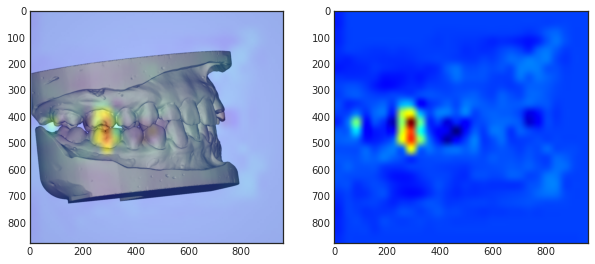

 20%|██        | 80/392 [01:29<06:14,  1.20s/it]

80 _label =  -1.0    predict =  -1 , pred =  [0.0867 0.     0.9133]


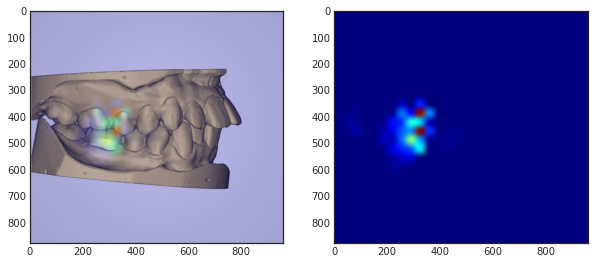

 21%|██        | 81/392 [01:30<06:12,  1.20s/it]

81 _label =  -1.0    predict =  -1 , pred =  [0.0739 0.     0.9261]


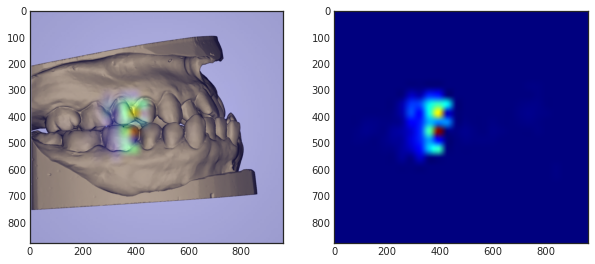

 21%|██        | 82/392 [01:32<06:12,  1.20s/it]

82 _label =  0.0    predict =  -1 , pred =  [0.1007 0.     0.8993]


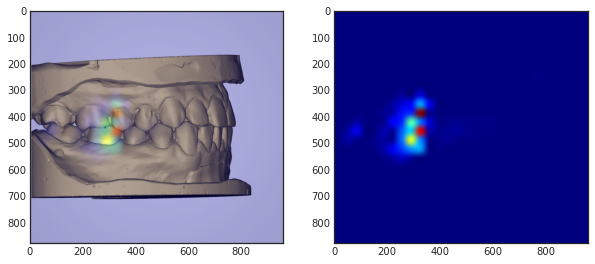

 21%|██        | 83/392 [01:33<05:59,  1.16s/it]

83 _label =  0.0    predict =  0 , pred =  [0.872  0.0813 0.0467]


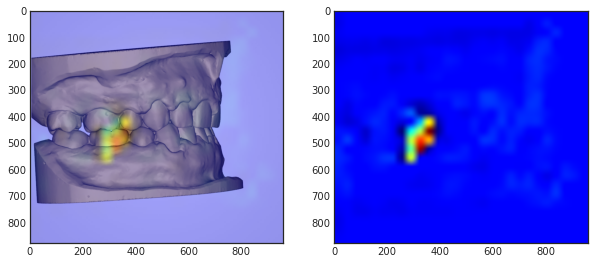

 21%|██▏       | 84/392 [01:34<06:00,  1.17s/it]

84 _label =  -1.0    predict =  -1 , pred =  [0.0981 0.     0.9019]


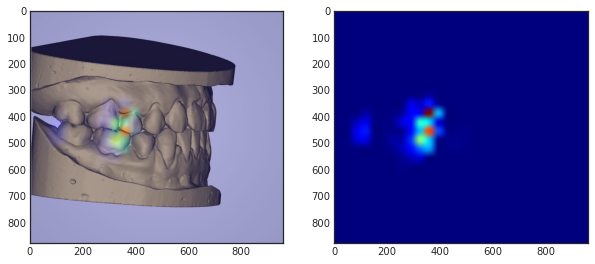

 22%|██▏       | 85/392 [01:35<06:00,  1.17s/it]

85 _label =  0.0    predict =  0 , pred =  [0.8708 0.0838 0.0453]


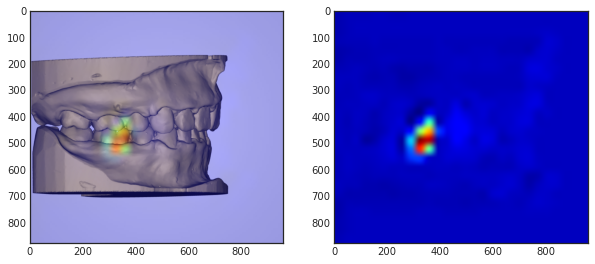

 22%|██▏       | 86/392 [01:36<05:47,  1.14s/it]

86 _label =  0.0    predict =  0 , pred =  [0.8769 0.0657 0.0574]


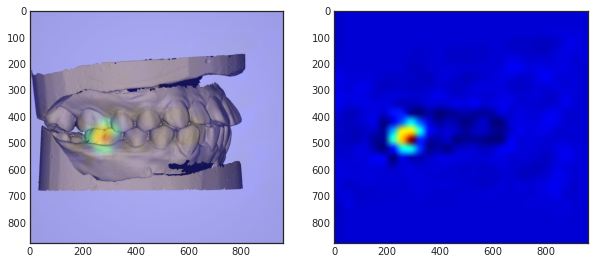

 22%|██▏       | 87/392 [01:37<05:40,  1.11s/it]

87 _label =  -1.0    predict =  -1 , pred =  [0.0729 0.     0.9271]


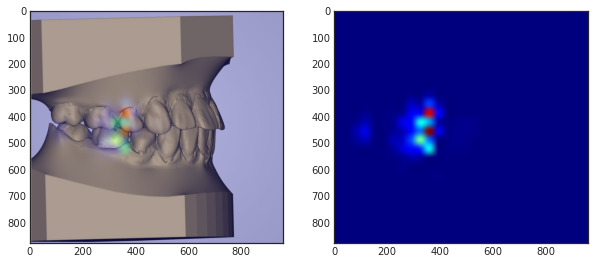

 22%|██▏       | 88/392 [01:38<05:34,  1.10s/it]

88 _label =  1.0    predict =  1 , pred =  [0.0417 0.9583 0.    ]


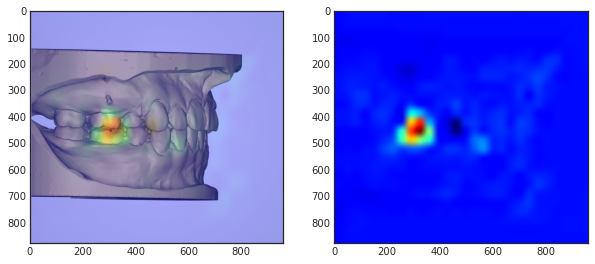

 23%|██▎       | 89/392 [01:39<05:30,  1.09s/it]

89 _label =  -1.0    predict =  -1 , pred =  [0.0254 0.     0.9746]


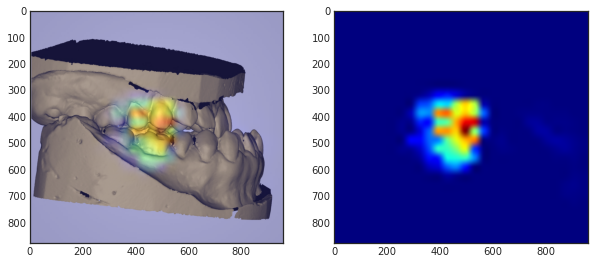

 23%|██▎       | 90/392 [01:41<05:38,  1.12s/it]

90 _label =  1.0    predict =  1 , pred =  [0.0426 0.9574 0.    ]


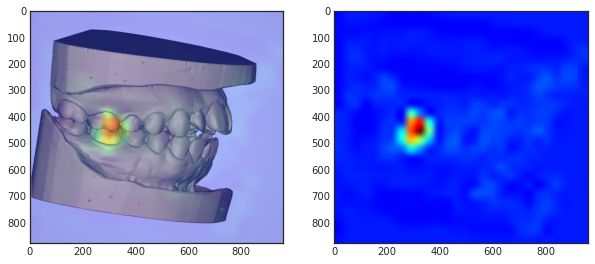

 23%|██▎       | 91/392 [01:42<05:29,  1.10s/it]

91 _label =  1.0    predict =  1 , pred =  [0.0386 0.9614 0.    ]


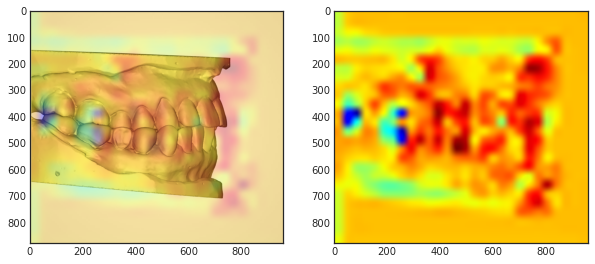

 23%|██▎       | 92/392 [01:43<05:37,  1.13s/it]

92 _label =  0.0    predict =  0 , pred =  [0.8751 0.0728 0.0521]


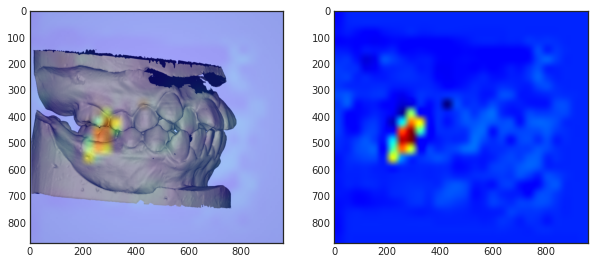

 24%|██▎       | 93/392 [01:44<05:36,  1.13s/it]

93 _label =  0.0    predict =  0 , pred =  [0.8759 0.07   0.0541]


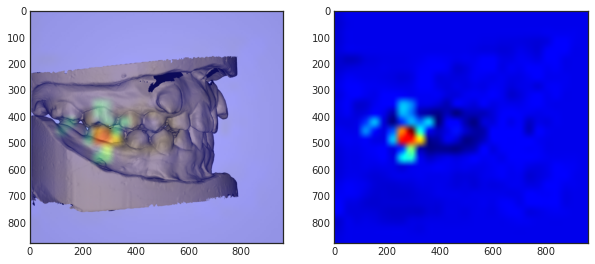

 24%|██▍       | 94/392 [01:45<05:30,  1.11s/it]

94 _label =  -1.0    predict =  -1 , pred =  [1.235e-01 1.000e-04 8.764e-01]


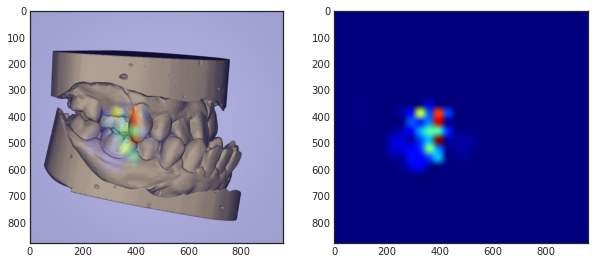

 24%|██▍       | 95/392 [01:46<05:26,  1.10s/it]

95 _label =  1.0    predict =  1 , pred =  [0.0338 0.9662 0.    ]


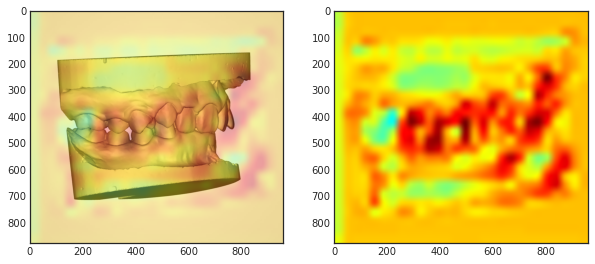

 24%|██▍       | 96/392 [01:47<05:20,  1.08s/it]

96 _label =  0.0    predict =  -1 , pred =  [0.0873 0.     0.9127]


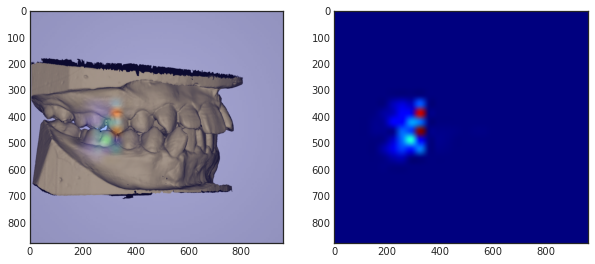

 25%|██▍       | 97/392 [01:48<05:17,  1.08s/it]

97 _label =  -1.0    predict =  -1 , pred =  [0.0948 0.     0.9052]


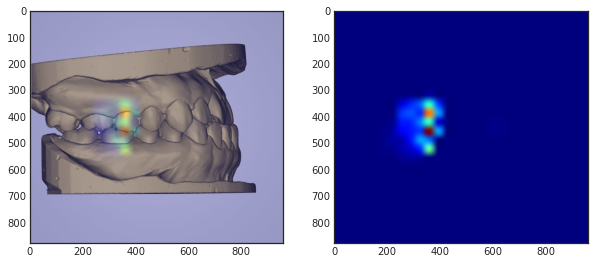

 25%|██▌       | 98/392 [01:49<05:23,  1.10s/it]

98 _label =  -1.0    predict =  -1 , pred =  [0.0958 0.     0.9042]


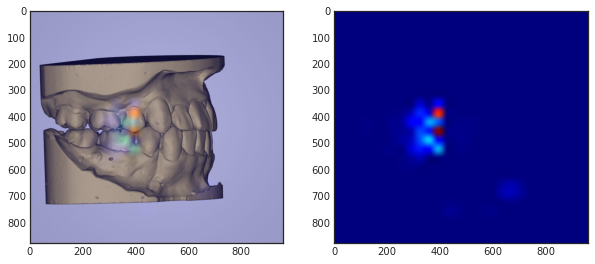

 25%|██▌       | 99/392 [01:51<05:31,  1.13s/it]

99 _label =  -1.0    predict =  -1 , pred =  [0.0611 0.     0.9388]


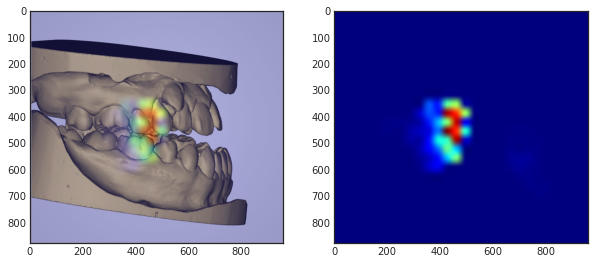

 26%|██▌       | 100/392 [01:52<05:24,  1.11s/it]

100 _label =  1.0    predict =  1 , pred =  [0.0398 0.9602 0.    ]


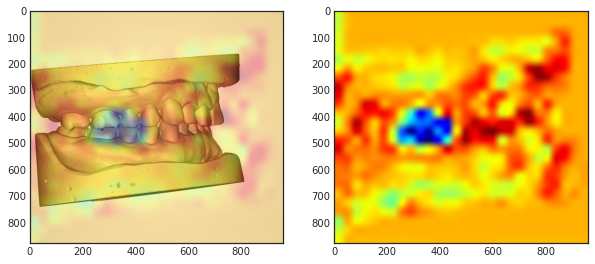

 26%|██▌       | 101/392 [01:53<06:04,  1.25s/it]

101 _label =  0.0    predict =  0 , pred =  [0.8615 0.1012 0.0374]


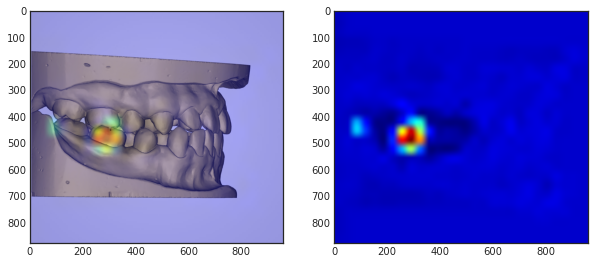

 26%|██▌       | 102/392 [01:54<06:05,  1.26s/it]

102 _label =  0.0    predict =  0 , pred =  [0.8723 0.0805 0.0472]


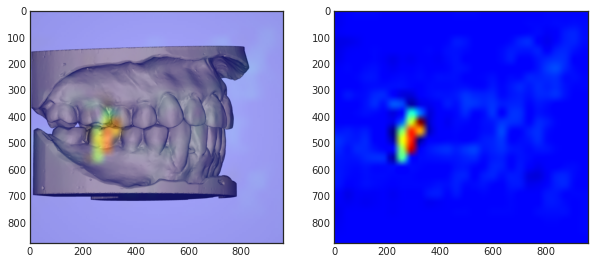

 26%|██▋       | 103/392 [01:56<05:59,  1.24s/it]

103 _label =  1.0    predict =  1 , pred =  [0.0421 0.9579 0.    ]


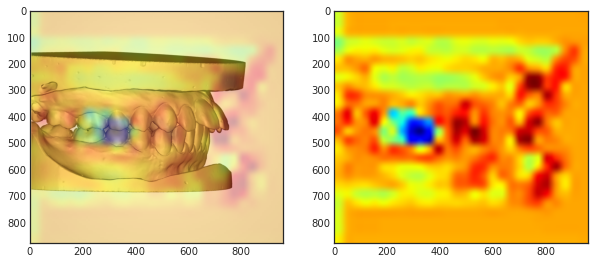

 27%|██▋       | 104/392 [01:57<05:45,  1.20s/it]

104 _label =  -1.0    predict =  -1 , pred =  [0.1139 0.     0.886 ]


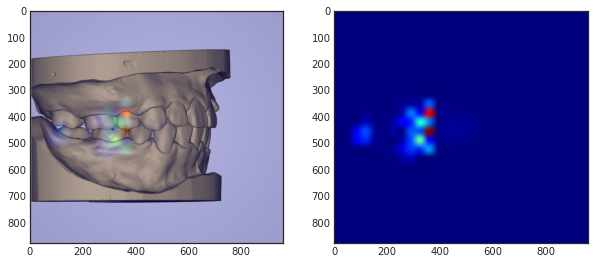

 27%|██▋       | 105/392 [01:58<05:44,  1.20s/it]

105 _label =  0.0    predict =  0 , pred =  [0.8699 0.0859 0.0442]


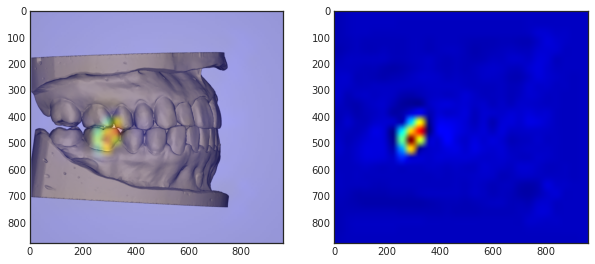

 27%|██▋       | 106/392 [01:59<05:45,  1.21s/it]

106 _label =  1.0    predict =  0 , pred =  [0.8718 0.0816 0.0466]


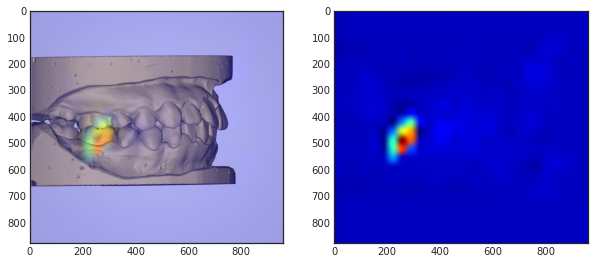

 27%|██▋       | 107/392 [02:00<05:31,  1.16s/it]

107 _label =  -1.0    predict =  -1 , pred =  [0.0726 0.     0.9274]


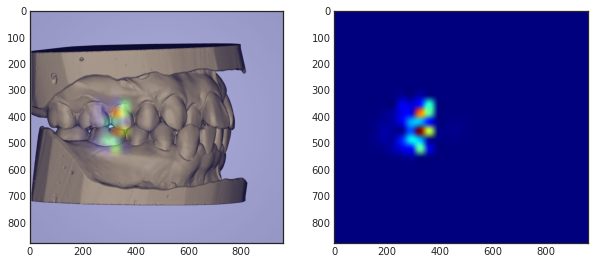

 28%|██▊       | 108/392 [02:01<05:20,  1.13s/it]

108 _label =  0.0    predict =  0 , pred =  [0.8753 0.072  0.0526]


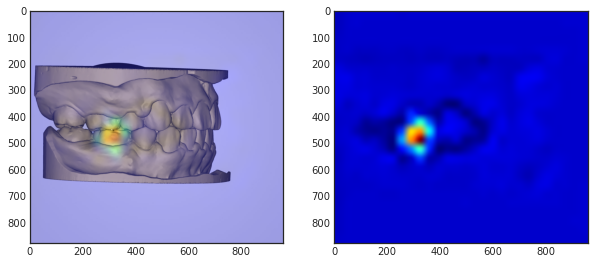

 28%|██▊       | 109/392 [02:02<05:12,  1.11s/it]

109 _label =  1.0    predict =  1 , pred =  [0.0331 0.9669 0.    ]


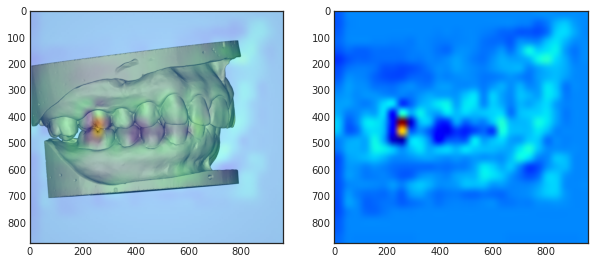

 28%|██▊       | 110/392 [02:03<05:05,  1.08s/it]

110 _label =  1.0    predict =  1 , pred =  [0.0538 0.9462 0.    ]


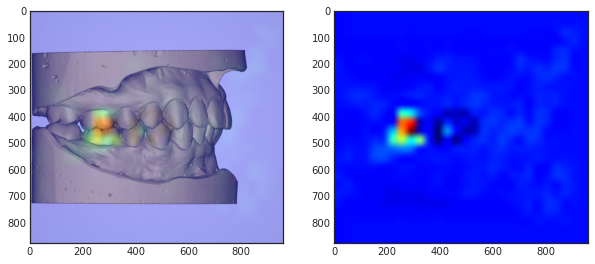

 28%|██▊       | 111/392 [02:04<05:04,  1.08s/it]

111 _label =  -1.0    predict =  -1 , pred =  [0.0879 0.     0.912 ]


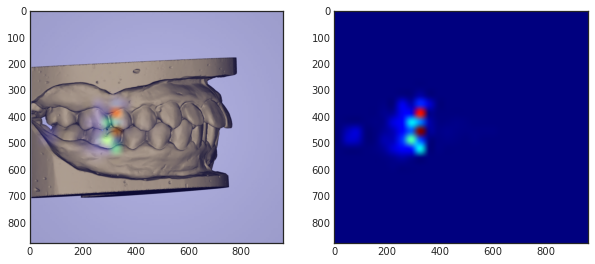

 29%|██▊       | 112/392 [02:05<05:01,  1.08s/it]

112 _label =  -1.0    predict =  -1 , pred =  [0.1127 0.     0.8873]


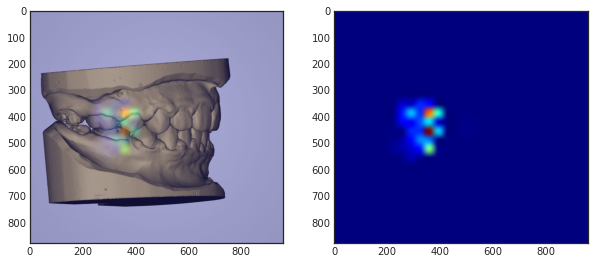

 29%|██▉       | 113/392 [02:07<04:55,  1.06s/it]

113 _label =  -1.0    predict =  -1 , pred =  [0.1002 0.     0.8998]


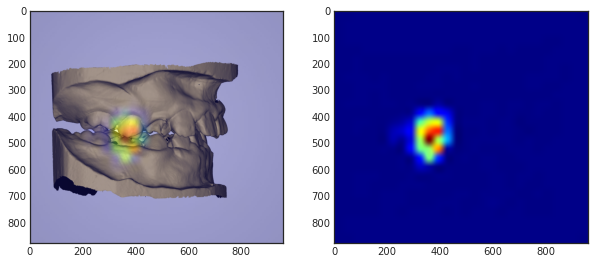

 29%|██▉       | 114/392 [02:08<04:54,  1.06s/it]

114 _label =  -1.0    predict =  -1 , pred =  [1.207e-01 1.000e-04 8.792e-01]


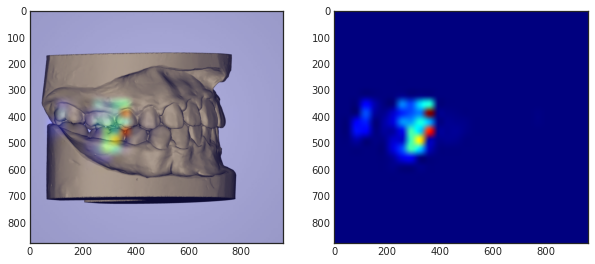

 29%|██▉       | 115/392 [02:09<04:55,  1.07s/it]

115 _label =  -1.0    predict =  -1 , pred =  [0.0953 0.     0.9046]


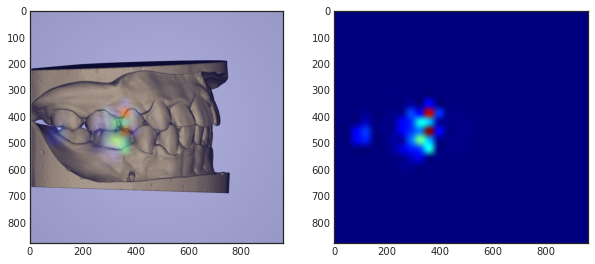

 30%|██▉       | 116/392 [02:10<04:53,  1.06s/it]

116 _label =  0.0    predict =  0 , pred =  [0.8729 0.0791 0.048 ]


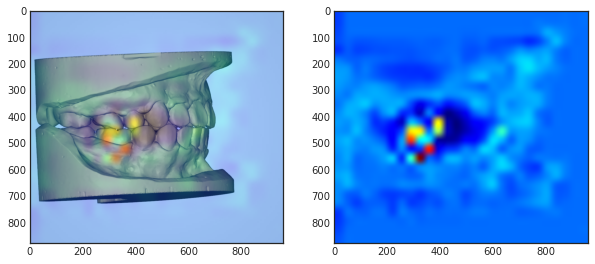

 30%|██▉       | 117/392 [02:11<04:52,  1.06s/it]

117 _label =  0.0    predict =  0 , pred =  [0.8763 0.0685 0.0552]


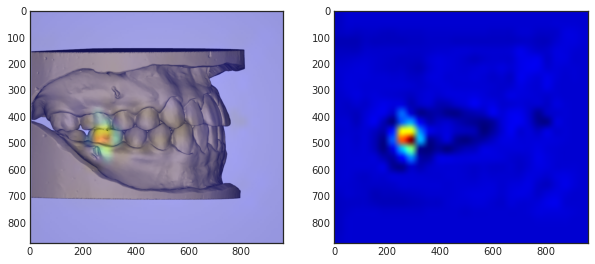

 30%|███       | 118/392 [02:12<05:01,  1.10s/it]

118 _label =  -1.0    predict =  -1 , pred =  [0.0517 0.     0.9483]


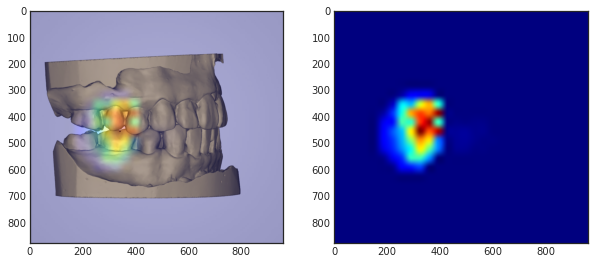

 30%|███       | 119/392 [02:13<04:54,  1.08s/it]

119 _label =  1.0    predict =  1 , pred =  [0.0403 0.9597 0.    ]


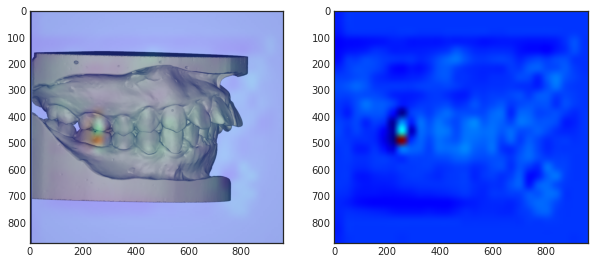

 31%|███       | 120/392 [02:14<04:49,  1.06s/it]

120 _label =  -1.0    predict =  -1 , pred =  [0.1048 0.     0.8952]


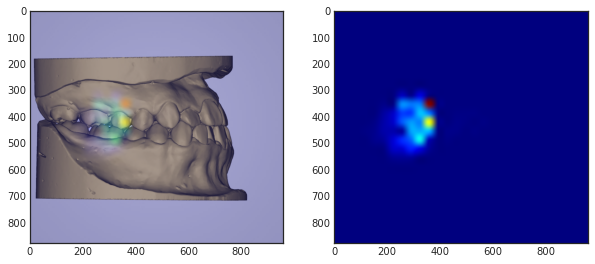

 31%|███       | 121/392 [02:15<04:44,  1.05s/it]

121 _label =  0.0    predict =  0 , pred =  [0.8731 0.0786 0.0483]


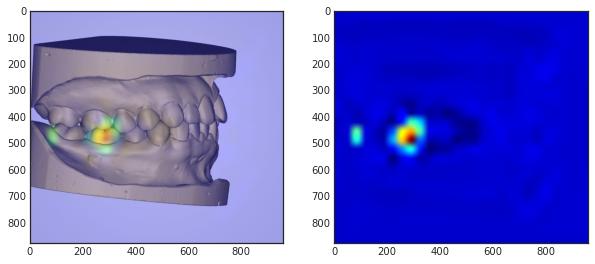

 31%|███       | 122/392 [02:16<04:44,  1.05s/it]

122 _label =  0.0    predict =  0 , pred =  [0.8751 0.0728 0.0521]


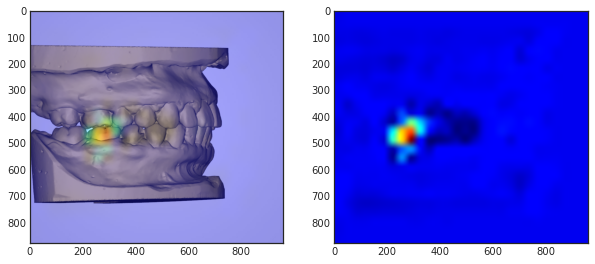

 31%|███▏      | 123/392 [02:18<05:21,  1.20s/it]

123 _label =  0.0    predict =  0 , pred =  [0.8714 0.0826 0.046 ]


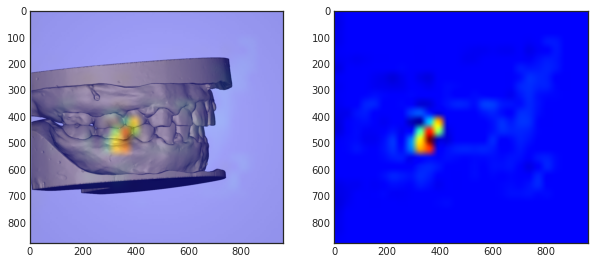

 32%|███▏      | 124/392 [02:19<05:09,  1.15s/it]

124 _label =  -1.0    predict =  -1 , pred =  [0.0972 0.     0.9028]


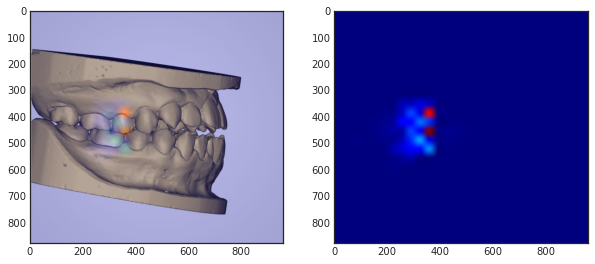

 32%|███▏      | 125/392 [02:20<04:59,  1.12s/it]

125 _label =  0.0    predict =  1 , pred =  [0.041 0.959 0.   ]


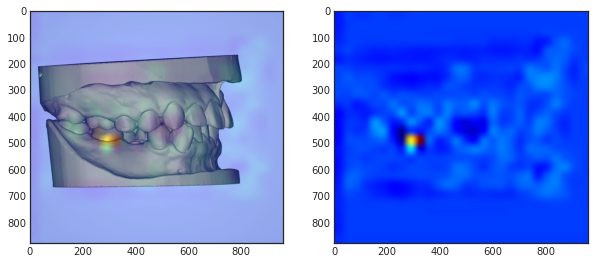

 32%|███▏      | 126/392 [02:21<04:53,  1.10s/it]

126 _label =  0.0    predict =  0 , pred =  [0.8746 0.0744 0.051 ]


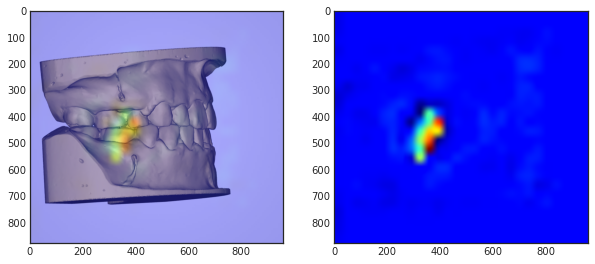

 32%|███▏      | 127/392 [02:22<04:47,  1.08s/it]

127 _label =  0.0    predict =  0 , pred =  [0.8759 0.0701 0.054 ]


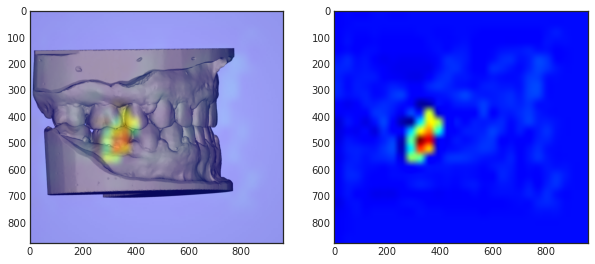

 33%|███▎      | 128/392 [02:23<04:45,  1.08s/it]

128 _label =  -1.0    predict =  -1 , pred =  [0.0935 0.     0.9064]


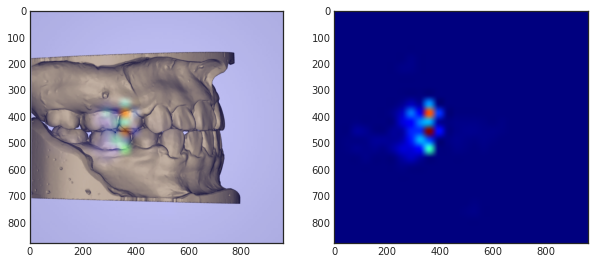

 33%|███▎      | 129/392 [02:24<04:40,  1.07s/it]

129 _label =  -1.0    predict =  -1 , pred =  [1.175e-01 1.000e-04 8.825e-01]


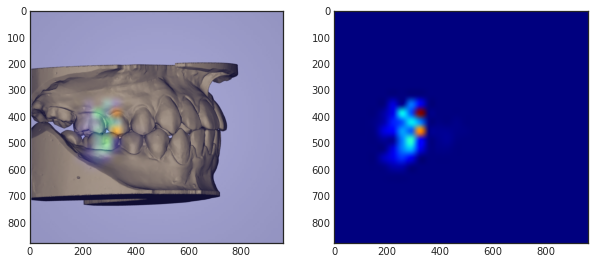

 33%|███▎      | 130/392 [02:25<04:36,  1.05s/it]

130 _label =  0.0    predict =  0 , pred =  [0.8524 0.1151 0.0325]


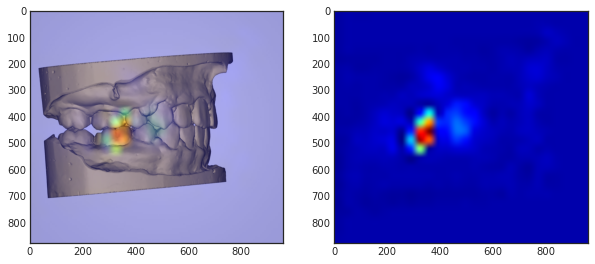

 33%|███▎      | 131/392 [02:26<04:33,  1.05s/it]

131 _label =  -1.0    predict =  -1 , pred =  [0.0996 0.     0.9004]


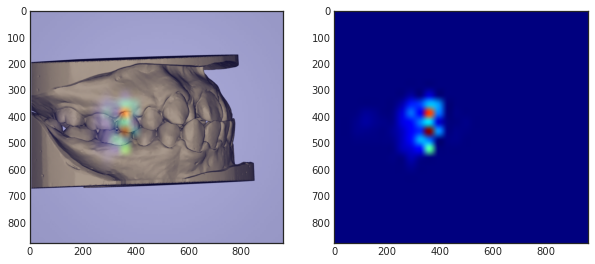

 34%|███▎      | 132/392 [02:27<04:43,  1.09s/it]

132 _label =  0.0    predict =  0 , pred =  [0.6063 0.0038 0.3899]


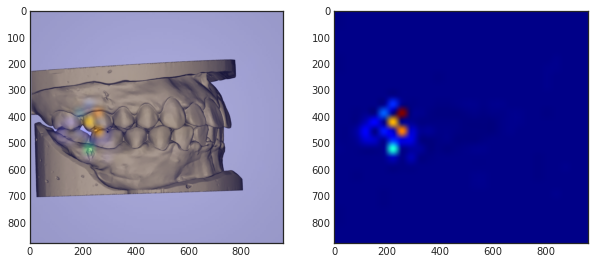

 34%|███▍      | 133/392 [02:28<04:38,  1.07s/it]

133 _label =  1.0    predict =  1 , pred =  [0.0334 0.9666 0.    ]


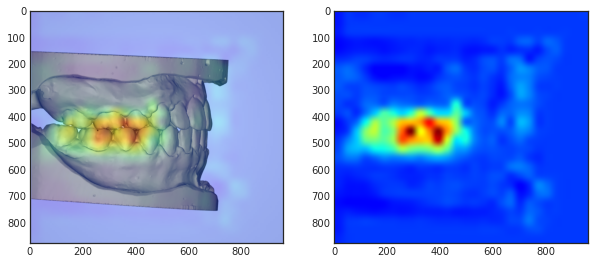

 34%|███▍      | 134/392 [02:29<04:33,  1.06s/it]

134 _label =  0.0    predict =  0 , pred =  [0.8732 0.0783 0.0485]


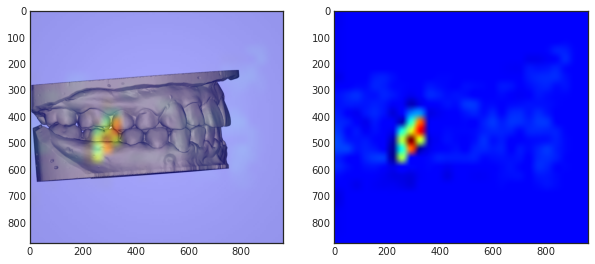

 34%|███▍      | 135/392 [02:30<04:41,  1.09s/it]

135 _label =  0.0    predict =  0 , pred =  [0.8714 0.0825 0.0461]


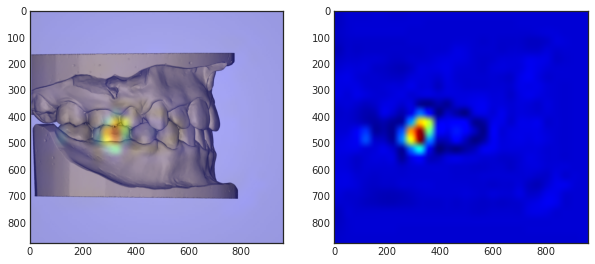

 35%|███▍      | 136/392 [02:31<04:36,  1.08s/it]

136 _label =  0.0    predict =  0 , pred =  [0.872  0.0812 0.0468]


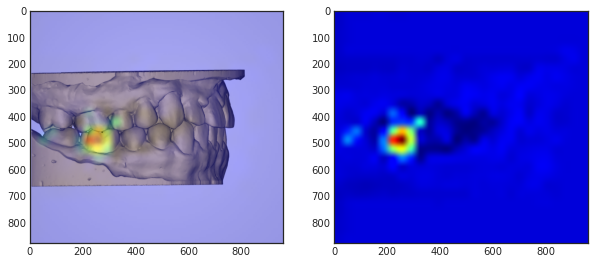

 35%|███▍      | 137/392 [02:33<04:34,  1.08s/it]

137 _label =  1.0    predict =  1 , pred =  [0.075  0.9249 0.    ]


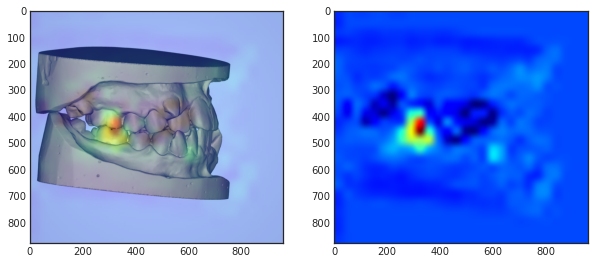

 35%|███▌      | 138/392 [02:34<04:30,  1.07s/it]

138 _label =  -1.0    predict =  -1 , pred =  [0.0833 0.     0.9167]


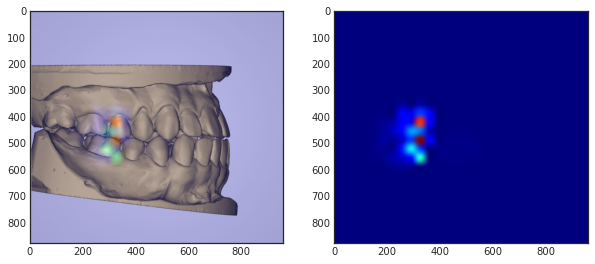

 35%|███▌      | 139/392 [02:35<04:26,  1.05s/it]

139 _label =  1.0    predict =  1 , pred =  [0.0248 0.9752 0.    ]


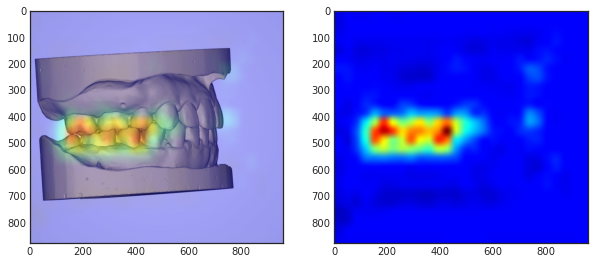

 36%|███▌      | 140/392 [02:36<04:27,  1.06s/it]

140 _label =  -1.0    predict =  -1 , pred =  [0.1104 0.     0.8895]


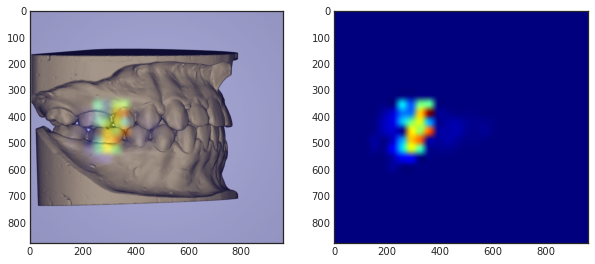

 36%|███▌      | 141/392 [02:37<04:26,  1.06s/it]

141 _label =  -1.0    predict =  -1 , pred =  [0.0898 0.     0.9101]


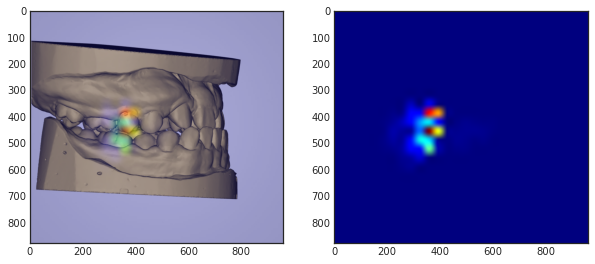

 36%|███▌      | 142/392 [02:38<04:23,  1.05s/it]

142 _label =  -1.0    predict =  1 , pred =  [0.0363 0.9637 0.    ]


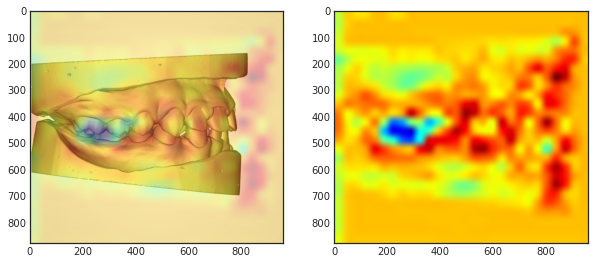

 36%|███▋      | 143/392 [02:39<04:20,  1.05s/it]

143 _label =  1.0    predict =  1 , pred =  [0.0301 0.9699 0.    ]


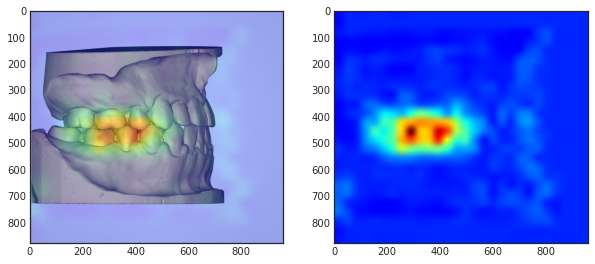

 37%|███▋      | 144/392 [02:40<04:18,  1.04s/it]

144 _label =  -1.0    predict =  0 , pred =  [0.8696 0.0865 0.0439]


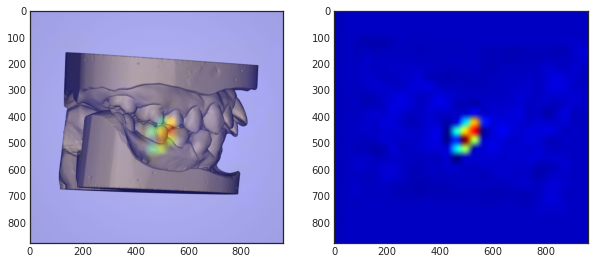

 37%|███▋      | 145/392 [02:41<04:53,  1.19s/it]

145 _label =  1.0    predict =  0 , pred =  [0.6788 0.3128 0.0084]


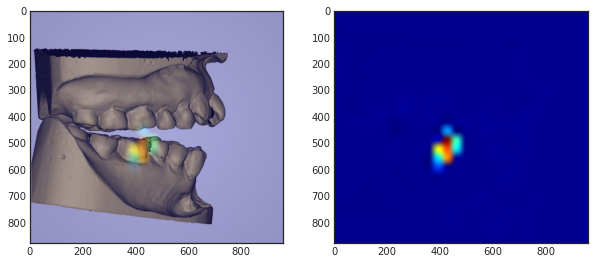

 37%|███▋      | 146/392 [02:42<04:40,  1.14s/it]

146 _label =  -1.0    predict =  -1 , pred =  [0.0997 0.     0.9002]


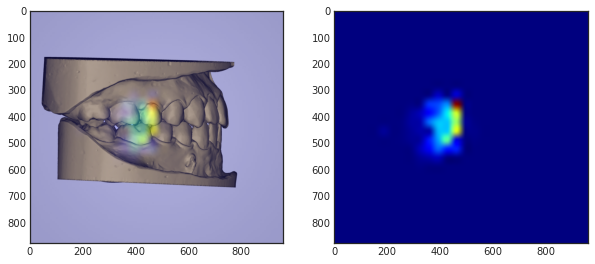

 38%|███▊      | 147/392 [02:43<04:30,  1.10s/it]

147 _label =  1.0    predict =  1 , pred =  [0.0504 0.9496 0.    ]


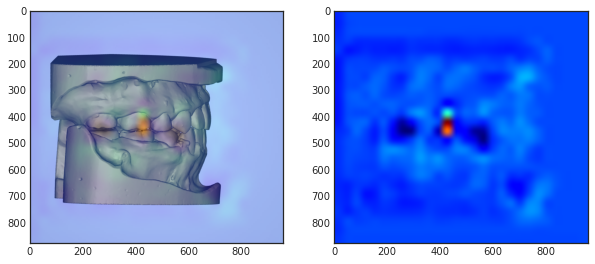

 38%|███▊      | 148/392 [02:44<04:23,  1.08s/it]

148 _label =  1.0    predict =  1 , pred =  [0.0364 0.9636 0.    ]


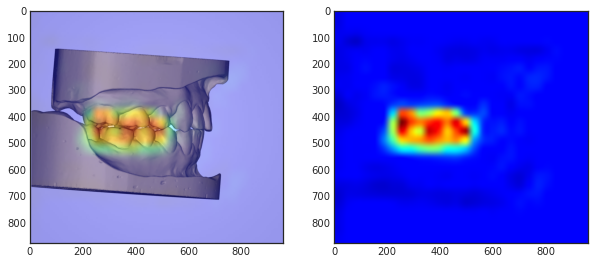

 38%|███▊      | 149/392 [02:46<04:20,  1.07s/it]

149 _label =  1.0    predict =  1 , pred =  [0.0371 0.9629 0.    ]


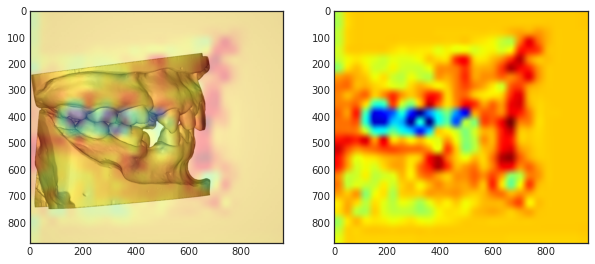

 38%|███▊      | 150/392 [02:47<04:19,  1.07s/it]

150 _label =  0.0    predict =  0 , pred =  [0.8707 0.084  0.0452]


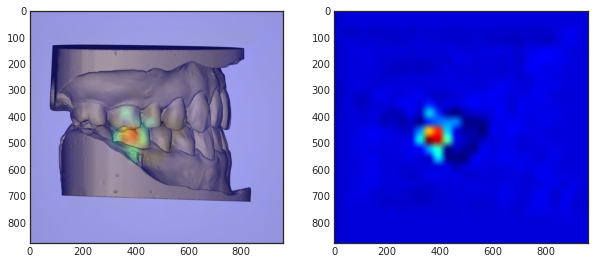

 39%|███▊      | 151/392 [02:48<04:27,  1.11s/it]

151 _label =  1.0    predict =  0 , pred =  [0.8205 0.0186 0.1609]


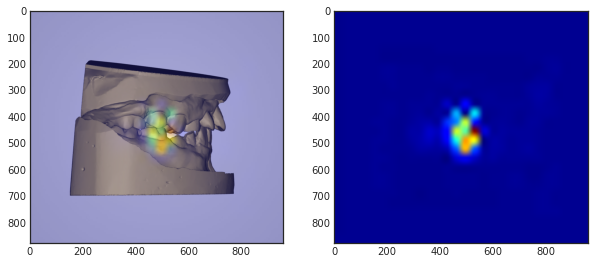

 39%|███▉      | 152/392 [02:49<04:20,  1.09s/it]

152 _label =  1.0    predict =  1 , pred =  [0.0623 0.9376 0.    ]


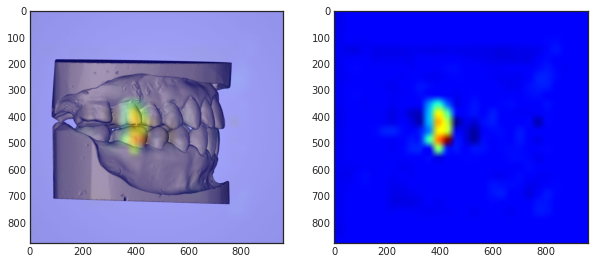

 39%|███▉      | 153/392 [02:50<04:21,  1.09s/it]

153 _label =  -1.0    predict =  -1 , pred =  [0.0824 0.     0.9176]


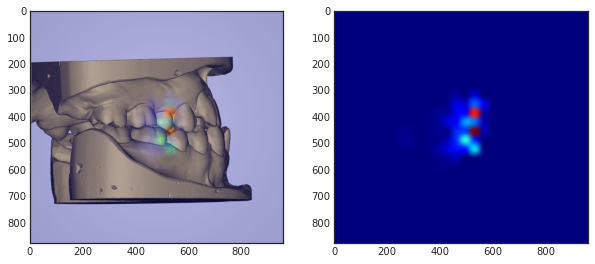

 39%|███▉      | 154/392 [02:51<04:15,  1.07s/it]

154 _label =  0.0    predict =  0 , pred =  [0.8746 0.0745 0.0509]


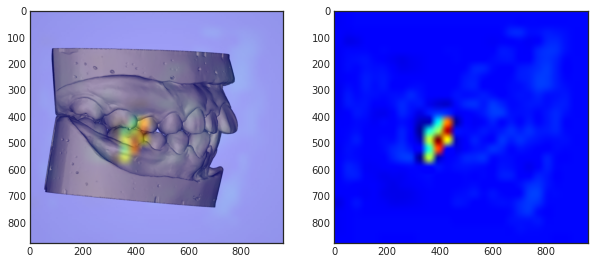

 40%|███▉      | 155/392 [02:52<04:11,  1.06s/it]

155 _label =  1.0    predict =  1 , pred =  [0.016 0.984 0.   ]


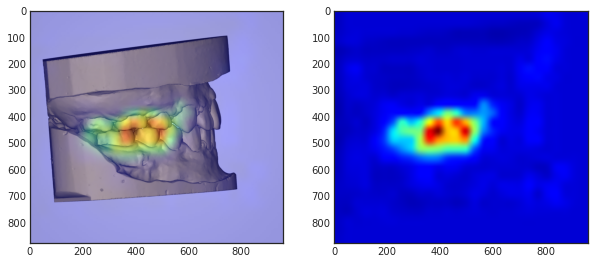

 40%|███▉      | 156/392 [02:53<04:08,  1.05s/it]

156 _label =  0.0    predict =  0 , pred =  [0.8775 0.0582 0.0643]


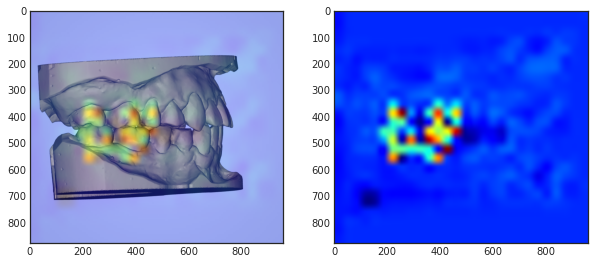

 40%|████      | 157/392 [02:54<04:05,  1.05s/it]

157 _label =  0.0    predict =  0 , pred =  [0.8752 0.0726 0.0522]


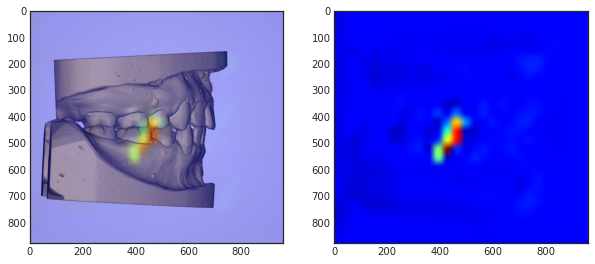

 40%|████      | 158/392 [02:55<04:03,  1.04s/it]

158 _label =  1.0    predict =  0 , pred =  [0.8557 0.1103 0.0341]


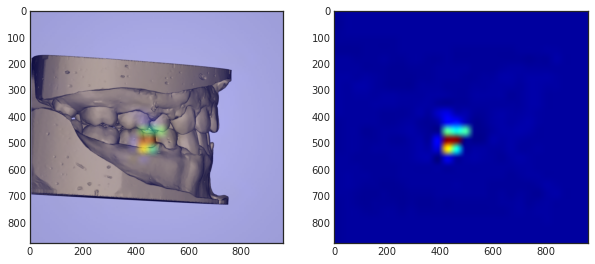

 41%|████      | 159/392 [02:56<03:59,  1.03s/it]

159 _label =  0.0    predict =  0 , pred =  [0.8731 0.0785 0.0484]


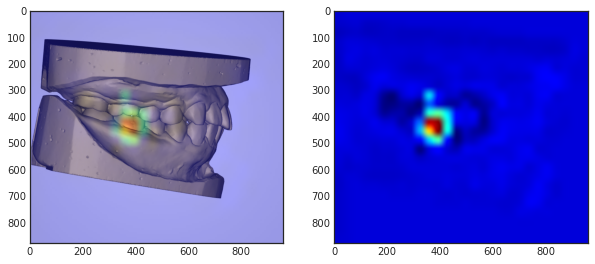

 41%|████      | 160/392 [02:57<03:58,  1.03s/it]

160 _label =  1.0    predict =  1 , pred =  [0.04 0.96 0.  ]


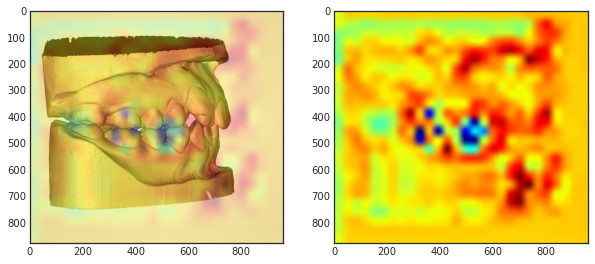

 41%|████      | 161/392 [02:58<03:58,  1.03s/it]

161 _label =  1.0    predict =  0 , pred =  [0.8774 0.0607 0.0618]


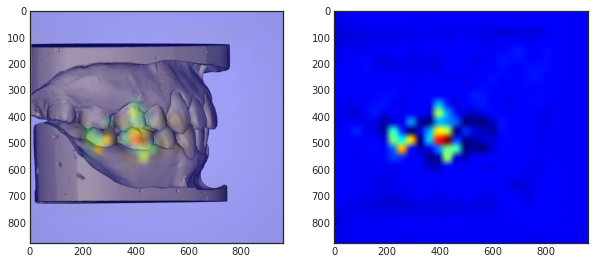

 41%|████▏     | 162/392 [02:59<04:00,  1.05s/it]

162 _label =  1.0    predict =  1 , pred =  [0.012 0.988 0.   ]


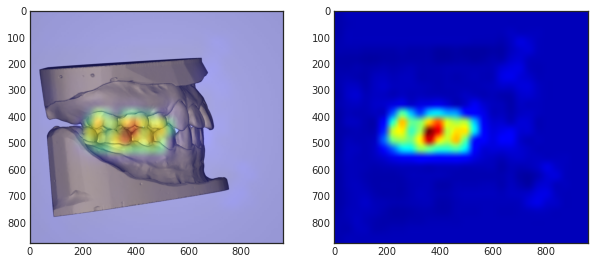

 42%|████▏     | 163/392 [03:00<04:09,  1.09s/it]

163 _label =  -1.0    predict =  -1 , pred =  [0.1107 0.     0.8892]


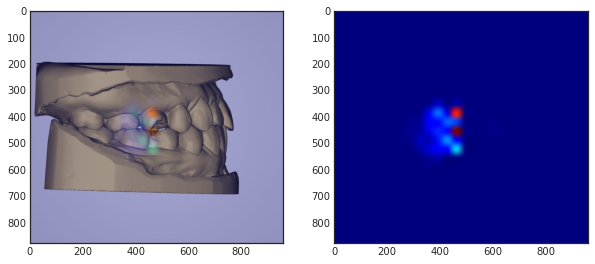

 42%|████▏     | 164/392 [03:02<04:09,  1.09s/it]

164 _label =  1.0    predict =  0 , pred =  [0.8717 0.082  0.0464]


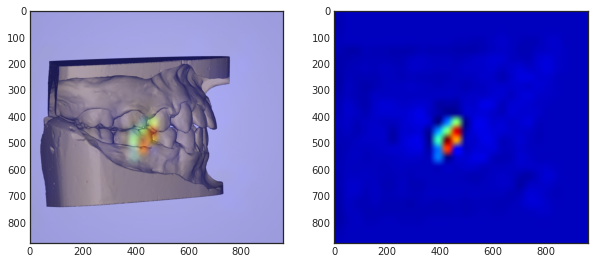

 42%|████▏     | 165/392 [03:03<04:07,  1.09s/it]

165 _label =  0.0    predict =  0 , pred =  [0.7045 0.0072 0.2883]


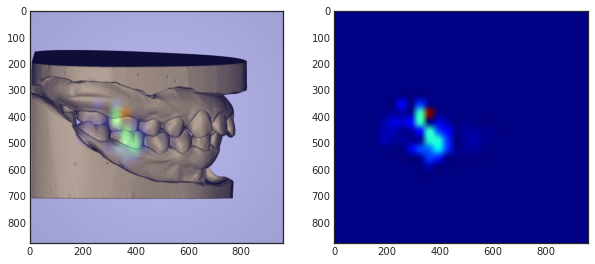

 42%|████▏     | 166/392 [03:04<04:05,  1.09s/it]

166 _label =  -1.0    predict =  -1 , pred =  [0.0822 0.     0.9178]


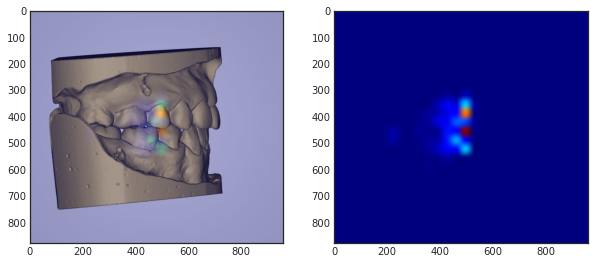

 43%|████▎     | 167/392 [03:05<04:38,  1.24s/it]

167 _label =  0.0    predict =  -1 , pred =  [3.008e-01 5.000e-04 6.987e-01]


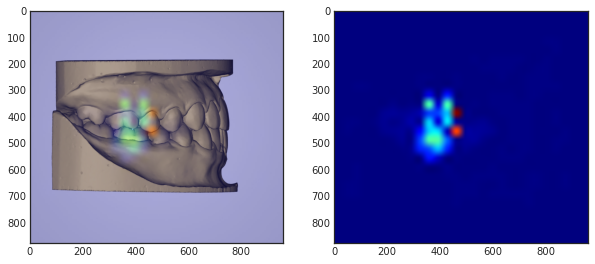

 43%|████▎     | 168/392 [03:06<04:22,  1.17s/it]

168 _label =  0.0    predict =  0 , pred =  [0.8762 0.0691 0.0548]


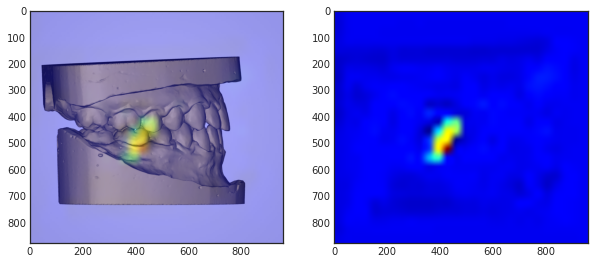

 43%|████▎     | 169/392 [03:07<04:12,  1.13s/it]

169 _label =  1.0    predict =  1 , pred =  [0.0426 0.9574 0.    ]


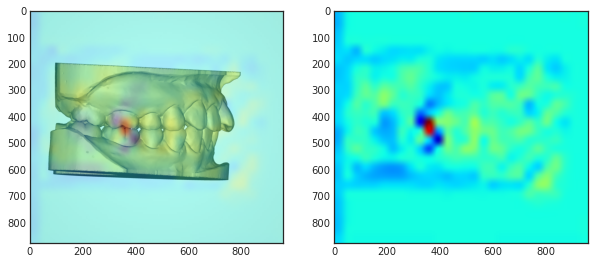

 43%|████▎     | 170/392 [03:08<04:05,  1.11s/it]

170 _label =  0.0    predict =  0 , pred =  [0.8667 0.092  0.0412]


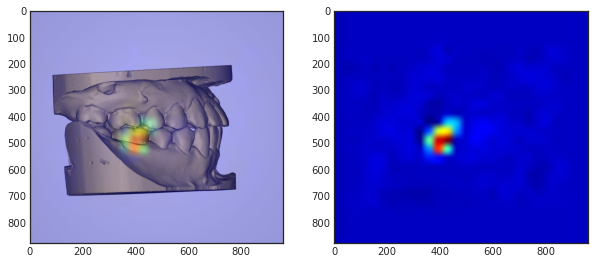

 44%|████▎     | 171/392 [03:09<03:58,  1.08s/it]

171 _label =  0.0    predict =  0 , pred =  [0.8632 0.0983 0.0385]


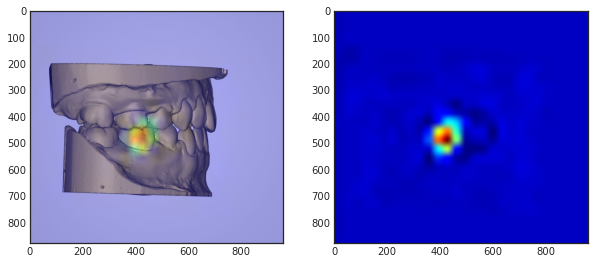

 44%|████▍     | 172/392 [03:10<03:54,  1.07s/it]

172 _label =  1.0    predict =  1 , pred =  [0.0317 0.9683 0.    ]


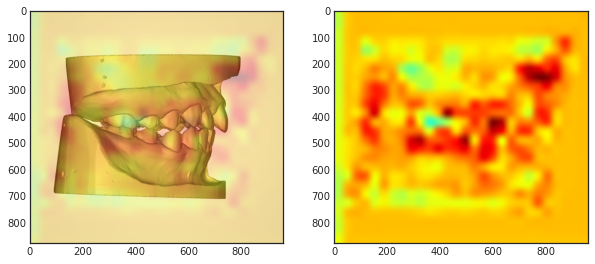

 44%|████▍     | 173/392 [03:11<03:51,  1.06s/it]

173 _label =  1.0    predict =  1 , pred =  [0.066 0.934 0.   ]


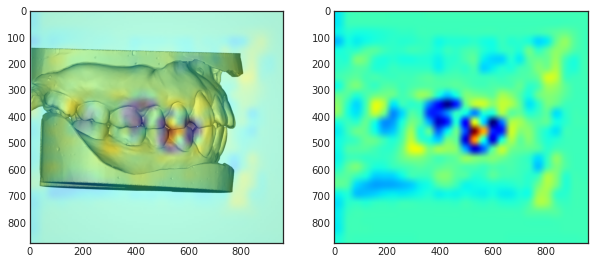

 44%|████▍     | 174/392 [03:12<03:49,  1.05s/it]

174 _label =  1.0    predict =  1 , pred =  [0.04 0.96 0.  ]


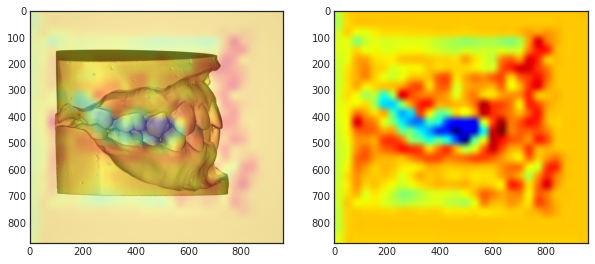

 45%|████▍     | 175/392 [03:14<03:47,  1.05s/it]

175 _label =  1.0    predict =  1 , pred =  [0.041 0.959 0.   ]


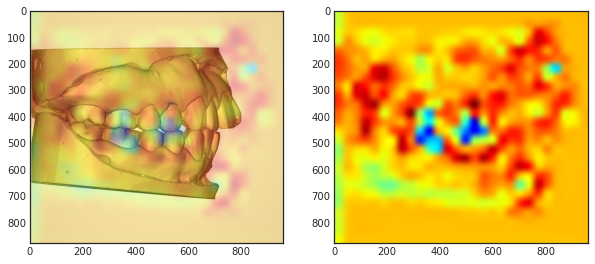

 45%|████▍     | 176/392 [03:15<03:48,  1.06s/it]

176 _label =  -1.0    predict =  -1 , pred =  [0.0747 0.     0.9252]


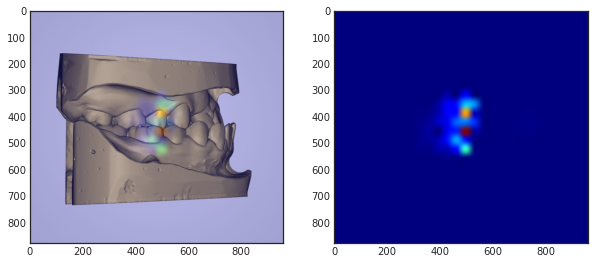

 45%|████▌     | 177/392 [03:16<03:45,  1.05s/it]

177 _label =  1.0    predict =  0 , pred =  [0.5789 0.0032 0.4179]


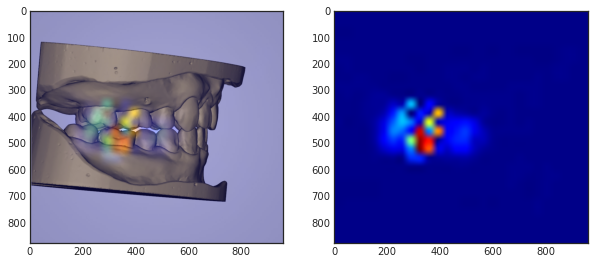

 45%|████▌     | 178/392 [03:17<03:42,  1.04s/it]

178 _label =  0.0    predict =  0 , pred =  [0.8735 0.0775 0.049 ]


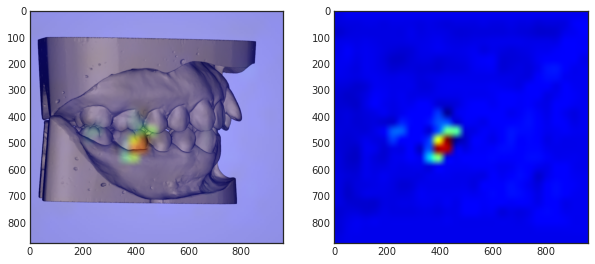

 46%|████▌     | 179/392 [03:18<03:45,  1.06s/it]

179 _label =  0.0    predict =  0 , pred =  [0.8736 0.0772 0.0492]


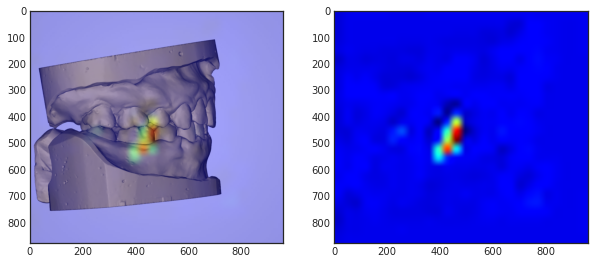

 46%|████▌     | 180/392 [03:19<03:52,  1.10s/it]

180 _label =  0.0    predict =  0 , pred =  [0.8731 0.0786 0.0483]


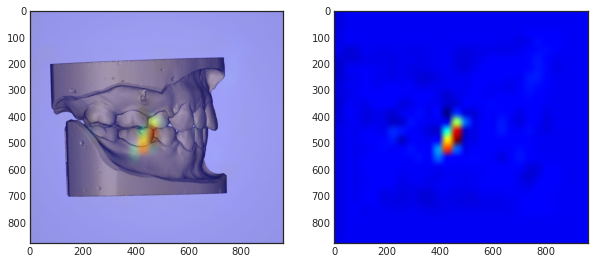

 46%|████▌     | 181/392 [03:20<03:46,  1.07s/it]

181 _label =  -1.0    predict =  -1 , pred =  [0.0746 0.     0.9254]


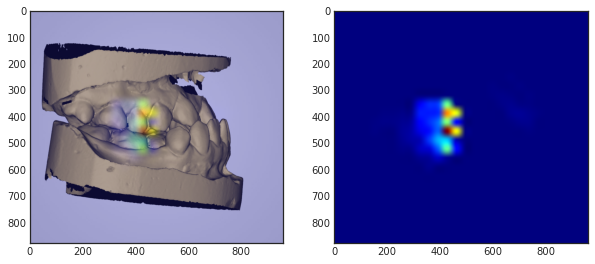

 46%|████▋     | 182/392 [03:21<03:42,  1.06s/it]

182 _label =  -1.0    predict =  0 , pred =  [0.8604 0.0318 0.1077]


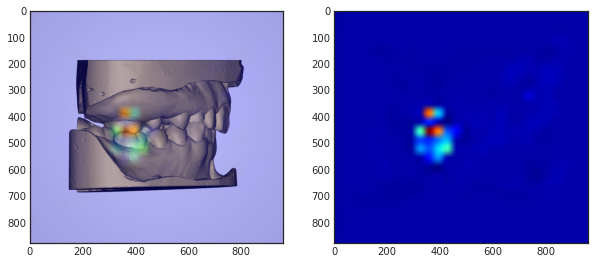

 47%|████▋     | 183/392 [03:22<03:39,  1.05s/it]

183 _label =  -1.0    predict =  -1 , pred =  [0.0717 0.     0.9283]


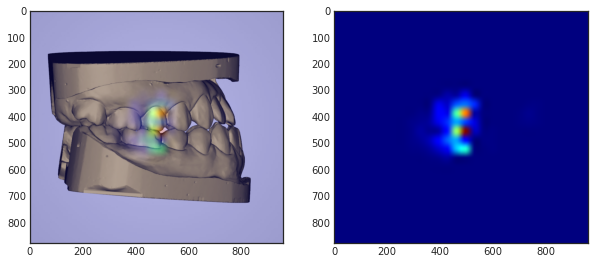

 47%|████▋     | 184/392 [03:23<03:36,  1.04s/it]

184 _label =  1.0    predict =  1 , pred =  [0.0578 0.9422 0.    ]


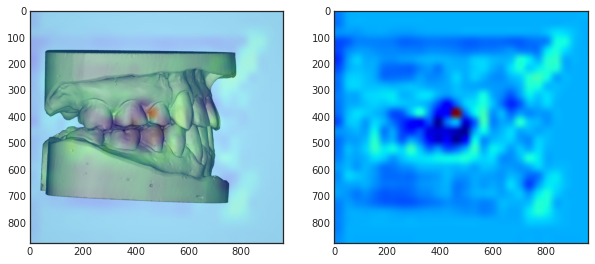

 47%|████▋     | 185/392 [03:24<03:34,  1.04s/it]

185 _label =  0.0    predict =  1 , pred =  [0.0413 0.9587 0.    ]


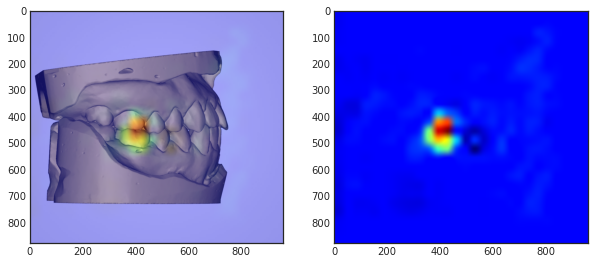

 47%|████▋     | 186/392 [03:25<03:33,  1.03s/it]

186 _label =  1.0    predict =  1 , pred =  [0.0335 0.9665 0.    ]


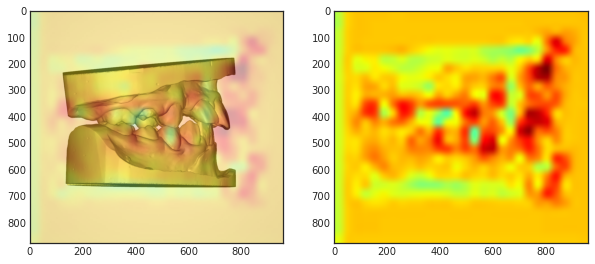

 48%|████▊     | 187/392 [03:26<03:31,  1.03s/it]

187 _label =  1.0    predict =  1 , pred =  [0.0539 0.9461 0.    ]


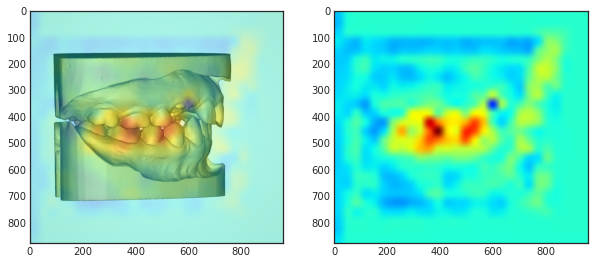

 48%|████▊     | 188/392 [03:27<03:32,  1.04s/it]

188 _label =  1.0    predict =  1 , pred =  [0.0382 0.9618 0.    ]


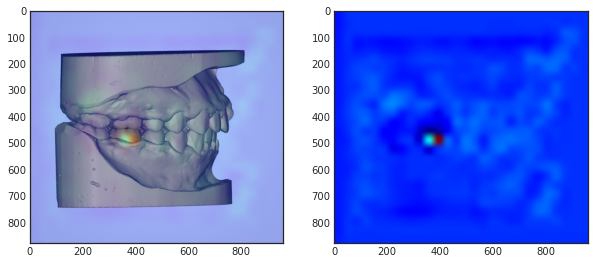

 48%|████▊     | 189/392 [03:29<04:01,  1.19s/it]

189 _label =  1.0    predict =  0 , pred =  [0.8476 0.0259 0.1265]


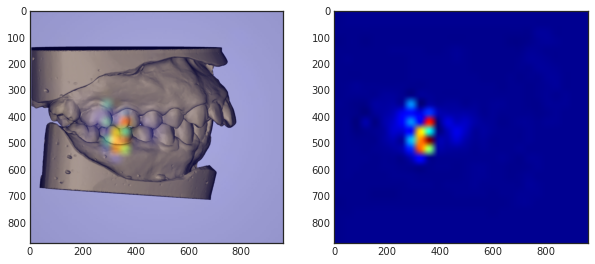

 48%|████▊     | 190/392 [03:30<03:50,  1.14s/it]

190 _label =  0.0    predict =  0 , pred =  [0.802  0.0155 0.1826]


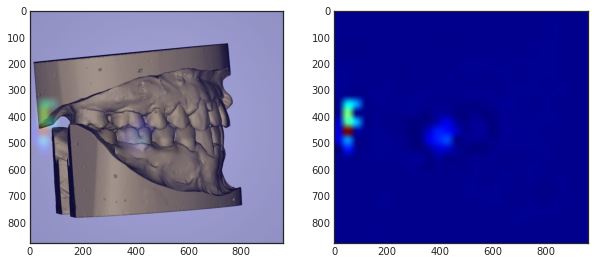

 49%|████▊     | 191/392 [03:31<03:43,  1.11s/it]

191 _label =  0.0    predict =  -1 , pred =  [0.0917 0.     0.9083]


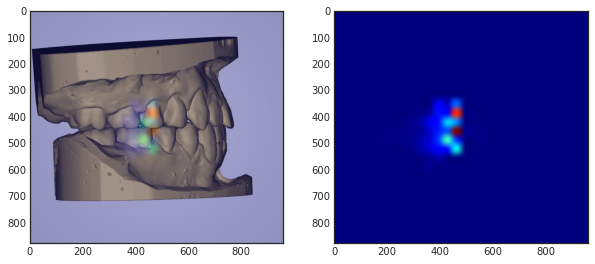

 49%|████▉     | 192/392 [03:32<03:37,  1.09s/it]

192 _label =  -1.0    predict =  -1 , pred =  [0.0832 0.     0.9168]


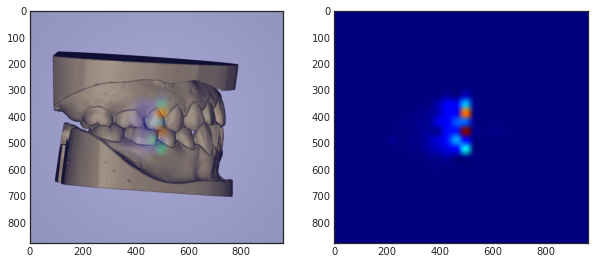

 49%|████▉     | 193/392 [03:33<03:32,  1.07s/it]

193 _label =  1.0    predict =  1 , pred =  [0.0437 0.9563 0.    ]


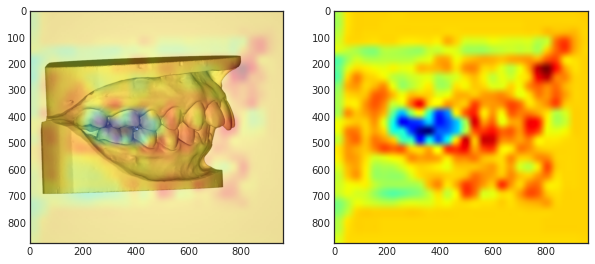

 49%|████▉     | 194/392 [03:34<03:30,  1.06s/it]

194 _label =  0.0    predict =  0 , pred =  [0.871  0.0834 0.0455]


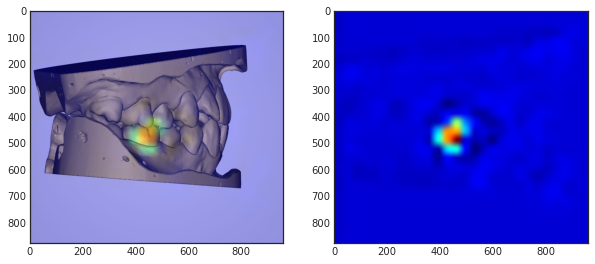

 50%|████▉     | 195/392 [03:35<03:27,  1.06s/it]

195 _label =  0.0    predict =  0 , pred =  [0.87   0.0857 0.0443]


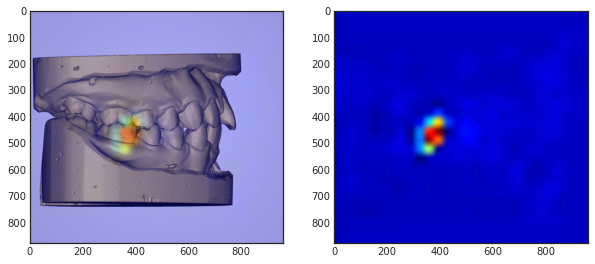

 50%|█████     | 196/392 [03:36<03:25,  1.05s/it]

196 _label =  -1.0    predict =  -1 , pred =  [0.0614 0.     0.9386]


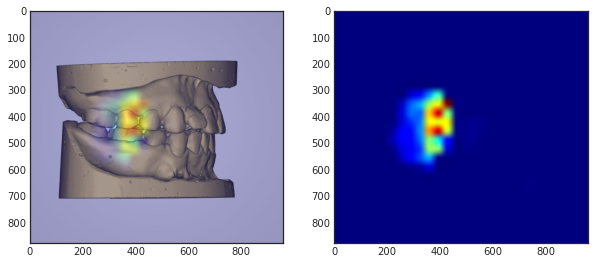

 50%|█████     | 197/392 [03:37<03:22,  1.04s/it]

197 _label =  0.0    predict =  0 , pred =  [0.8573 0.1077 0.0349]


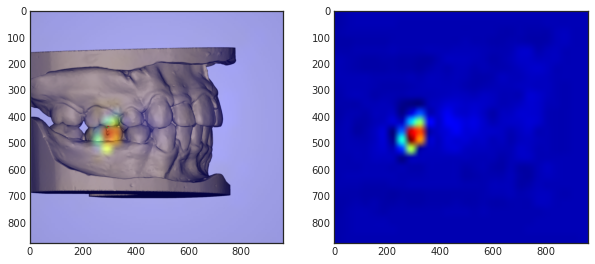

 51%|█████     | 198/392 [03:38<03:21,  1.04s/it]

198 _label =  1.0    predict =  0 , pred =  [0.8237 0.1528 0.0235]


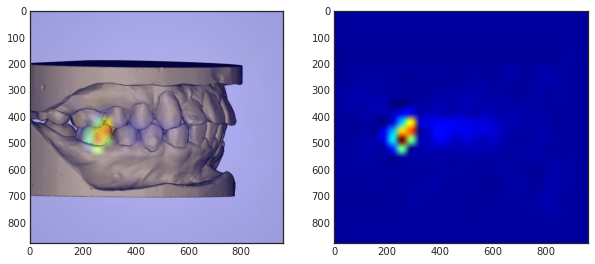

 51%|█████     | 199/392 [03:39<03:18,  1.03s/it]

199 _label =  -1.0    predict =  0 , pred =  [0.8772 0.0635 0.0593]


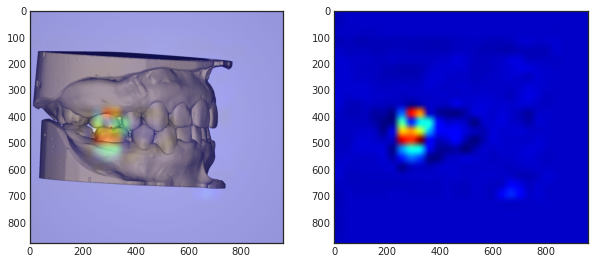

 51%|█████     | 200/392 [03:40<03:17,  1.03s/it]

200 _label =  -1.0    predict =  -1 , pred =  [0.0802 0.     0.9198]


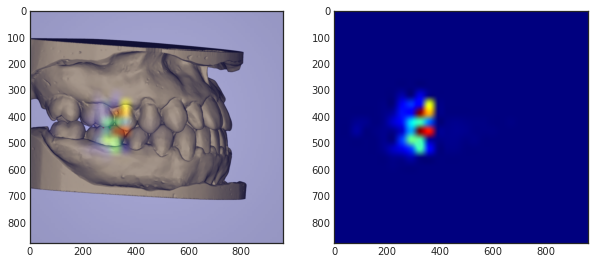

 51%|█████▏    | 201/392 [03:41<03:17,  1.04s/it]

201 _label =  -1.0    predict =  -1 , pred =  [0.0934 0.     0.9066]


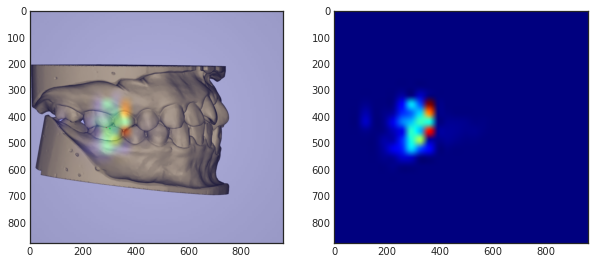

 52%|█████▏    | 202/392 [03:42<03:16,  1.03s/it]

202 _label =  0.0    predict =  0 , pred =  [0.876  0.0697 0.0543]


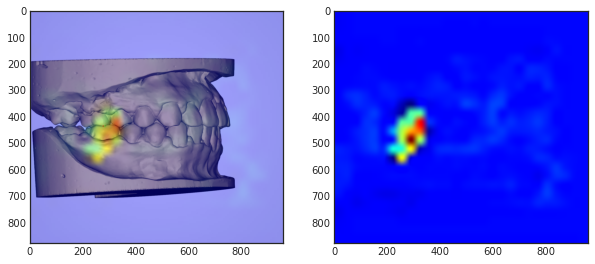

 52%|█████▏    | 203/392 [03:43<03:17,  1.05s/it]

203 _label =  0.0    predict =  0 , pred =  [0.8772 0.0636 0.0592]


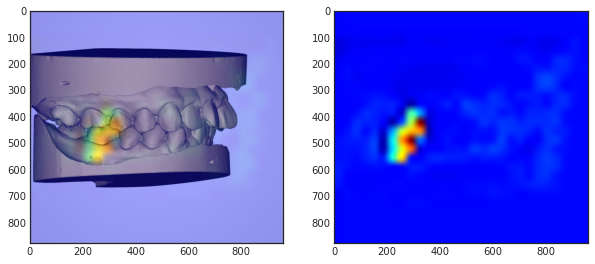

 52%|█████▏    | 204/392 [03:44<03:26,  1.10s/it]

204 _label =  -1.0    predict =  -1 , pred =  [0.1043 0.     0.8957]


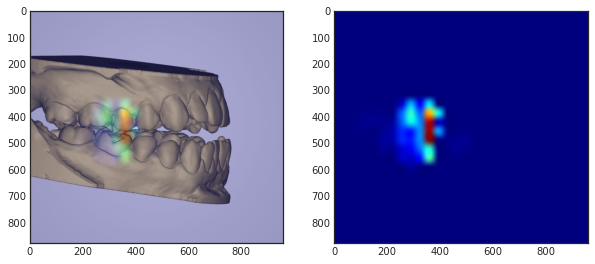

 52%|█████▏    | 205/392 [03:46<03:24,  1.09s/it]

205 _label =  -1.0    predict =  -1 , pred =  [0.0882 0.     0.9118]


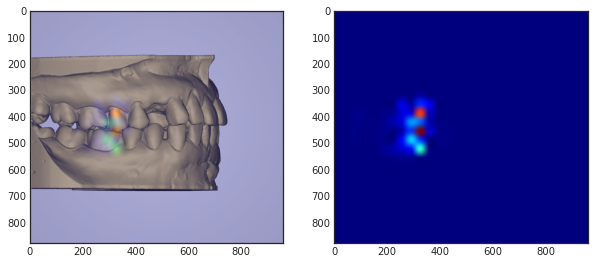

 53%|█████▎    | 206/392 [03:47<03:22,  1.09s/it]

206 _label =  -1.0    predict =  0 , pred =  [0.874  0.0762 0.0498]


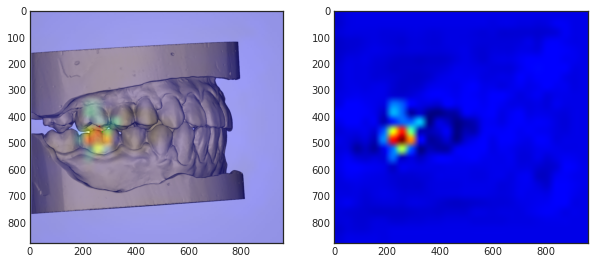

 53%|█████▎    | 207/392 [03:48<03:21,  1.09s/it]

207 _label =  1.0    predict =  1 , pred =  [0.0498 0.9502 0.    ]


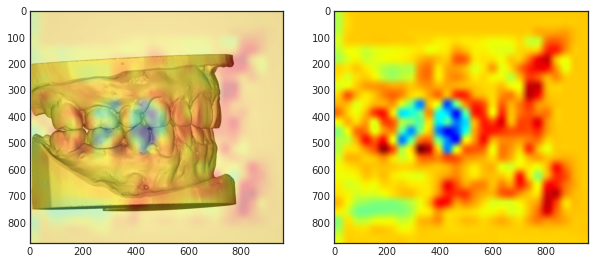

 53%|█████▎    | 208/392 [03:49<03:21,  1.09s/it]

208 _label =  1.0    predict =  1 , pred =  [0.0334 0.9666 0.    ]


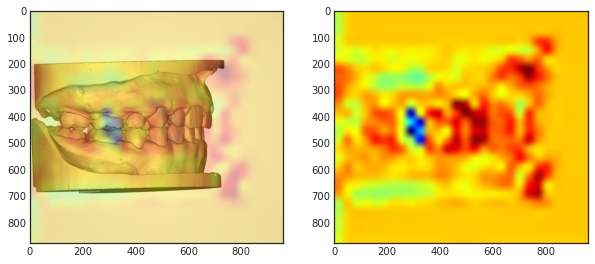

 53%|█████▎    | 209/392 [03:50<03:25,  1.12s/it]

209 _label =  -1.0    predict =  -1 , pred =  [0.0911 0.     0.9089]


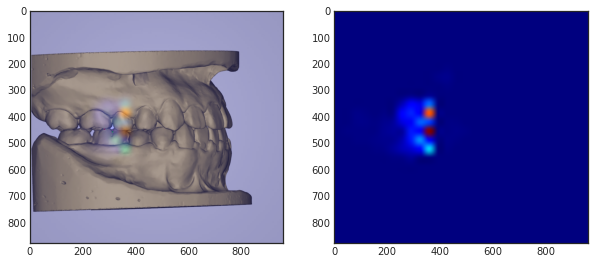

 54%|█████▎    | 210/392 [03:51<03:22,  1.11s/it]

210 _label =  1.0    predict =  1 , pred =  [0.0481 0.9519 0.    ]


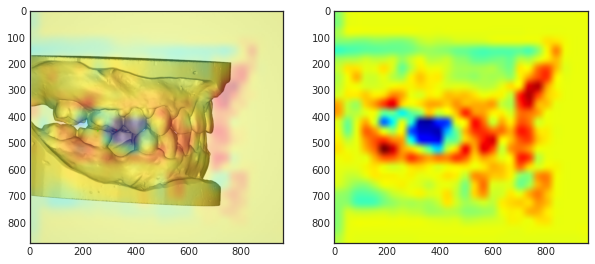

 54%|█████▍    | 211/392 [03:53<03:44,  1.24s/it]

211 _label =  -1.0    predict =  -1 , pred =  [1.795e-01 1.000e-04 8.203e-01]


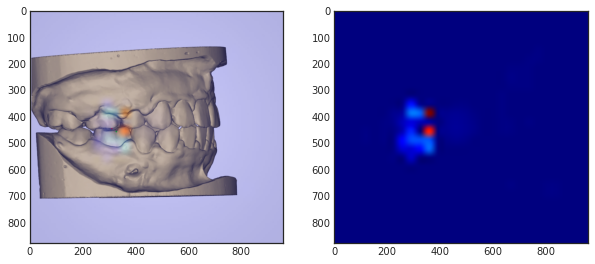

 54%|█████▍    | 212/392 [03:54<03:35,  1.20s/it]

212 _label =  -1.0    predict =  -1 , pred =  [0.0775 0.     0.9225]


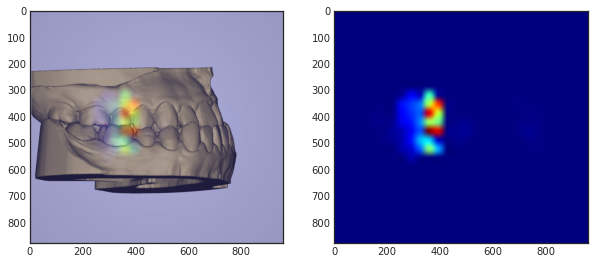

 54%|█████▍    | 213/392 [03:55<03:29,  1.17s/it]

213 _label =  0.0    predict =  0 , pred =  [0.8688 0.0881 0.0431]


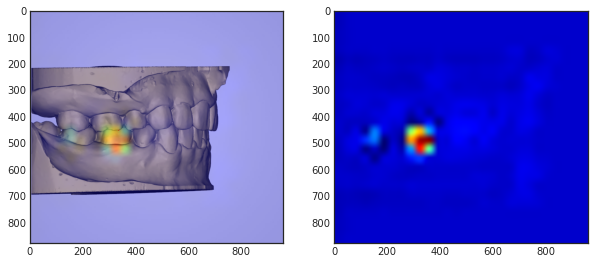

 55%|█████▍    | 214/392 [03:56<03:23,  1.15s/it]

214 _label =  1.0    predict =  1 , pred =  [0.012 0.988 0.   ]


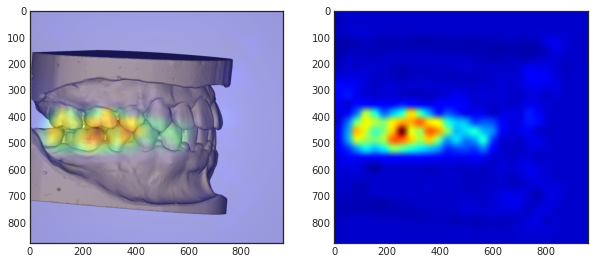

 55%|█████▍    | 215/392 [03:57<03:19,  1.12s/it]

215 _label =  0.0    predict =  0 , pred =  [0.872  0.0812 0.0468]


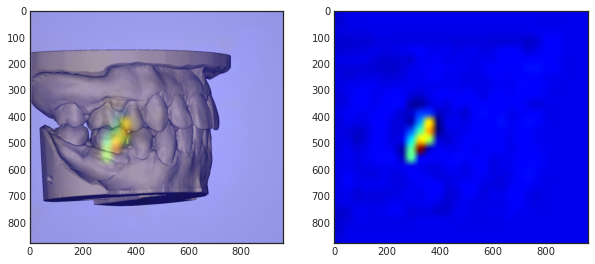

 55%|█████▌    | 216/392 [03:58<03:16,  1.12s/it]

216 _label =  0.0    predict =  0 , pred =  [0.8745 0.0746 0.0508]


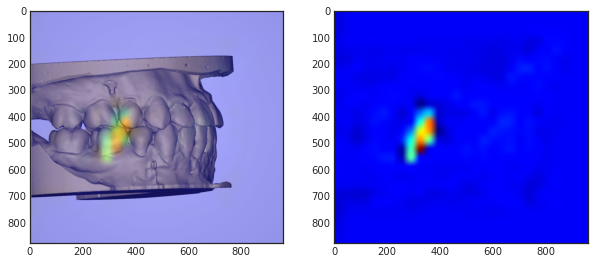

 55%|█████▌    | 217/392 [03:59<03:26,  1.18s/it]

217 _label =  0.0    predict =  0 , pred =  [0.8751 0.0728 0.0521]


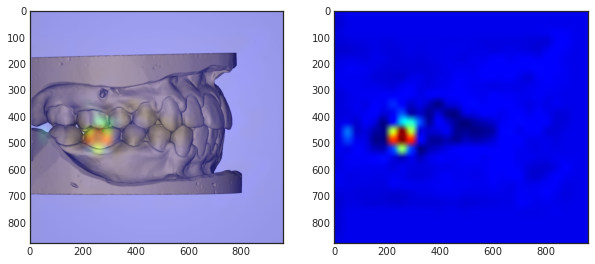

 56%|█████▌    | 218/392 [04:01<03:23,  1.17s/it]

218 _label =  0.0    predict =  0 , pred =  [0.8728 0.0794 0.0479]


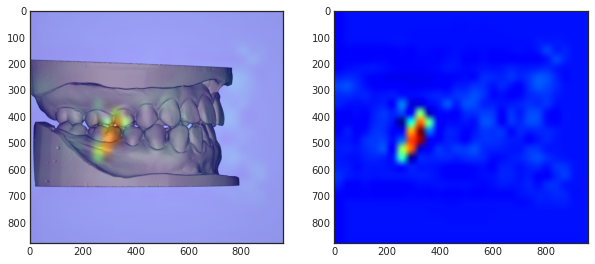

 56%|█████▌    | 219/392 [04:02<03:15,  1.13s/it]

219 _label =  0.0    predict =  0 , pred =  [0.8179 0.1599 0.0222]


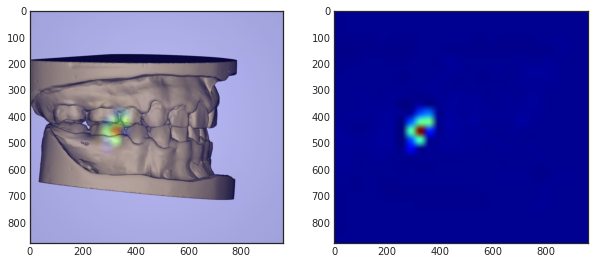

 56%|█████▌    | 220/392 [04:03<03:17,  1.15s/it]

220 _label =  0.0    predict =  0 , pred =  [0.8765 0.0675 0.056 ]


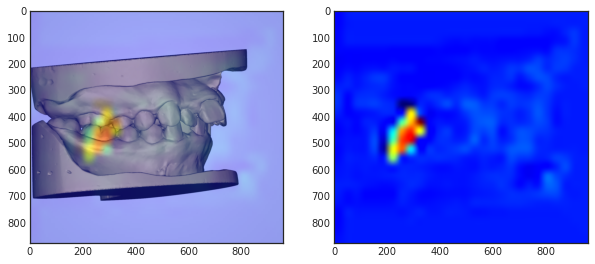

 56%|█████▋    | 221/392 [04:04<03:10,  1.11s/it]

221 _label =  1.0    predict =  1 , pred =  [0.0339 0.9661 0.    ]


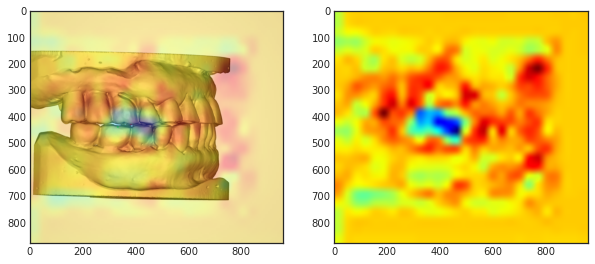

 57%|█████▋    | 222/392 [04:05<03:15,  1.15s/it]

222 _label =  0.0    predict =  -1 , pred =  [0.0914 0.     0.9086]


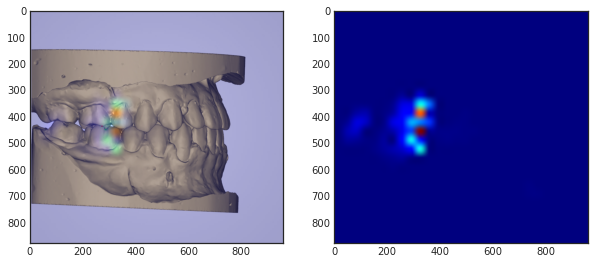

 57%|█████▋    | 223/392 [04:06<03:10,  1.13s/it]

223 _label =  0.0    predict =  0 , pred =  [0.8601 0.1034 0.0365]


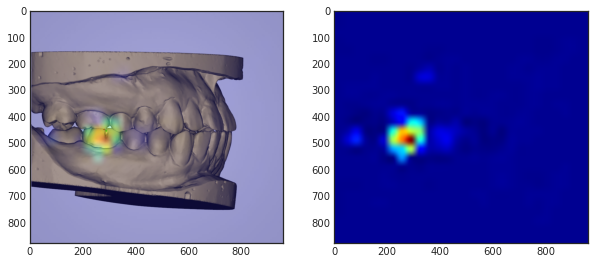

 57%|█████▋    | 224/392 [04:07<03:06,  1.11s/it]

224 _label =  1.0    predict =  1 , pred =  [0.0654 0.9346 0.    ]


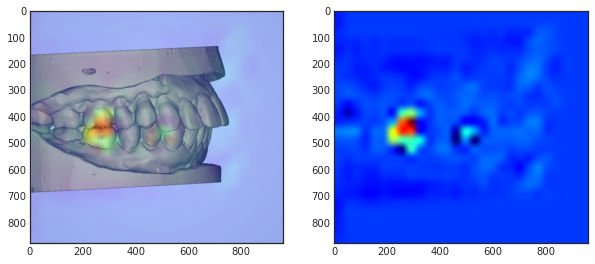

 57%|█████▋    | 225/392 [04:08<03:01,  1.09s/it]

225 _label =  -1.0    predict =  -1 , pred =  [0.0799 0.     0.9201]


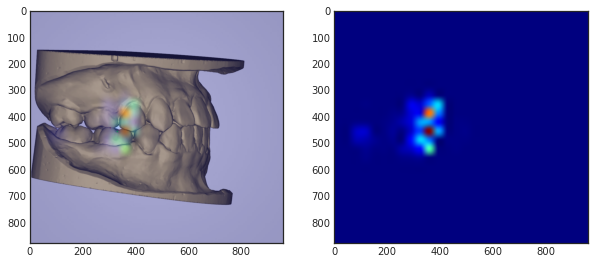

 58%|█████▊    | 226/392 [04:09<02:57,  1.07s/it]

226 _label =  1.0    predict =  0 , pred =  [0.8367 0.1365 0.0268]


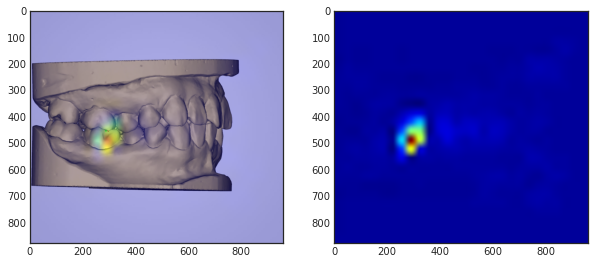

 58%|█████▊    | 227/392 [04:10<02:53,  1.05s/it]

227 _label =  0.0    predict =  -1 , pred =  [0.1124 0.     0.8875]


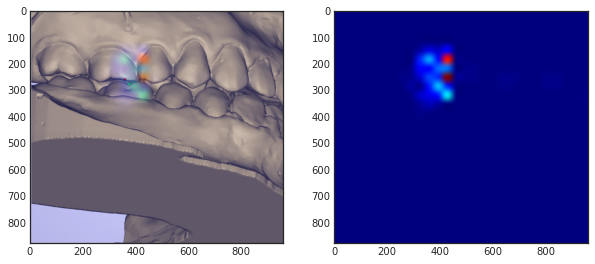

 58%|█████▊    | 228/392 [04:11<02:52,  1.05s/it]

228 _label =  0.0    predict =  0 , pred =  [0.8739 0.0764 0.0497]


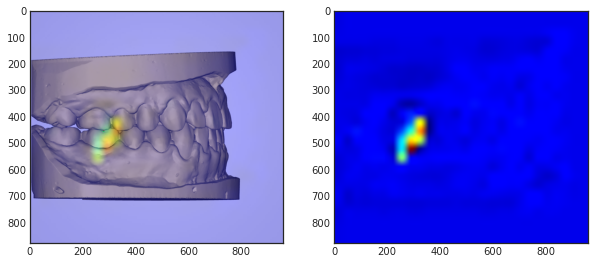

 58%|█████▊    | 229/392 [04:12<02:50,  1.05s/it]

229 _label =  0.0    predict =  0 , pred =  [0.8707 0.0842 0.0451]


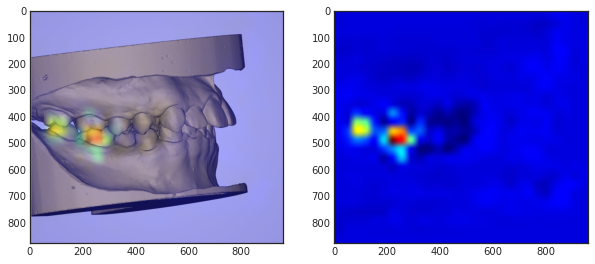

 59%|█████▊    | 230/392 [04:13<02:48,  1.04s/it]

230 _label =  0.0    predict =  0 , pred =  [0.8771 0.0644 0.0586]


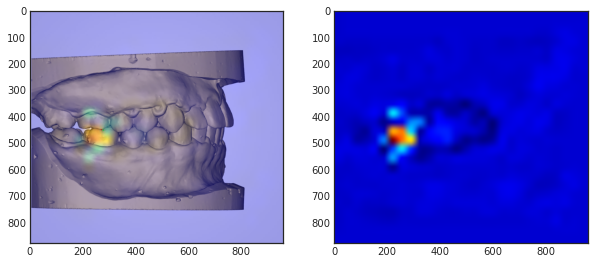

 59%|█████▉    | 231/392 [04:14<02:47,  1.04s/it]

231 _label =  1.0    predict =  1 , pred =  [0.0436 0.9564 0.    ]


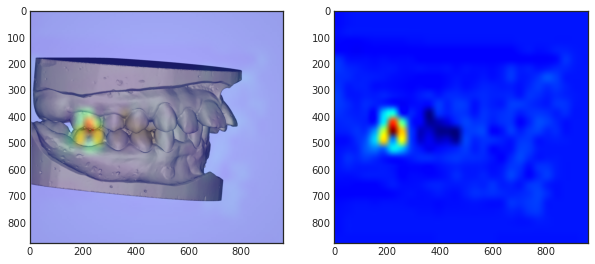

 59%|█████▉    | 232/392 [04:15<02:48,  1.05s/it]

232 _label =  0.0    predict =  0 , pred =  [0.8753 0.072  0.0526]


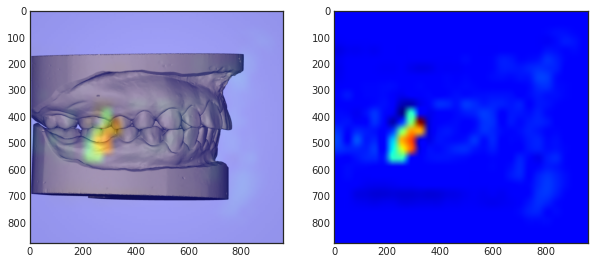

 59%|█████▉    | 233/392 [04:17<03:09,  1.19s/it]

233 _label =  1.0    predict =  1 , pred =  [0.0373 0.9627 0.    ]


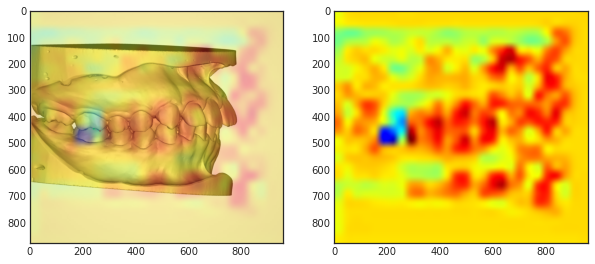

 60%|█████▉    | 234/392 [04:18<03:01,  1.15s/it]

234 _label =  0.0    predict =  0 , pred =  [0.8648 0.0955 0.0397]


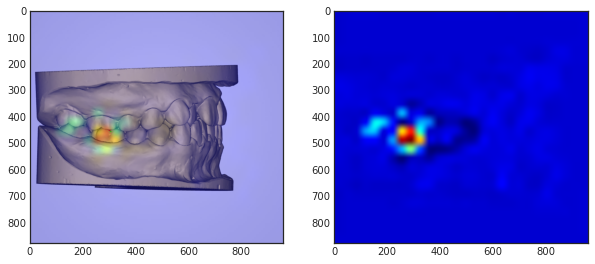

 60%|█████▉    | 235/392 [04:19<02:54,  1.11s/it]

235 _label =  0.0    predict =  -1 , pred =  [0.0991 0.     0.9009]


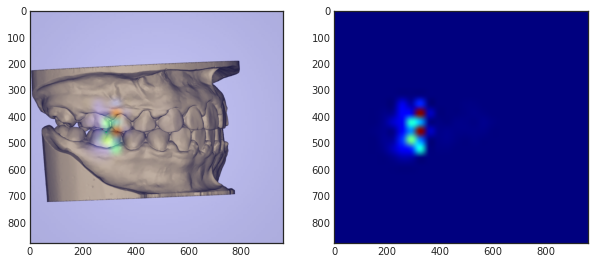

 60%|██████    | 236/392 [04:20<02:51,  1.10s/it]

236 _label =  0.0    predict =  0 , pred =  [0.8739 0.0766 0.0496]


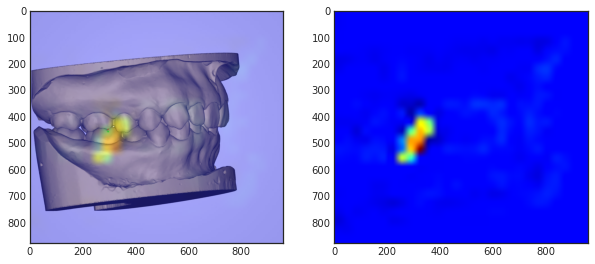

 60%|██████    | 237/392 [04:21<02:56,  1.14s/it]

237 _label =  -1.0    predict =  -1 , pred =  [1.272e-01 1.000e-04 8.727e-01]


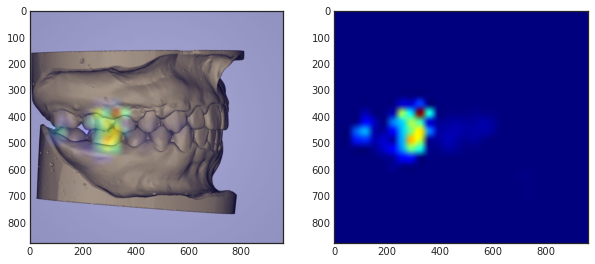

 61%|██████    | 238/392 [04:22<02:50,  1.11s/it]

238 _label =  0.0    predict =  -1 , pred =  [0.1028 0.     0.8972]


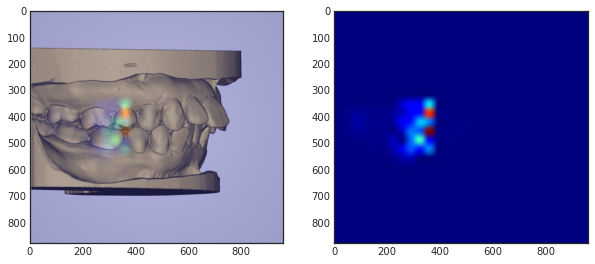

 61%|██████    | 239/392 [04:23<02:45,  1.08s/it]

239 _label =  0.0    predict =  0 , pred =  [0.8659 0.0935 0.0406]


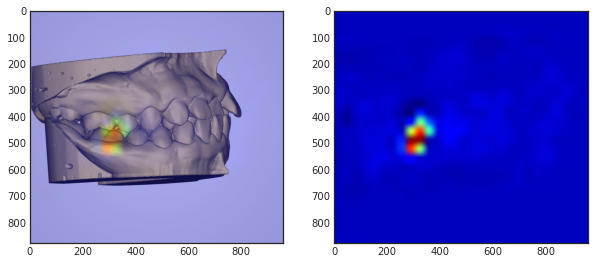

 61%|██████    | 240/392 [04:24<02:42,  1.07s/it]

240 _label =  -1.0    predict =  -1 , pred =  [0.0354 0.     0.9646]


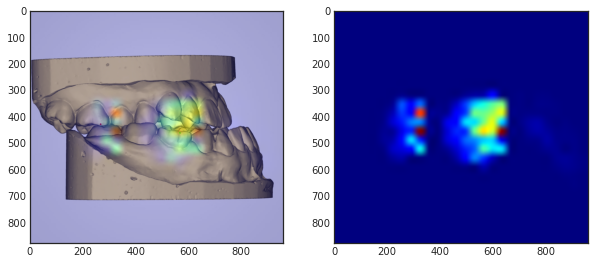

 61%|██████▏   | 241/392 [04:26<02:40,  1.06s/it]

241 _label =  -1.0    predict =  -1 , pred =  [0.0908 0.     0.9091]


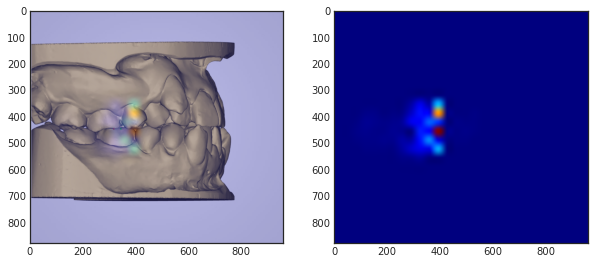

 62%|██████▏   | 242/392 [04:27<02:37,  1.05s/it]

242 _label =  0.0    predict =  0 , pred =  [0.8645 0.0961 0.0394]


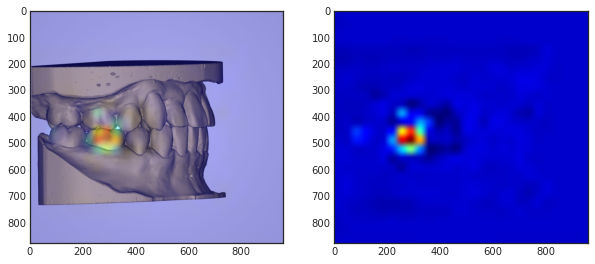

 62%|██████▏   | 243/392 [04:28<02:37,  1.06s/it]

243 _label =  0.0    predict =  0 , pred =  [0.8724 0.0803 0.0473]


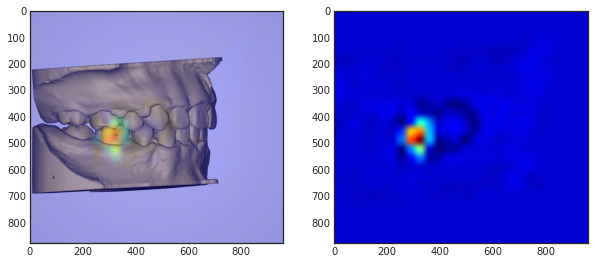

 62%|██████▏   | 244/392 [04:29<02:37,  1.06s/it]

244 _label =  0.0    predict =  0 , pred =  [0.8713 0.0827 0.0459]


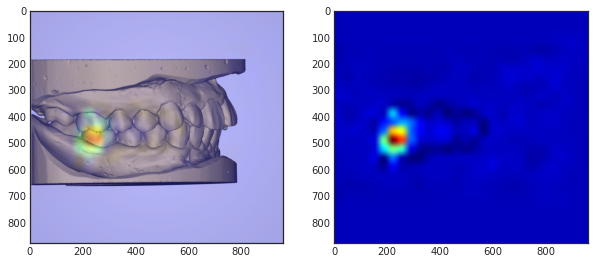

 62%|██████▎   | 245/392 [04:30<02:36,  1.07s/it]

245 _label =  0.0    predict =  0 , pred =  [0.8713 0.0828 0.0459]


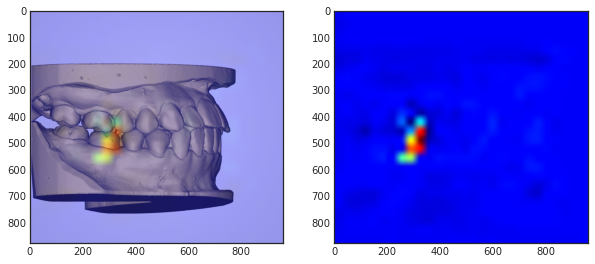

 63%|██████▎   | 246/392 [04:31<02:39,  1.09s/it]

246 _label =  -1.0    predict =  -1 , pred =  [0.1014 0.     0.8986]


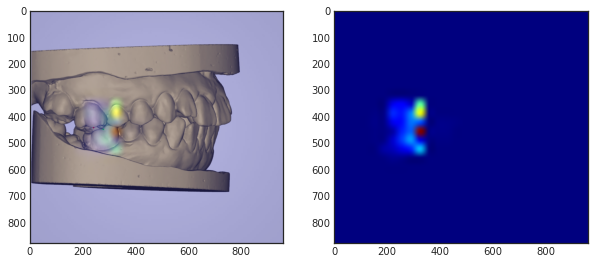

 63%|██████▎   | 247/392 [04:32<02:37,  1.08s/it]

247 _label =  1.0    predict =  1 , pred =  [0.0693 0.9306 0.    ]


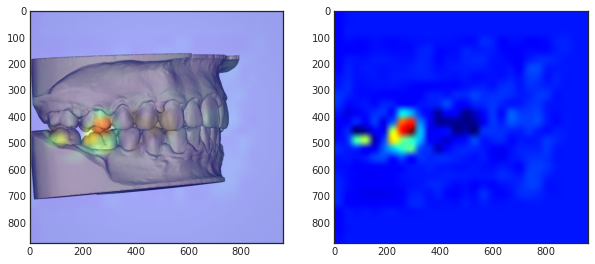

 63%|██████▎   | 248/392 [04:33<02:41,  1.12s/it]

248 _label =  0.0    predict =  0 , pred =  [0.8753 0.0723 0.0524]


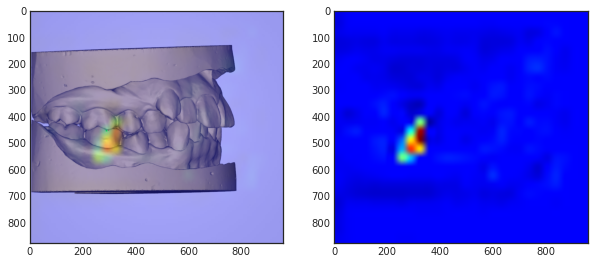

 64%|██████▎   | 249/392 [04:34<02:37,  1.10s/it]

249 _label =  0.0    predict =  -1 , pred =  [0.087 0.    0.913]


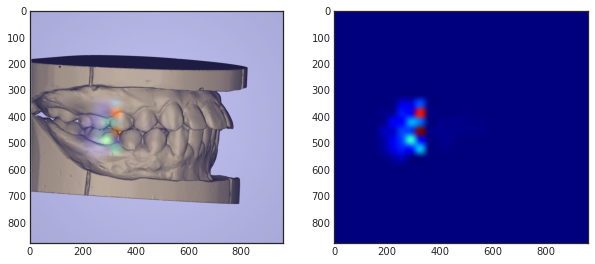

 64%|██████▍   | 250/392 [04:35<02:39,  1.13s/it]

250 _label =  0.0    predict =  0 , pred =  [0.8729 0.079  0.0481]


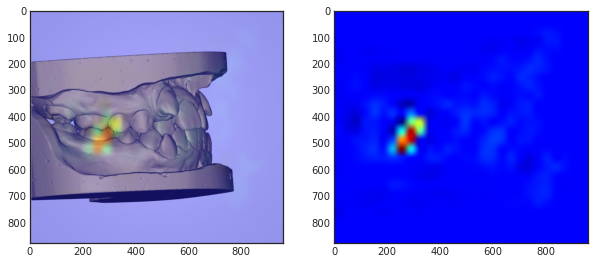

 64%|██████▍   | 251/392 [04:37<02:44,  1.17s/it]

251 _label =  0.0    predict =  0 , pred =  [0.8702 0.0852 0.0446]


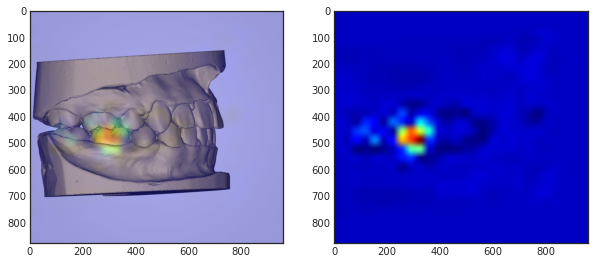

 64%|██████▍   | 252/392 [04:38<02:42,  1.16s/it]

252 _label =  0.0    predict =  0 , pred =  [0.8726 0.0797 0.0476]


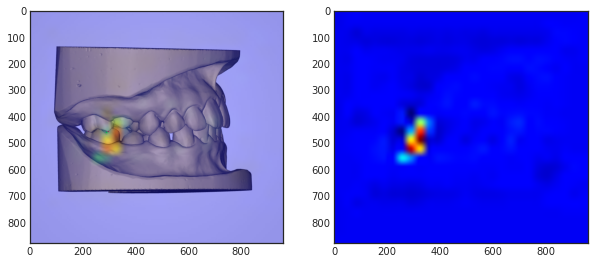

 65%|██████▍   | 253/392 [04:39<02:44,  1.18s/it]

253 _label =  0.0    predict =  0 , pred =  [0.8723 0.0805 0.0472]


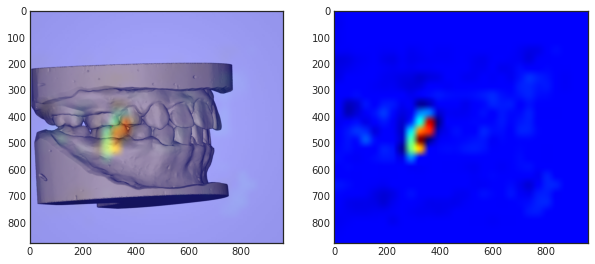

 65%|██████▍   | 254/392 [04:40<02:37,  1.14s/it]

254 _label =  0.0    predict =  0 , pred =  [0.8744 0.075  0.0506]


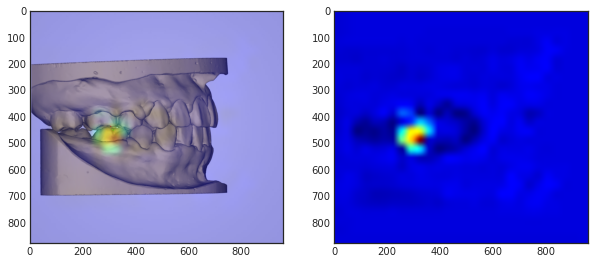

 65%|██████▌   | 255/392 [04:42<02:51,  1.26s/it]

255 _label =  1.0    predict =  1 , pred =  [0.0442 0.9558 0.    ]


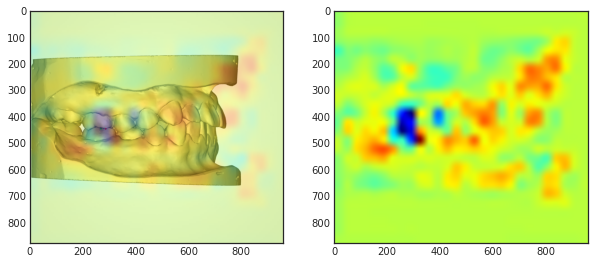

 65%|██████▌   | 256/392 [04:43<02:43,  1.20s/it]

256 _label =  0.0    predict =  0 , pred =  [0.8766 0.0669 0.0565]


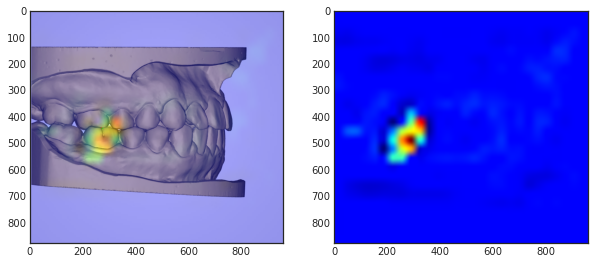

 66%|██████▌   | 257/392 [04:44<02:39,  1.18s/it]

257 _label =  1.0    predict =  1 , pred =  [0.0334 0.9666 0.    ]


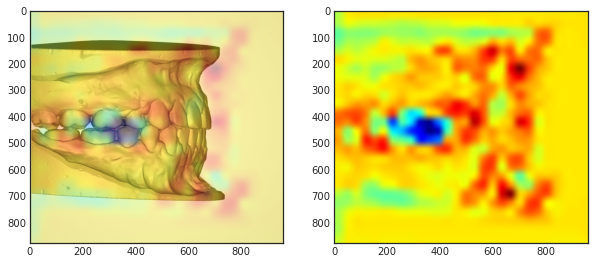

 66%|██████▌   | 258/392 [04:45<02:42,  1.22s/it]

258 _label =  0.0    predict =  0 , pred =  [0.874  0.0762 0.0498]


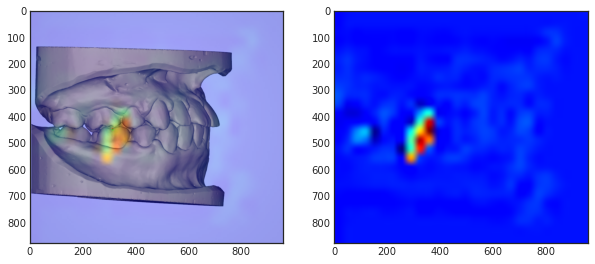

 66%|██████▌   | 259/392 [04:46<02:43,  1.23s/it]

259 _label =  1.0    predict =  1 , pred =  [2.061e-01 7.935e-01 4.000e-04]


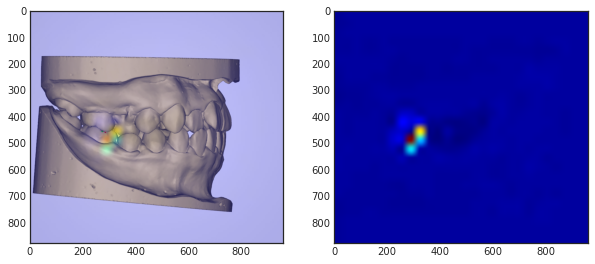

 66%|██████▋   | 260/392 [04:48<02:41,  1.22s/it]

260 _label =  1.0    predict =  1 , pred =  [0.0584 0.9415 0.    ]


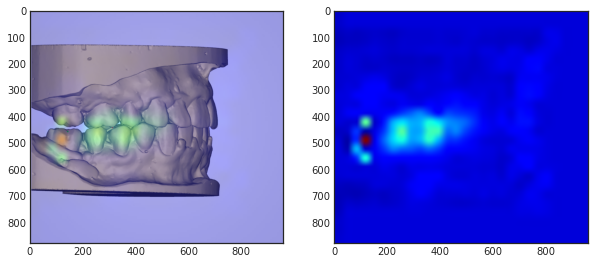

 67%|██████▋   | 261/392 [04:49<02:34,  1.18s/it]

261 _label =  1.0    predict =  1 , pred =  [0.0447 0.9553 0.    ]


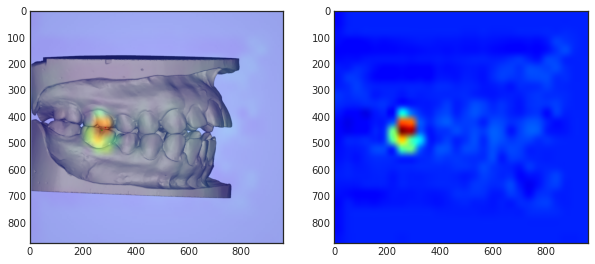

 67%|██████▋   | 262/392 [04:50<02:35,  1.20s/it]

262 _label =  1.0    predict =  1 , pred =  [0.0465 0.9535 0.    ]


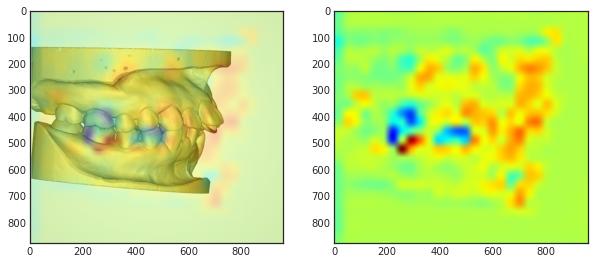

 67%|██████▋   | 263/392 [04:51<02:33,  1.19s/it]

263 _label =  0.0    predict =  0 , pred =  [0.8752 0.0726 0.0522]


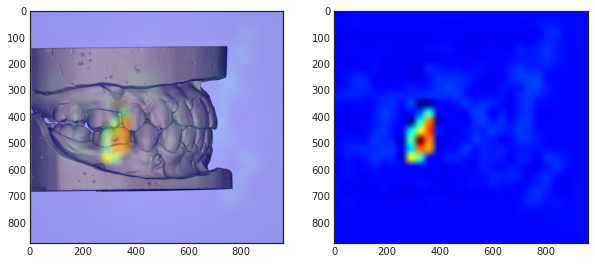

 67%|██████▋   | 264/392 [04:52<02:26,  1.14s/it]

264 _label =  0.0    predict =  0 , pred =  [0.8717 0.0818 0.0464]


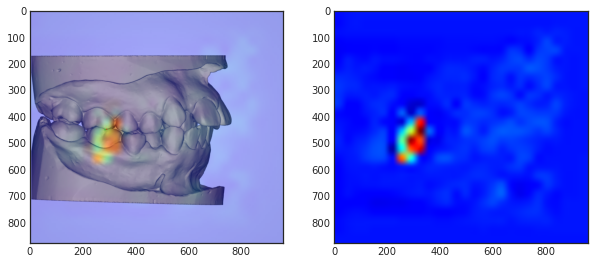

 68%|██████▊   | 265/392 [04:53<02:23,  1.13s/it]

265 _label =  1.0    predict =  1 , pred =  [0.0716 0.9283 0.    ]


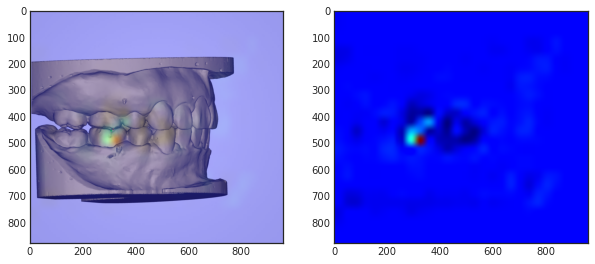

 68%|██████▊   | 266/392 [04:54<02:21,  1.12s/it]

266 _label =  0.0    predict =  0 , pred =  [0.8739 0.0763 0.0498]


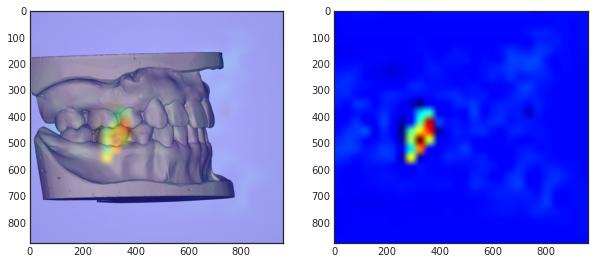

 68%|██████▊   | 267/392 [04:55<02:21,  1.13s/it]

267 _label =  0.0    predict =  0 , pred =  [0.87   0.0857 0.0443]


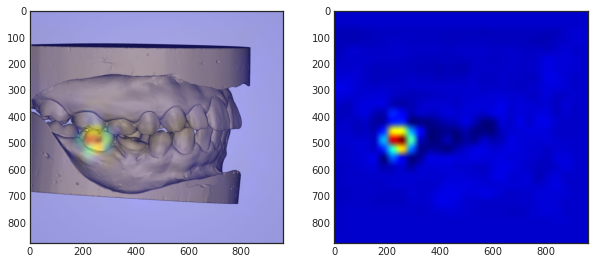

 68%|██████▊   | 268/392 [04:57<02:19,  1.13s/it]

268 _label =  0.0    predict =  -1 , pred =  [0.0914 0.     0.9086]


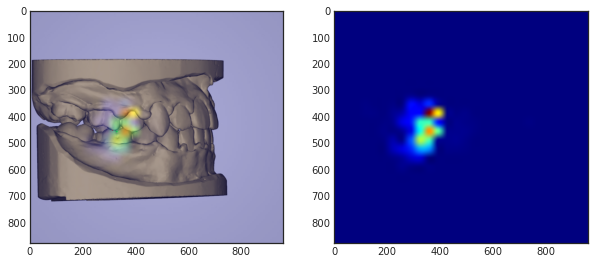

 69%|██████▊   | 269/392 [04:58<02:17,  1.12s/it]

269 _label =  -1.0    predict =  -1 , pred =  [0.0627 0.     0.9373]


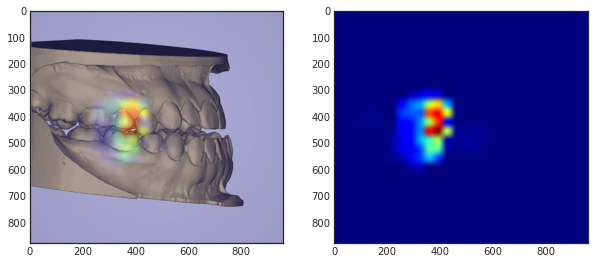

 69%|██████▉   | 270/392 [04:59<02:16,  1.12s/it]

270 _label =  -1.0    predict =  -1 , pred =  [0.0682 0.     0.9318]


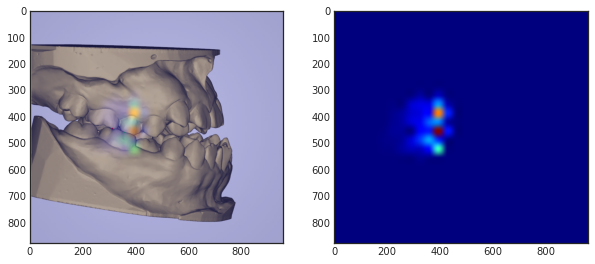

 69%|██████▉   | 271/392 [05:00<02:18,  1.14s/it]

271 _label =  0.0    predict =  0 , pred =  [0.8721 0.081  0.0469]


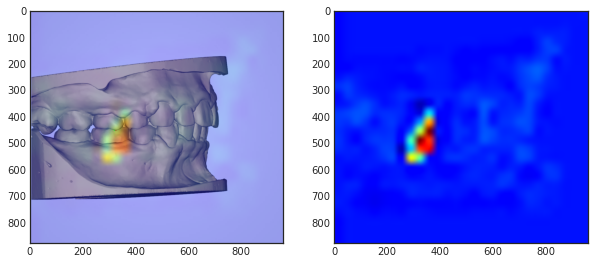

 69%|██████▉   | 272/392 [05:01<02:16,  1.14s/it]

272 _label =  0.0    predict =  0 , pred =  [0.8677 0.0903 0.0421]


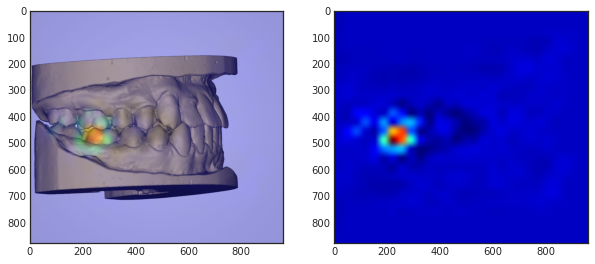

 70%|██████▉   | 273/392 [05:02<02:13,  1.12s/it]

273 _label =  -1.0    predict =  -1 , pred =  [0.0702 0.     0.9298]


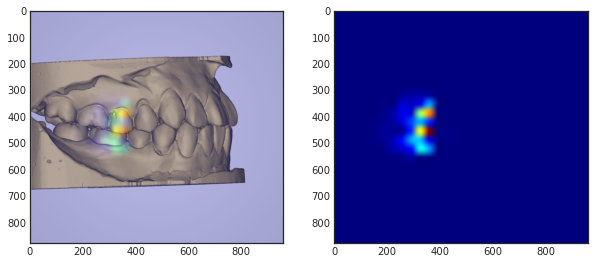

 70%|██████▉   | 274/392 [05:03<02:10,  1.10s/it]

274 _label =  1.0    predict =  1 , pred =  [0.0322 0.9678 0.    ]


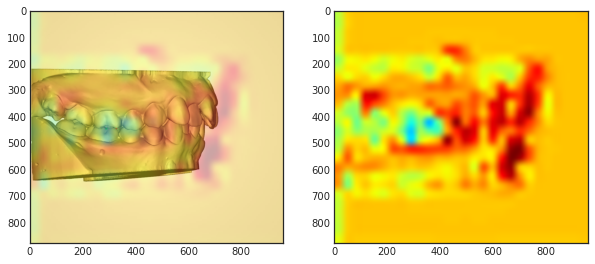

 70%|███████   | 275/392 [05:04<02:08,  1.10s/it]

275 _label =  1.0    predict =  1 , pred =  [0.4932 0.5039 0.0029]


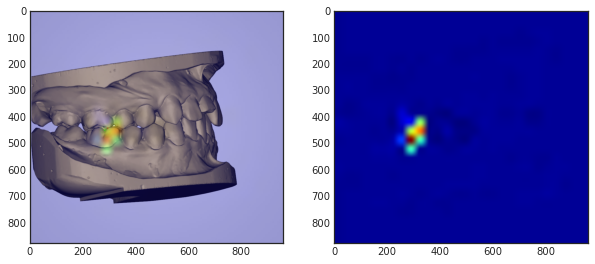

 70%|███████   | 276/392 [05:05<02:04,  1.08s/it]

276 _label =  1.0    predict =  1 , pred =  [0.0335 0.9665 0.    ]


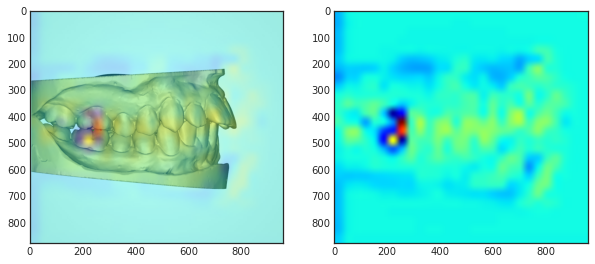

 71%|███████   | 277/392 [05:07<02:18,  1.20s/it]

277 _label =  -1.0    predict =  -1 , pred =  [0.045 0.    0.955]


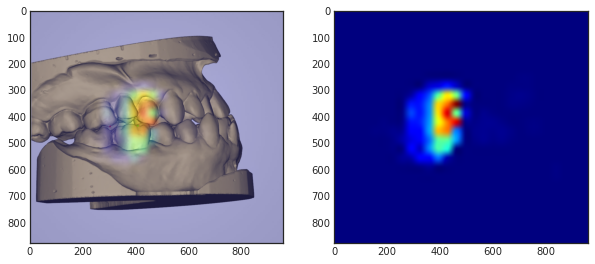

 71%|███████   | 278/392 [05:08<02:16,  1.20s/it]

278 _label =  0.0    predict =  0 , pred =  [0.8771 0.0645 0.0585]


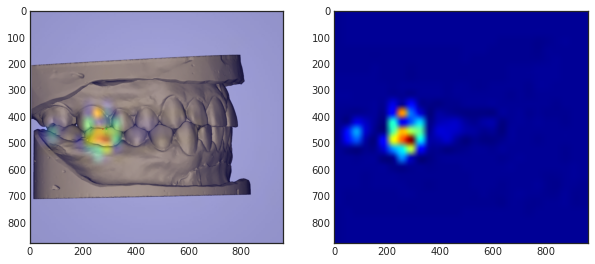

 71%|███████   | 279/392 [05:09<02:11,  1.16s/it]

279 _label =  0.0    predict =  0 , pred =  [0.873  0.0788 0.0482]


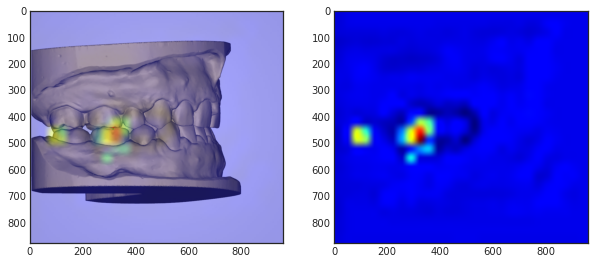

 71%|███████▏  | 280/392 [05:10<02:12,  1.18s/it]

280 _label =  -1.0    predict =  -1 , pred =  [0.0889 0.     0.9111]


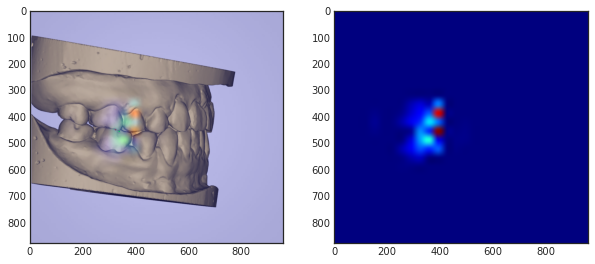

 72%|███████▏  | 281/392 [05:11<02:07,  1.15s/it]

281 _label =  0.0    predict =  1 , pred =  [0.0473 0.9526 0.    ]


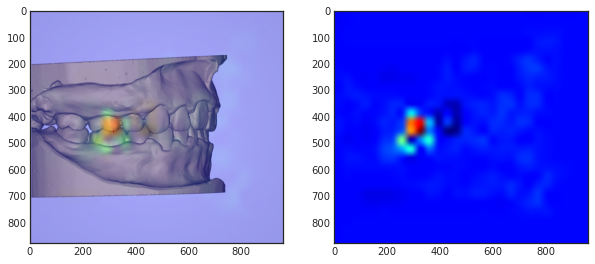

 72%|███████▏  | 282/392 [05:13<02:08,  1.17s/it]

282 _label =  -1.0    predict =  -1 , pred =  [0.0765 0.     0.9235]


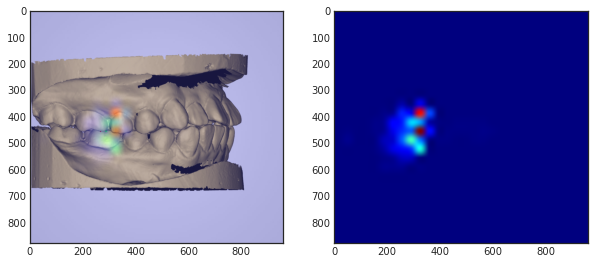

 72%|███████▏  | 283/392 [05:14<02:05,  1.15s/it]

283 _label =  0.0    predict =  0 , pred =  [0.8775 0.0595 0.063 ]


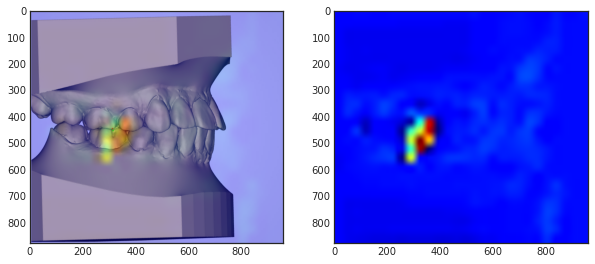

 72%|███████▏  | 284/392 [05:15<02:05,  1.16s/it]

284 _label =  0.0    predict =  0 , pred =  [0.873  0.0787 0.0482]


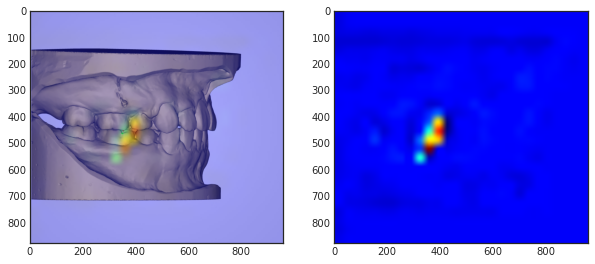

 73%|███████▎  | 285/392 [05:16<02:01,  1.13s/it]

285 _label =  -1.0    predict =  -1 , pred =  [0.0392 0.     0.9608]


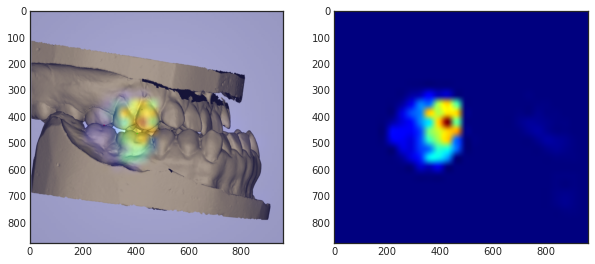

 73%|███████▎  | 286/392 [05:17<02:02,  1.16s/it]

286 _label =  0.0    predict =  0 , pred =  [0.8762 0.0687 0.0551]


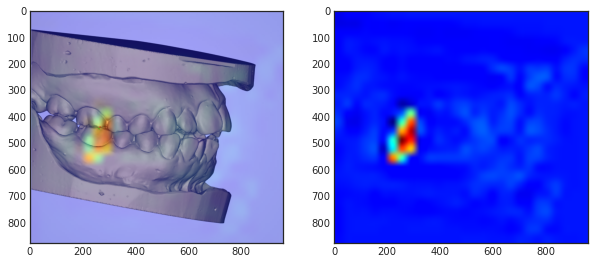

 73%|███████▎  | 287/392 [05:18<02:03,  1.17s/it]

287 _label =  -1.0    predict =  1 , pred =  [0.0415 0.9585 0.    ]


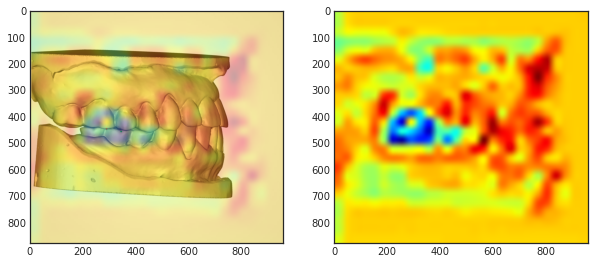

 73%|███████▎  | 288/392 [05:20<01:59,  1.15s/it]

288 _label =  1.0    predict =  1 , pred =  [0.0387 0.9613 0.    ]


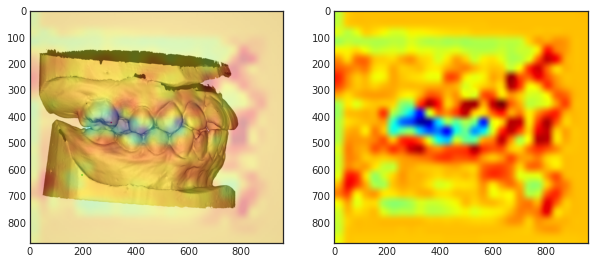

 74%|███████▎  | 289/392 [05:21<01:56,  1.13s/it]

289 _label =  -1.0    predict =  -1 , pred =  [0.067 0.    0.933]


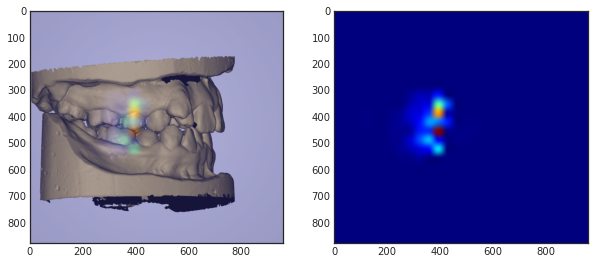

 74%|███████▍  | 290/392 [05:22<01:54,  1.12s/it]

290 _label =  -1.0    predict =  -1 , pred =  [0.0764 0.     0.9236]


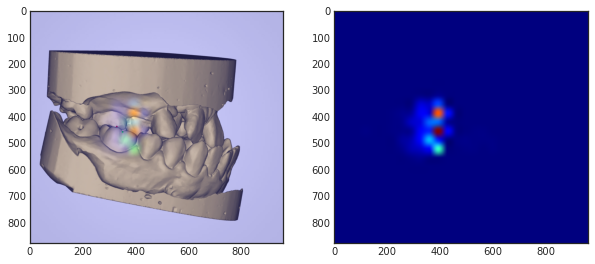

 74%|███████▍  | 291/392 [05:23<01:50,  1.10s/it]

291 _label =  1.0    predict =  1 , pred =  [0.042 0.958 0.   ]


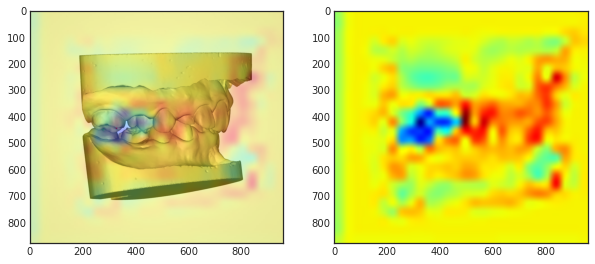

 74%|███████▍  | 292/392 [05:24<01:47,  1.08s/it]

292 _label =  -1.0    predict =  -1 , pred =  [0.0708 0.     0.9292]


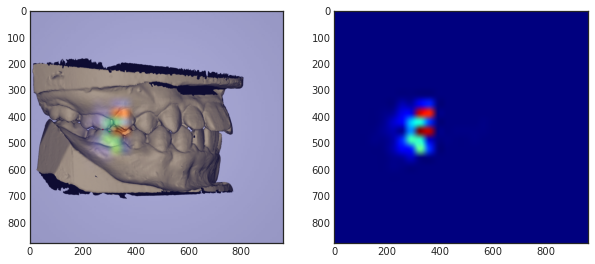

 75%|███████▍  | 293/392 [05:25<01:45,  1.06s/it]

293 _label =  -1.0    predict =  -1 , pred =  [0.0919 0.     0.9081]


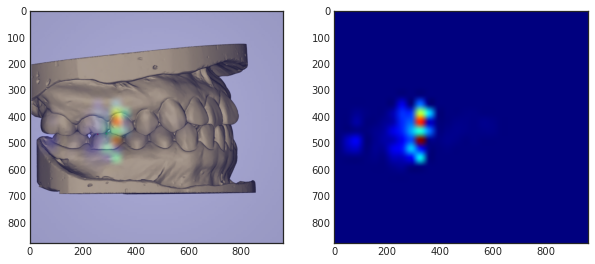

 75%|███████▌  | 294/392 [05:26<01:42,  1.05s/it]

294 _label =  0.0    predict =  0 , pred =  [0.8706 0.0844 0.045 ]


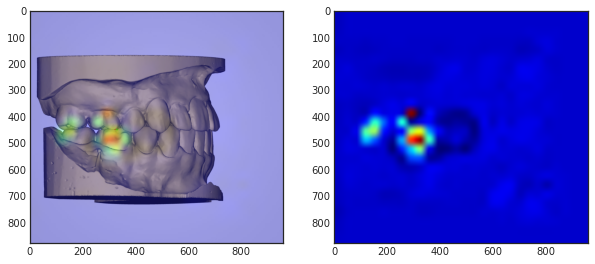

 75%|███████▌  | 295/392 [05:27<01:41,  1.05s/it]

295 _label =  -1.0    predict =  -1 , pred =  [0.0388 0.     0.9612]


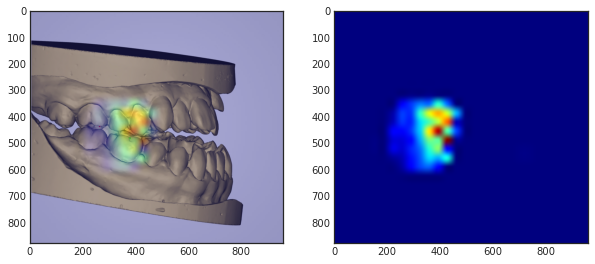

 76%|███████▌  | 296/392 [05:28<01:40,  1.04s/it]

296 _label =  1.0    predict =  1 , pred =  [0.0404 0.9596 0.    ]


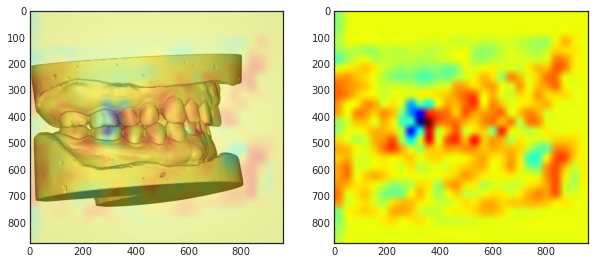

 76%|███████▌  | 297/392 [05:29<01:38,  1.04s/it]

297 _label =  -1.0    predict =  -1 , pred =  [0.0821 0.     0.9179]


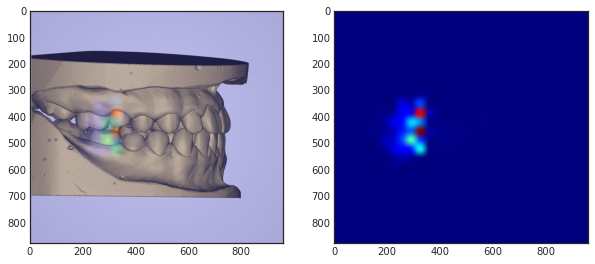

 76%|███████▌  | 298/392 [05:30<01:37,  1.04s/it]

298 _label =  0.0    predict =  0 , pred =  [0.873  0.0787 0.0483]


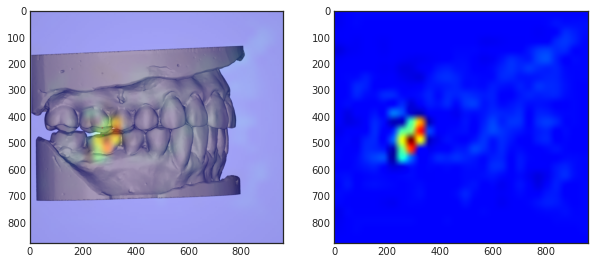

 76%|███████▋  | 299/392 [05:32<01:50,  1.19s/it]

299 _label =  1.0    predict =  1 , pred =  [0.0484 0.9516 0.    ]


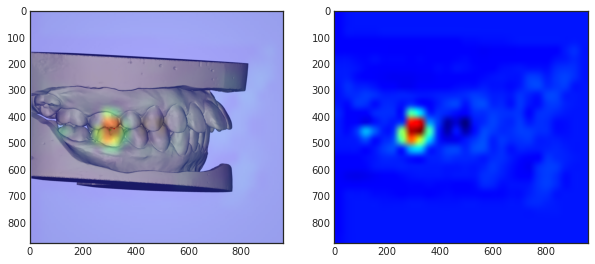

 77%|███████▋  | 300/392 [05:33<01:46,  1.15s/it]

300 _label =  0.0    predict =  0 , pred =  [0.8743 0.0752 0.0504]


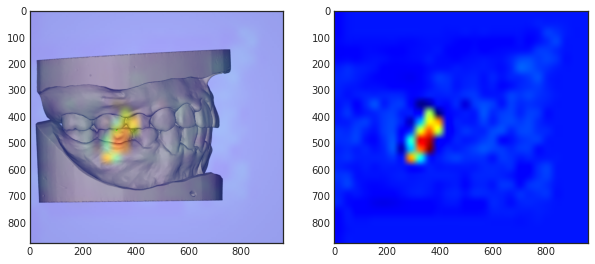

 77%|███████▋  | 301/392 [05:34<01:43,  1.14s/it]

301 _label =  0.0    predict =  0 , pred =  [0.8748 0.0737 0.0515]


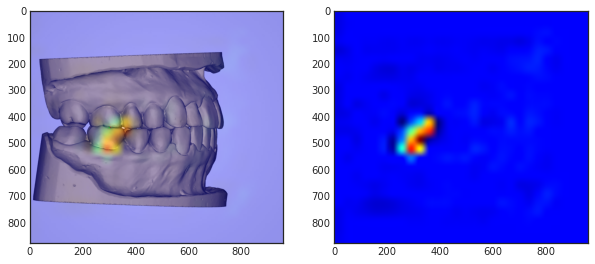

 77%|███████▋  | 302/392 [05:35<01:44,  1.16s/it]

302 _label =  1.0    predict =  0 , pred =  [0.513  0.4837 0.0033]


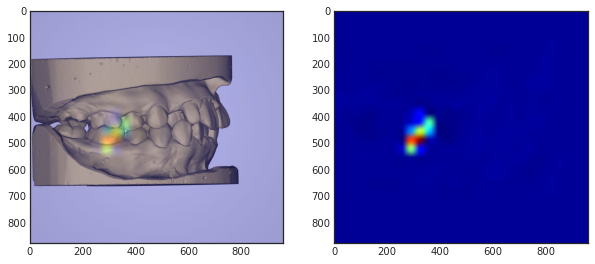

 77%|███████▋  | 303/392 [05:36<01:41,  1.14s/it]

303 _label =  -1.0    predict =  -1 , pred =  [0.0726 0.     0.9274]


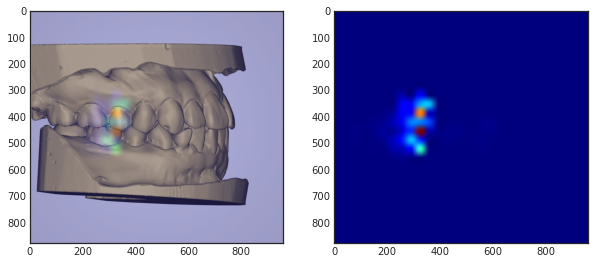

 78%|███████▊  | 304/392 [05:37<01:46,  1.21s/it]

304 _label =  1.0    predict =  1 , pred =  [0.055 0.945 0.   ]


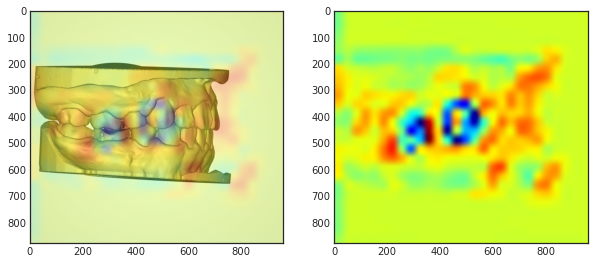

 78%|███████▊  | 305/392 [05:39<01:45,  1.21s/it]

305 _label =  1.0    predict =  1 , pred =  [0.0323 0.9677 0.    ]


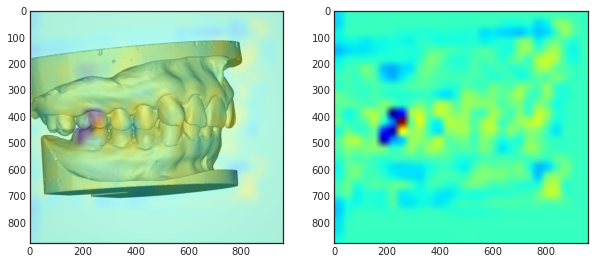

 78%|███████▊  | 306/392 [05:40<01:44,  1.22s/it]

306 _label =  0.0    predict =  0 , pred =  [0.8721 0.0809 0.0469]


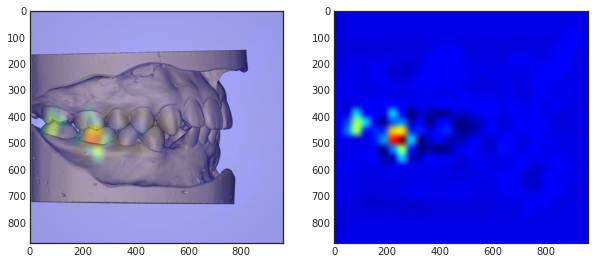

 78%|███████▊  | 307/392 [05:41<01:38,  1.16s/it]

307 _label =  -1.0    predict =  -1 , pred =  [2.108e-01 2.000e-04 7.891e-01]


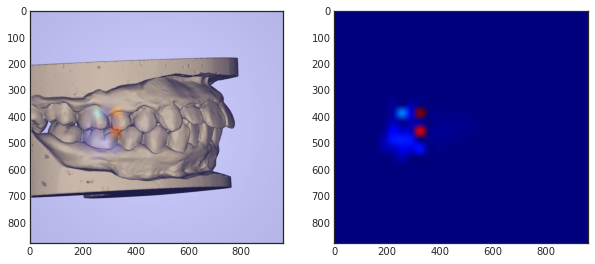

 79%|███████▊  | 308/392 [05:42<01:34,  1.12s/it]

308 _label =  0.0    predict =  0 , pred =  [0.8744 0.0751 0.0505]


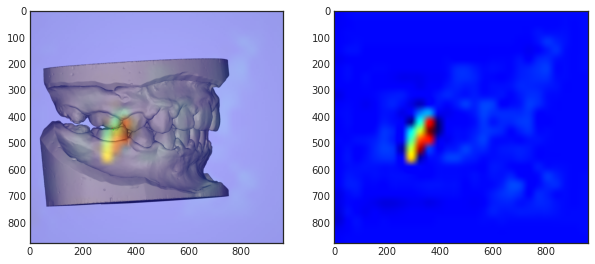

 79%|███████▉  | 309/392 [05:43<01:34,  1.14s/it]

309 _label =  1.0    predict =  1 , pred =  [0.0449 0.9551 0.    ]


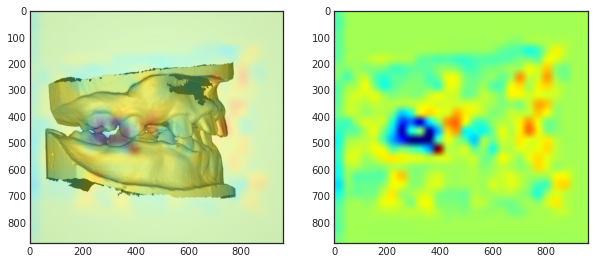

 79%|███████▉  | 310/392 [05:44<01:31,  1.11s/it]

310 _label =  -1.0    predict =  -1 , pred =  [0.1015 0.     0.8985]


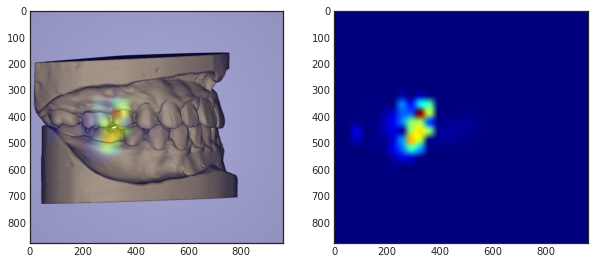

 79%|███████▉  | 311/392 [05:45<01:28,  1.10s/it]

311 _label =  -1.0    predict =  -1 , pred =  [0.0908 0.     0.9092]


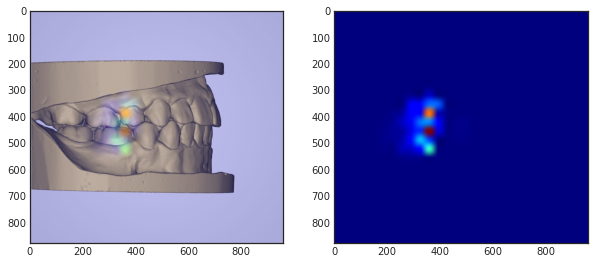

 80%|███████▉  | 312/392 [05:46<01:26,  1.09s/it]

312 _label =  -1.0    predict =  -1 , pred =  [0.1164 0.     0.8836]


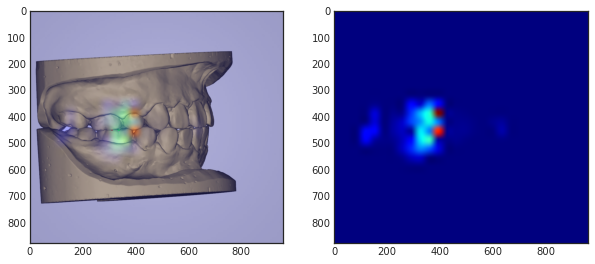

 80%|███████▉  | 313/392 [05:47<01:25,  1.08s/it]

313 _label =  0.0    predict =  0 , pred =  [0.8769 0.0653 0.0578]


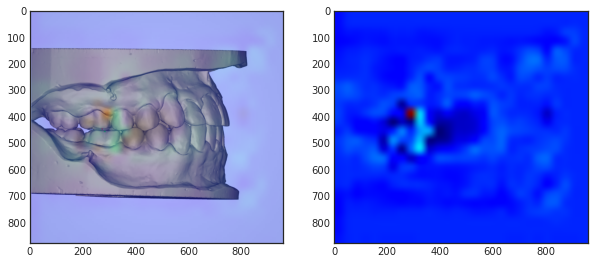

 80%|████████  | 314/392 [05:49<01:29,  1.14s/it]

314 _label =  0.0    predict =  -1 , pred =  [0.1058 0.     0.8941]


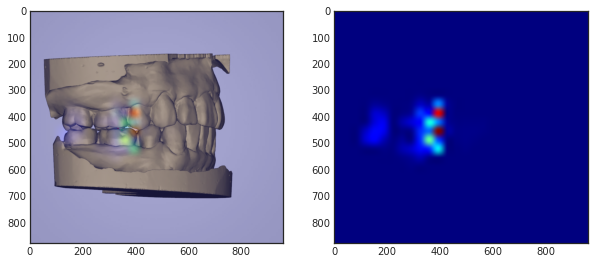

 80%|████████  | 315/392 [05:50<01:27,  1.14s/it]

315 _label =  1.0    predict =  0 , pred =  [0.7694 0.0116 0.219 ]


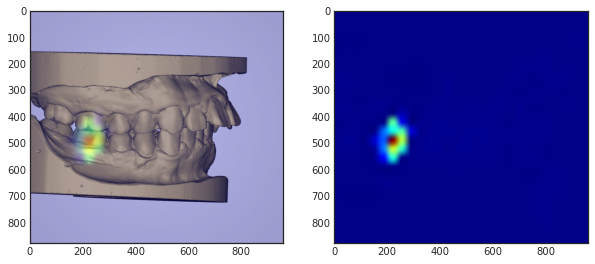

 81%|████████  | 316/392 [05:51<01:27,  1.15s/it]

316 _label =  -1.0    predict =  -1 , pred =  [0.0624 0.     0.9375]


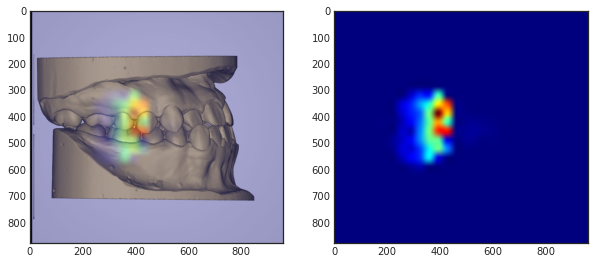

 81%|████████  | 317/392 [05:52<01:23,  1.11s/it]

317 _label =  0.0    predict =  0 , pred =  [0.8775 0.0578 0.0647]


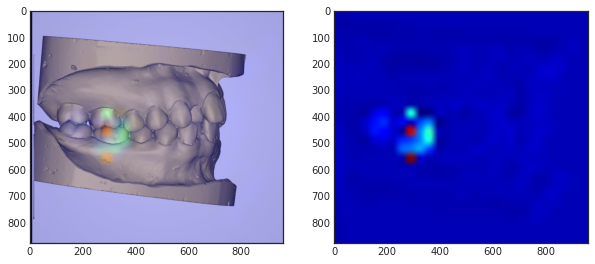

 81%|████████  | 318/392 [05:53<01:24,  1.15s/it]

318 _label =  0.0    predict =  0 , pred =  [0.8757 0.0708 0.0535]


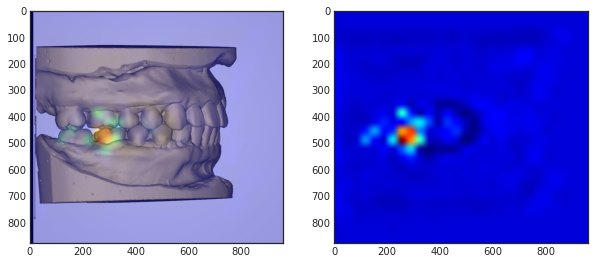

 81%|████████▏ | 319/392 [05:54<01:22,  1.13s/it]

319 _label =  0.0    predict =  0 , pred =  [0.8731 0.0786 0.0483]


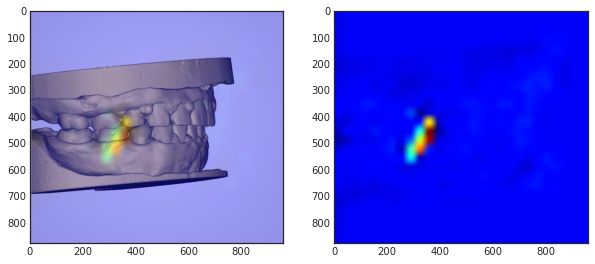

 82%|████████▏ | 320/392 [05:55<01:20,  1.12s/it]

320 _label =  0.0    predict =  0 , pred =  [0.8725 0.08   0.0475]


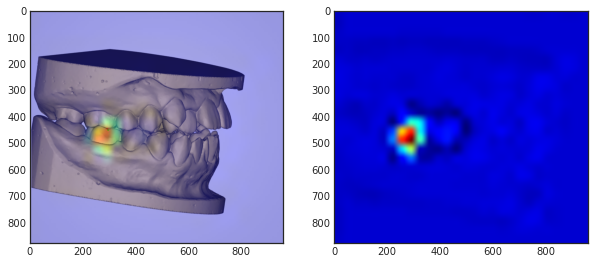

 82%|████████▏ | 321/392 [05:57<01:28,  1.25s/it]

321 _label =  0.0    predict =  1 , pred =  [0.0482 0.9518 0.    ]


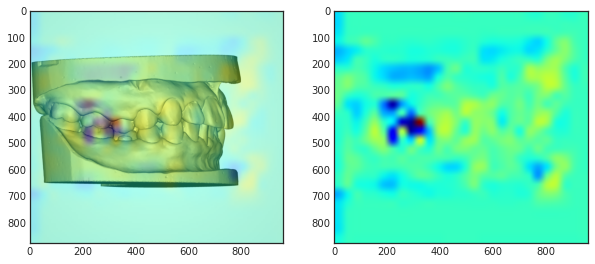

 82%|████████▏ | 322/392 [05:58<01:26,  1.24s/it]

322 _label =  -1.0    predict =  -1 , pred =  [0.1067 0.     0.8932]


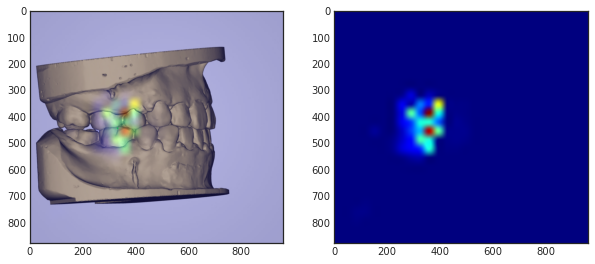

 82%|████████▏ | 323/392 [05:59<01:21,  1.19s/it]

323 _label =  0.0    predict =  0 , pred =  [0.8719 0.0815 0.0466]


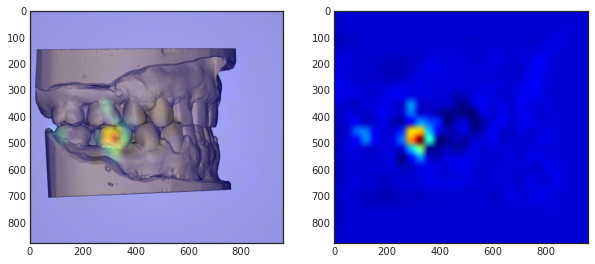

 83%|████████▎ | 324/392 [06:00<01:21,  1.20s/it]

324 _label =  -1.0    predict =  -1 , pred =  [0.1019 0.     0.8981]


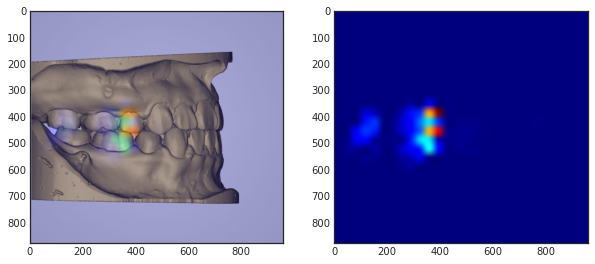

 83%|████████▎ | 325/392 [06:02<01:19,  1.19s/it]

325 _label =  -1.0    predict =  -1 , pred =  [1.204e-01 1.000e-04 8.795e-01]


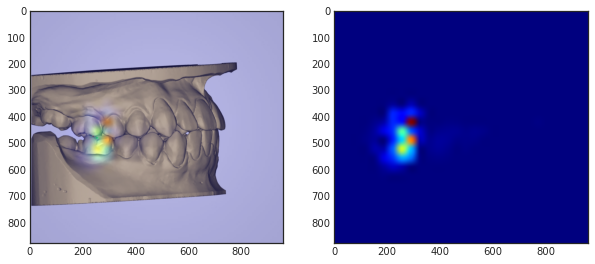

 83%|████████▎ | 326/392 [06:03<01:18,  1.19s/it]

326 _label =  0.0    predict =  0 , pred =  [0.8736 0.0772 0.0492]


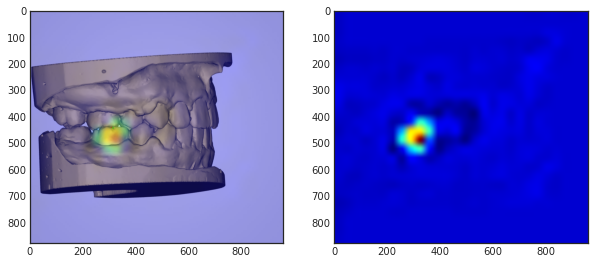

 83%|████████▎ | 327/392 [06:04<01:14,  1.15s/it]

327 _label =  -1.0    predict =  -1 , pred =  [0.0817 0.     0.9183]


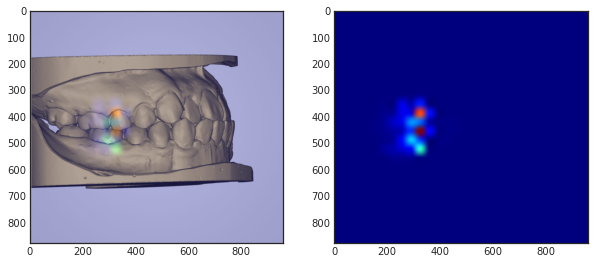

 84%|████████▎ | 328/392 [06:05<01:11,  1.12s/it]

328 _label =  0.0    predict =  0 , pred =  [0.8542 0.0286 0.1172]


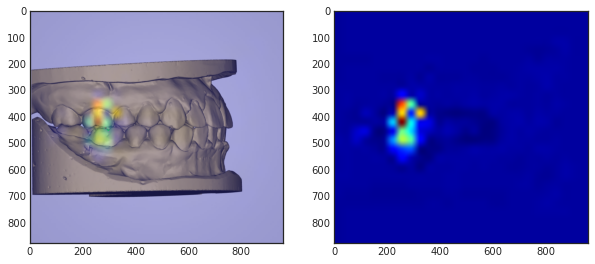

 84%|████████▍ | 329/392 [06:06<01:09,  1.10s/it]

329 _label =  1.0    predict =  1 , pred =  [0.0446 0.9554 0.    ]


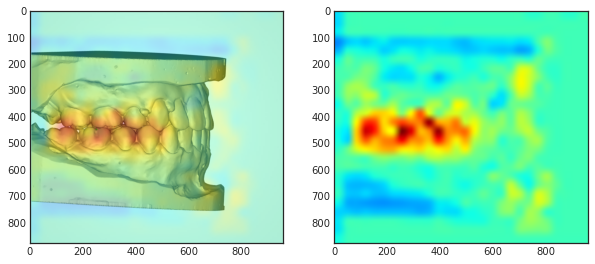

 84%|████████▍ | 330/392 [06:07<01:08,  1.10s/it]

330 _label =  -1.0    predict =  -1 , pred =  [2.938e-01 4.000e-04 7.058e-01]


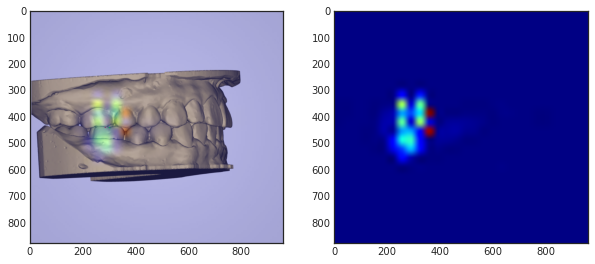

 84%|████████▍ | 331/392 [06:08<01:06,  1.09s/it]

331 _label =  0.0    predict =  0 , pred =  [0.873  0.0788 0.0482]


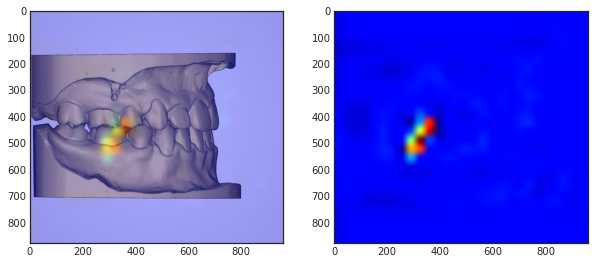

 85%|████████▍ | 332/392 [06:09<01:05,  1.09s/it]

332 _label =  0.0    predict =  0 , pred =  [0.8733 0.078  0.0487]


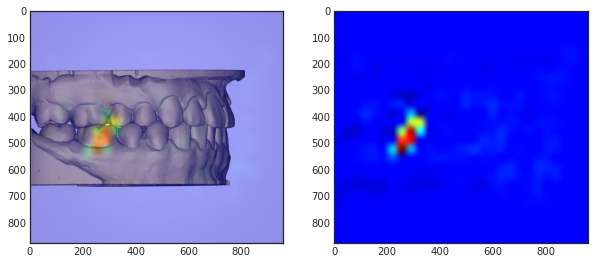

 85%|████████▍ | 333/392 [06:10<01:04,  1.09s/it]

333 _label =  1.0    predict =  1 , pred =  [0.0396 0.9604 0.    ]


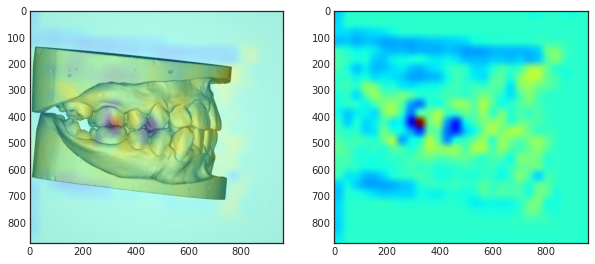

 85%|████████▌ | 334/392 [06:11<01:04,  1.12s/it]

334 _label =  -1.0    predict =  -1 , pred =  [0.0859 0.     0.9141]


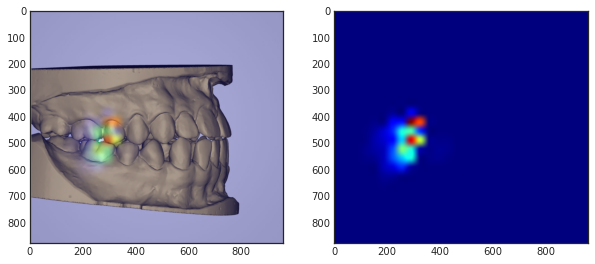

 85%|████████▌ | 335/392 [06:12<01:02,  1.09s/it]

335 _label =  0.0    predict =  -1 , pred =  [0.054 0.    0.946]


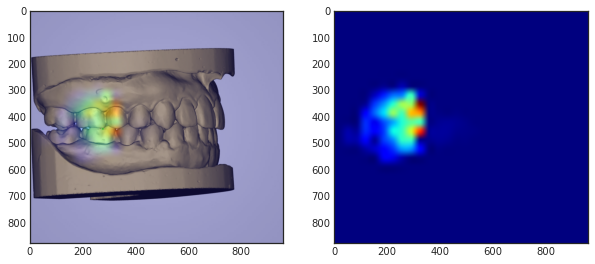

 86%|████████▌ | 336/392 [06:14<01:02,  1.12s/it]

336 _label =  -1.0    predict =  0 , pred =  [0.8638 0.0973 0.0389]


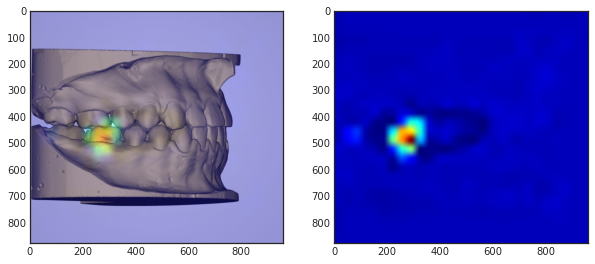

 86%|████████▌ | 337/392 [06:15<01:01,  1.11s/it]

337 _label =  0.0    predict =  0 , pred =  [0.8697 0.0862 0.0441]


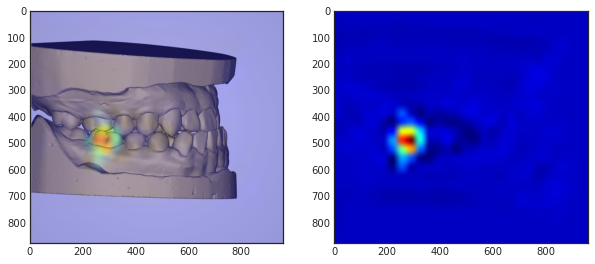

 86%|████████▌ | 338/392 [06:16<01:00,  1.12s/it]

338 _label =  -1.0    predict =  -1 , pred =  [0.0867 0.     0.9133]


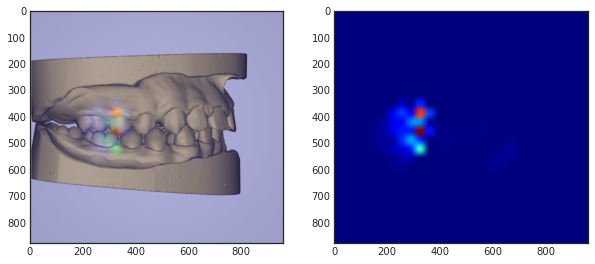

 86%|████████▋ | 339/392 [06:17<01:01,  1.15s/it]

339 _label =  1.0    predict =  1 , pred =  [0.0297 0.9702 0.    ]


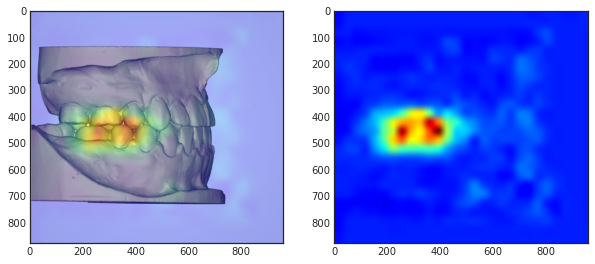

 87%|████████▋ | 340/392 [06:18<00:58,  1.12s/it]

340 _label =  0.0    predict =  1 , pred =  [0.0405 0.9595 0.    ]


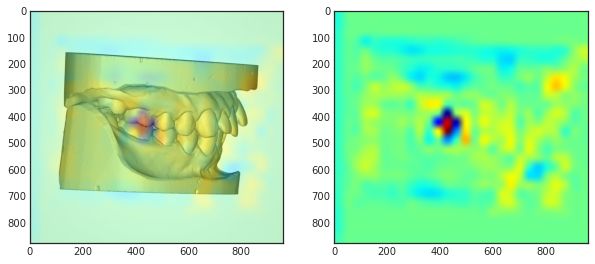

 87%|████████▋ | 341/392 [06:19<00:56,  1.10s/it]

341 _label =  1.0    predict =  0 , pred =  [0.6992 0.0069 0.2939]


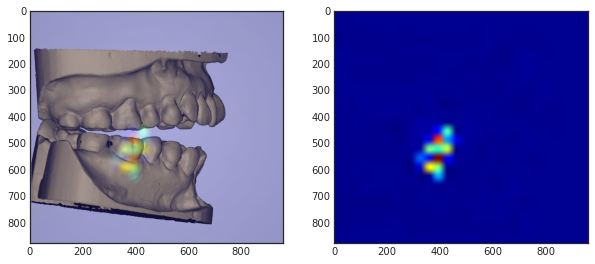

 87%|████████▋ | 342/392 [06:20<00:53,  1.08s/it]

342 _label =  -1.0    predict =  -1 , pred =  [0.0719 0.     0.9281]


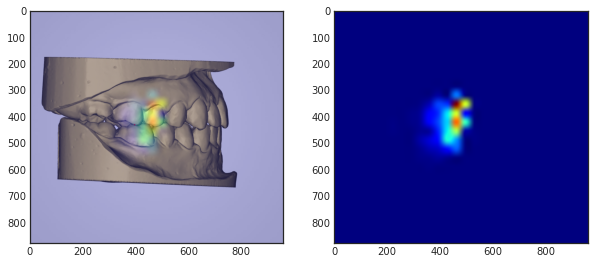

 88%|████████▊ | 343/392 [06:22<00:59,  1.21s/it]

343 _label =  1.0    predict =  1 , pred =  [0.0337 0.9663 0.    ]


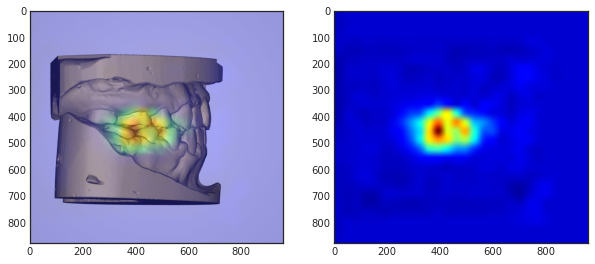

 88%|████████▊ | 344/392 [06:23<00:55,  1.15s/it]

344 _label =  1.0    predict =  1 , pred =  [0.0358 0.9642 0.    ]


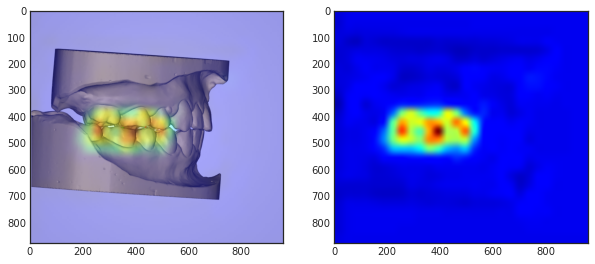

 88%|████████▊ | 345/392 [06:24<00:52,  1.12s/it]

345 _label =  1.0    predict =  1 , pred =  [0.0341 0.9659 0.    ]


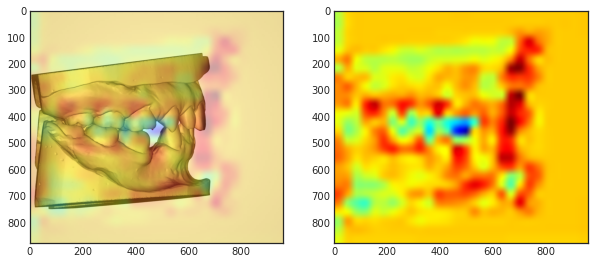

 88%|████████▊ | 346/392 [06:25<00:50,  1.10s/it]

346 _label =  -1.0    predict =  -1 , pred =  [0.0624 0.     0.9376]


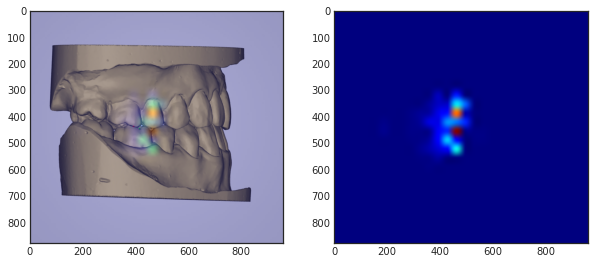

 89%|████████▊ | 347/392 [06:26<00:48,  1.08s/it]

347 _label =  1.0    predict =  1 , pred =  [0.035 0.965 0.   ]


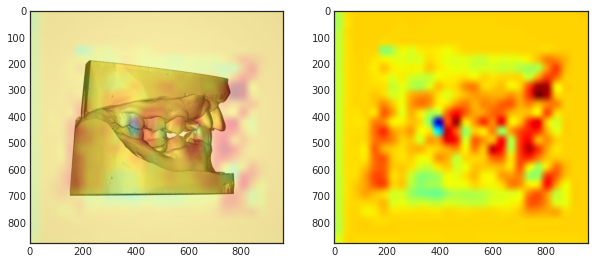

 89%|████████▉ | 348/392 [06:27<00:46,  1.06s/it]

348 _label =  1.0    predict =  0 , pred =  [0.7837 0.1995 0.0167]


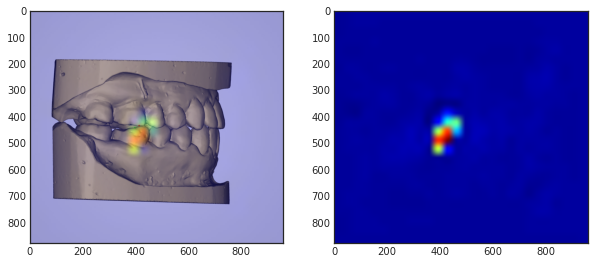

 89%|████████▉ | 349/392 [06:28<00:45,  1.05s/it]

349 _label =  -1.0    predict =  -1 , pred =  [0.0816 0.     0.9184]


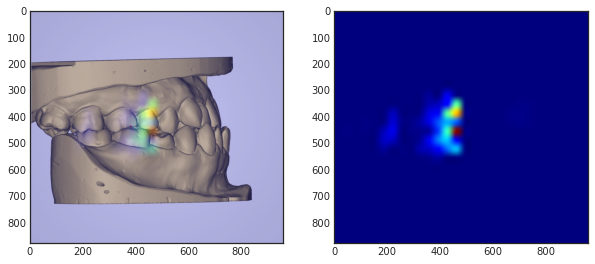

 89%|████████▉ | 350/392 [06:29<00:44,  1.05s/it]

350 _label =  1.0    predict =  1 , pred =  [1.547e-01 8.451e-01 2.000e-04]


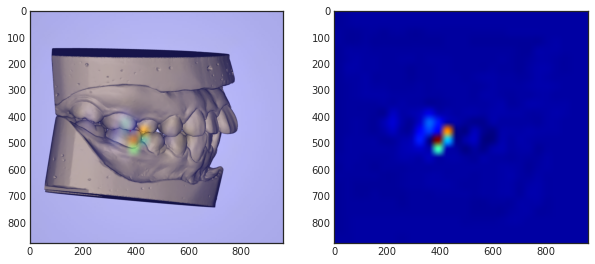

 90%|████████▉ | 351/392 [06:30<00:45,  1.10s/it]

351 _label =  1.0    predict =  1 , pred =  [1.845e-01 8.152e-01 3.000e-04]


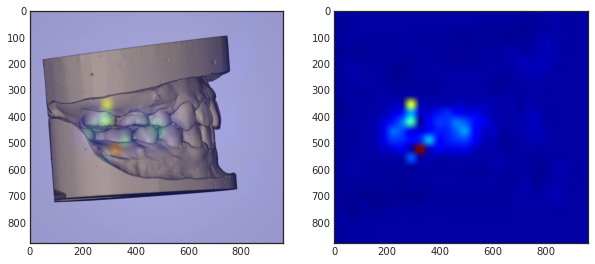

 90%|████████▉ | 352/392 [06:31<00:46,  1.15s/it]

352 _label =  1.0    predict =  1 , pred =  [0.0501 0.9499 0.    ]


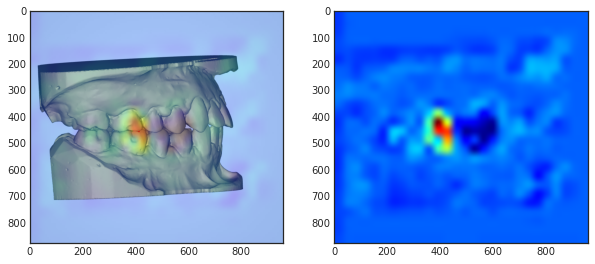

 90%|█████████ | 353/392 [06:33<00:44,  1.14s/it]

353 _label =  0.0    predict =  0 , pred =  [0.8743 0.0753 0.0504]


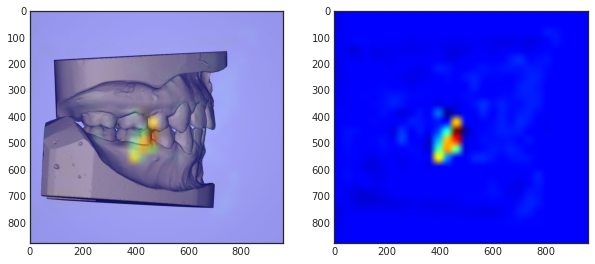

 90%|█████████ | 354/392 [06:34<00:42,  1.11s/it]

354 _label =  1.0    predict =  1 , pred =  [8.630e-02 9.136e-01 1.000e-04]


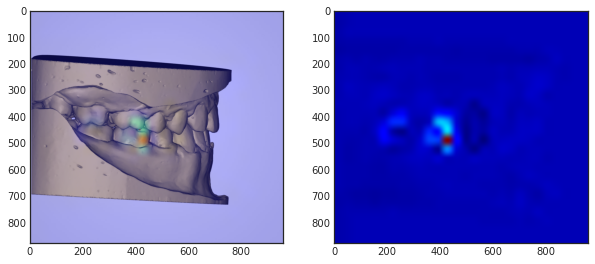

 91%|█████████ | 355/392 [06:35<00:40,  1.09s/it]

355 _label =  -1.0    predict =  0 , pred =  [0.6929 0.0066 0.3004]


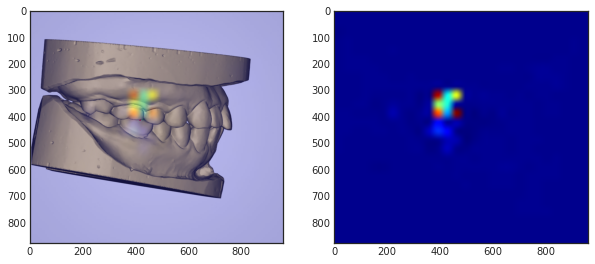

 91%|█████████ | 356/392 [06:36<00:40,  1.13s/it]

356 _label =  1.0    predict =  1 , pred =  [0.035 0.965 0.   ]


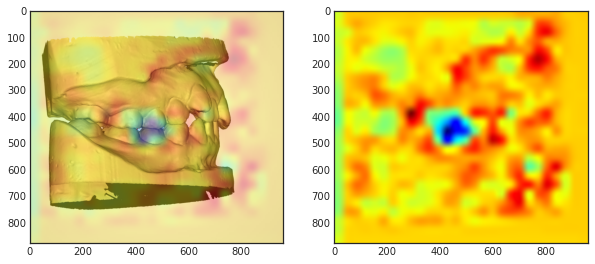

 91%|█████████ | 357/392 [06:37<00:38,  1.11s/it]

357 _label =  1.0    predict =  1 , pred =  [2.581e-01 7.413e-01 6.000e-04]


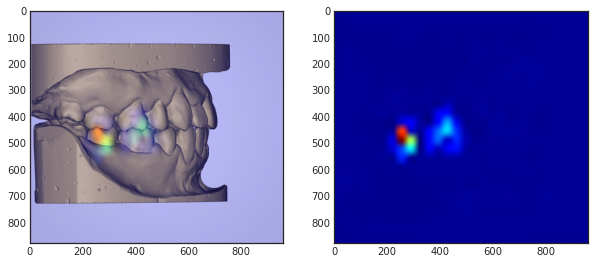

 91%|█████████▏| 358/392 [06:38<00:37,  1.10s/it]

358 _label =  1.0    predict =  1 , pred =  [0.0256 0.9744 0.    ]


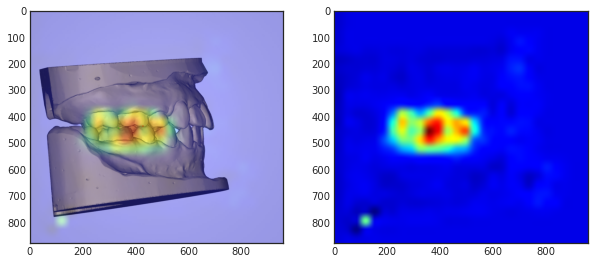

 92%|█████████▏| 359/392 [06:39<00:35,  1.08s/it]

359 _label =  0.0    predict =  0 , pred =  [0.8771 0.064  0.0588]


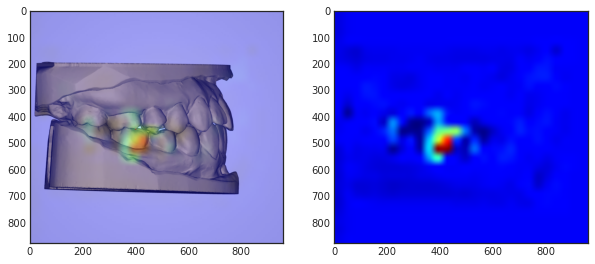

 92%|█████████▏| 360/392 [06:40<00:35,  1.11s/it]

360 _label =  0.0    predict =  0 , pred =  [0.8568 0.1085 0.0347]


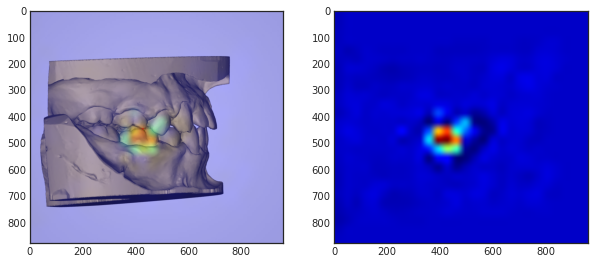

 92%|█████████▏| 361/392 [06:41<00:35,  1.13s/it]

361 _label =  1.0    predict =  1 , pred =  [0.0435 0.9565 0.    ]


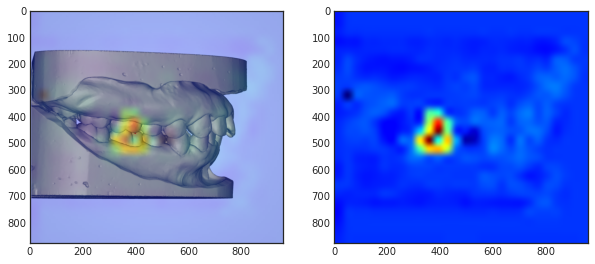

 92%|█████████▏| 362/392 [06:42<00:33,  1.12s/it]

362 _label =  -1.0    predict =  -1 , pred =  [0.0879 0.     0.9121]


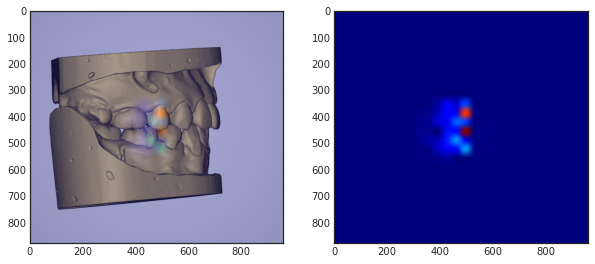

 93%|█████████▎| 363/392 [06:44<00:32,  1.11s/it]

363 _label =  -1.0    predict =  -1 , pred =  [0.1006 0.     0.8994]


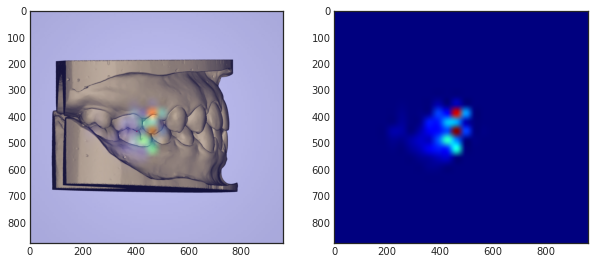

 93%|█████████▎| 364/392 [06:45<00:30,  1.10s/it]

364 _label =  1.0    predict =  0 , pred =  [0.874  0.076  0.0499]


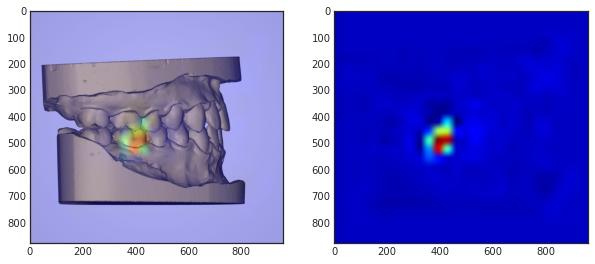

 93%|█████████▎| 365/392 [06:46<00:33,  1.25s/it]

365 _label =  1.0    predict =  1 , pred =  [0.0336 0.9664 0.    ]


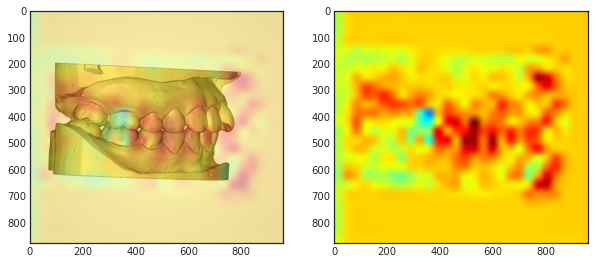

 93%|█████████▎| 366/392 [06:47<00:31,  1.19s/it]

366 _label =  0.0    predict =  0 , pred =  [0.8775 0.0585 0.064 ]


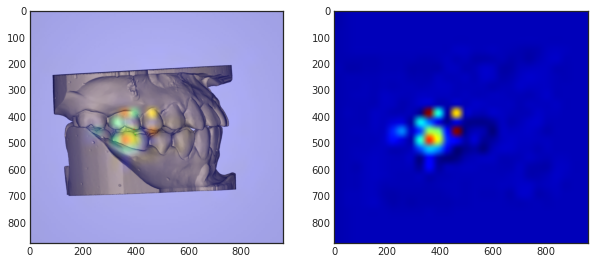

 94%|█████████▎| 367/392 [06:48<00:28,  1.15s/it]

367 _label =  1.0    predict =  1 , pred =  [0.0398 0.9602 0.    ]


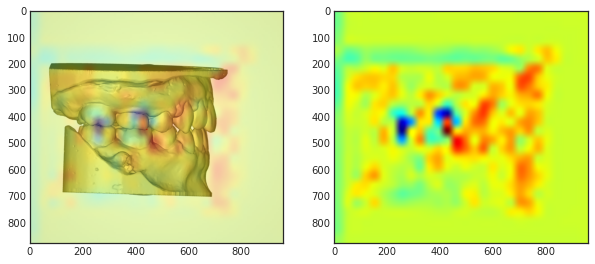

 94%|█████████▍| 368/392 [06:49<00:26,  1.11s/it]

368 _label =  1.0    predict =  1 , pred =  [0.0368 0.9632 0.    ]


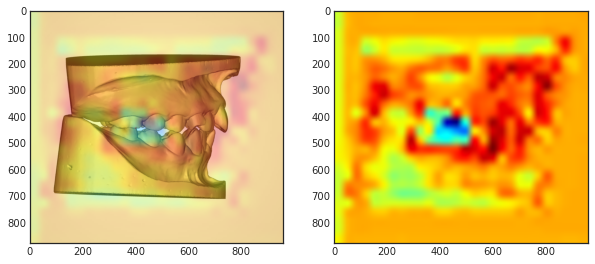

 94%|█████████▍| 369/392 [06:50<00:25,  1.10s/it]

369 _label =  -1.0    predict =  -1 , pred =  [0.0769 0.     0.9231]


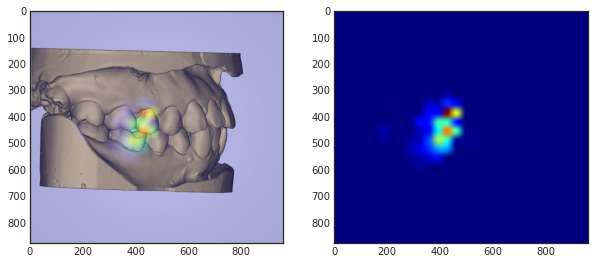

 94%|█████████▍| 370/392 [06:51<00:23,  1.07s/it]

370 _label =  1.0    predict =  1 , pred =  [0.0471 0.9529 0.    ]


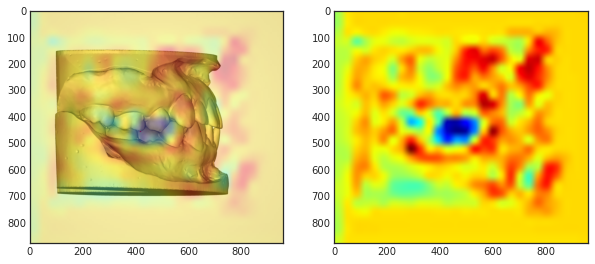

 95%|█████████▍| 371/392 [06:53<00:22,  1.08s/it]

371 _label =  1.0    predict =  1 , pred =  [0.3413 0.6575 0.0011]


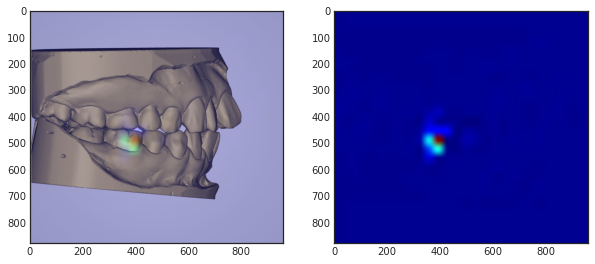

 95%|█████████▍| 372/392 [06:54<00:22,  1.10s/it]

372 _label =  -1.0    predict =  -1 , pred =  [0.0836 0.     0.9164]


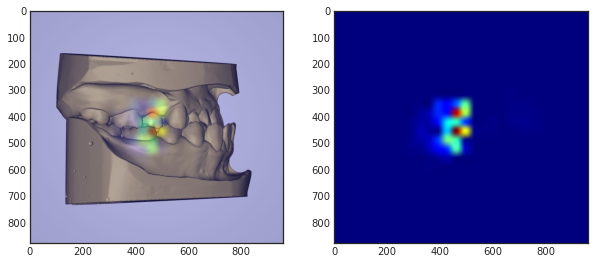

 95%|█████████▌| 373/392 [06:55<00:20,  1.09s/it]

373 _label =  1.0    predict =  1 , pred =  [1.672e-01 8.325e-01 2.000e-04]


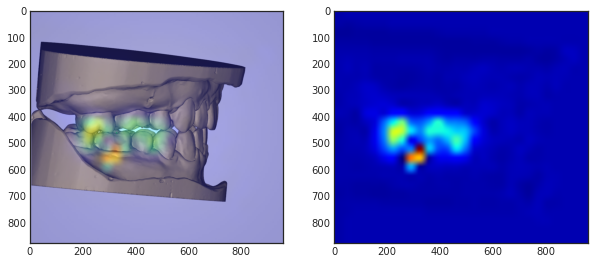

 95%|█████████▌| 374/392 [06:56<00:19,  1.09s/it]

374 _label =  1.0    predict =  1 , pred =  [0.0462 0.9538 0.    ]


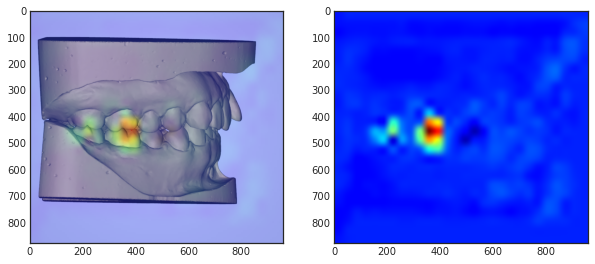

 96%|█████████▌| 375/392 [06:57<00:19,  1.16s/it]

375 _label =  0.0    predict =  0 , pred =  [0.8701 0.0854 0.0445]


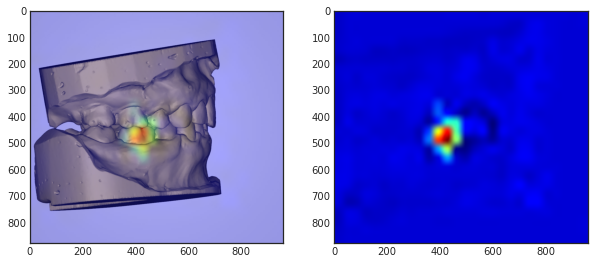

 96%|█████████▌| 376/392 [06:58<00:18,  1.14s/it]

376 _label =  0.0    predict =  0 , pred =  [0.8759 0.07   0.0541]


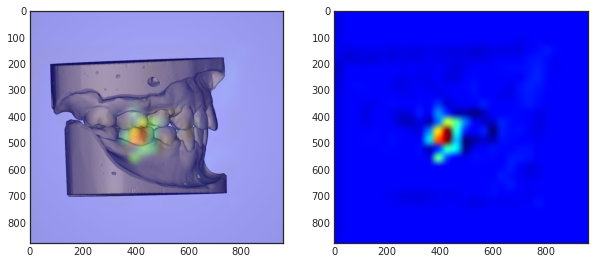

 96%|█████████▌| 377/392 [06:59<00:16,  1.11s/it]

377 _label =  -1.0    predict =  -1 , pred =  [0.0617 0.     0.9383]


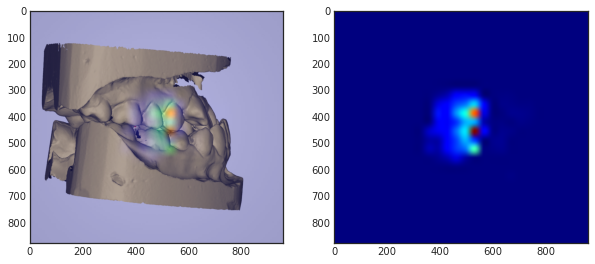

 96%|█████████▋| 378/392 [07:00<00:15,  1.10s/it]

378 _label =  1.0    predict =  1 , pred =  [0.037  0.9629 0.    ]


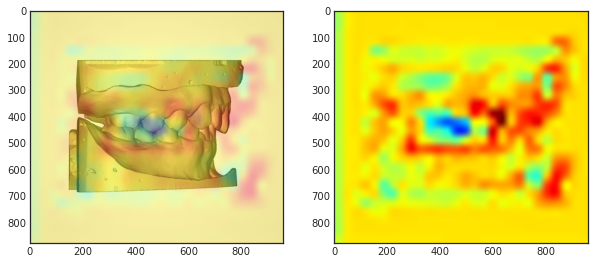

 97%|█████████▋| 379/392 [07:01<00:14,  1.09s/it]

379 _label =  -1.0    predict =  -1 , pred =  [0.0666 0.     0.9334]


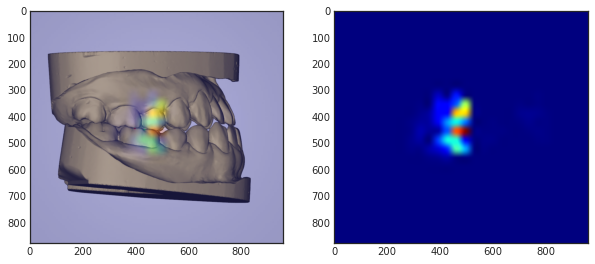

 97%|█████████▋| 380/392 [07:03<00:13,  1.13s/it]

380 _label =  1.0    predict =  1 , pred =  [0.0224 0.9776 0.    ]


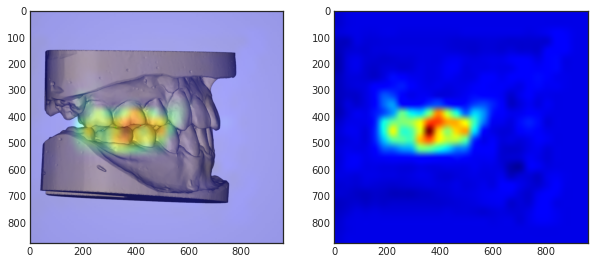

 97%|█████████▋| 381/392 [07:04<00:12,  1.12s/it]

381 _label =  0.0    predict =  0 , pred =  [0.8751 0.0728 0.0521]


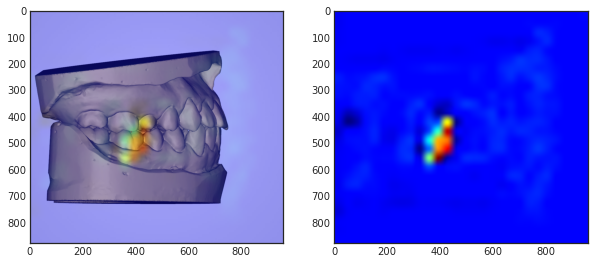

 97%|█████████▋| 382/392 [07:05<00:11,  1.10s/it]

382 _label =  1.0    predict =  1 , pred =  [0.0394 0.9606 0.    ]


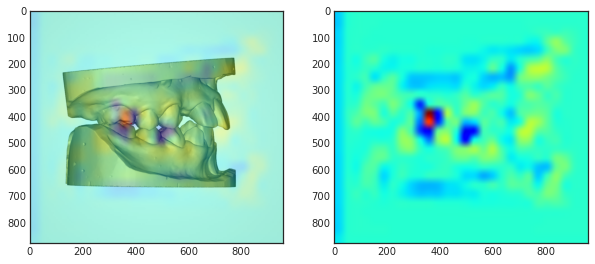

 98%|█████████▊| 383/392 [07:06<00:10,  1.14s/it]

383 _label =  1.0    predict =  1 , pred =  [0.0459 0.954  0.    ]


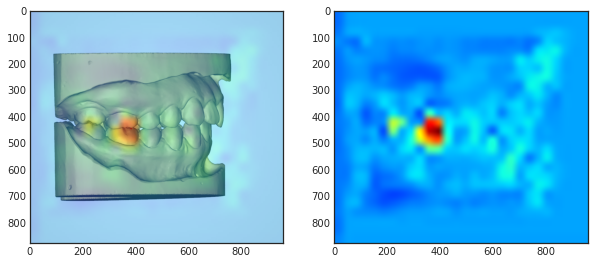

 98%|█████████▊| 384/392 [07:07<00:09,  1.13s/it]

384 _label =  0.0    predict =  0 , pred =  [0.8736 0.0773 0.0491]


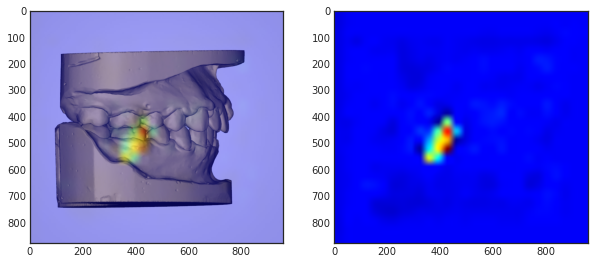

 98%|█████████▊| 385/392 [07:08<00:08,  1.15s/it]

385 _label =  1.0    predict =  -1 , pred =  [0.1023 0.     0.8976]


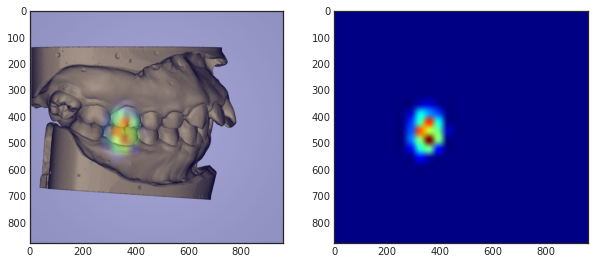

 98%|█████████▊| 386/392 [07:09<00:06,  1.13s/it]

386 _label =  -1.0    predict =  0 , pred =  [0.8762 0.0687 0.0551]


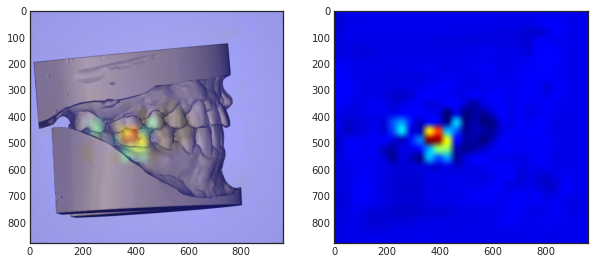

 99%|█████████▊| 387/392 [07:11<00:06,  1.27s/it]

387 _label =  0.0    predict =  -1 , pred =  [0.1079 0.     0.8921]


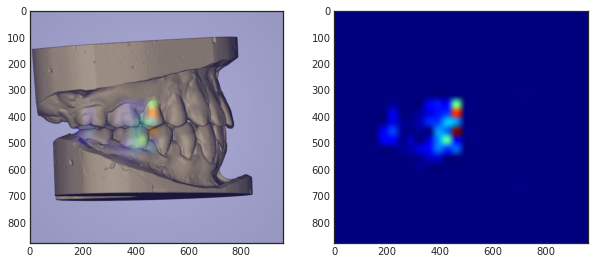

 99%|█████████▉| 388/392 [07:12<00:04,  1.21s/it]

388 _label =  -1.0    predict =  -1 , pred =  [0.0753 0.     0.9246]


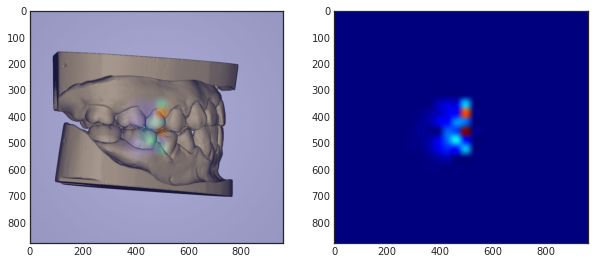

 99%|█████████▉| 389/392 [07:13<00:03,  1.21s/it]

389 _label =  0.0    predict =  0 , pred =  [0.8408 0.131  0.0281]


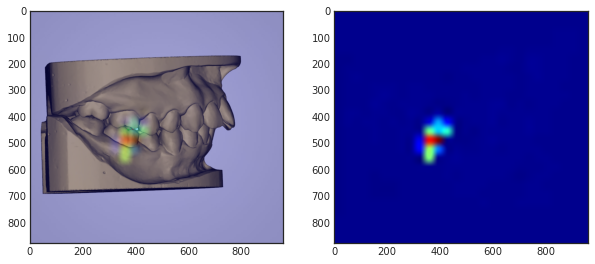

 99%|█████████▉| 390/392 [07:14<00:02,  1.16s/it]

390 _label =  0.0    predict =  -1 , pred =  [2.098e-01 2.000e-04 7.900e-01]


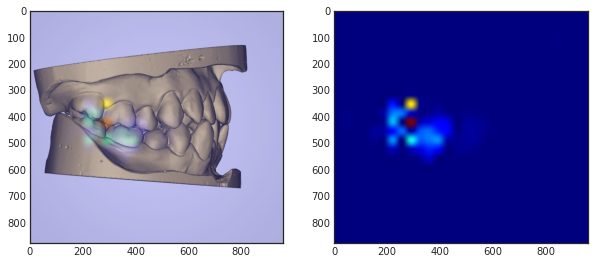

100%|█████████▉| 391/392 [07:15<00:01,  1.12s/it]

391 _label =  1.0    predict =  1 , pred =  [0.0345 0.9655 0.    ]


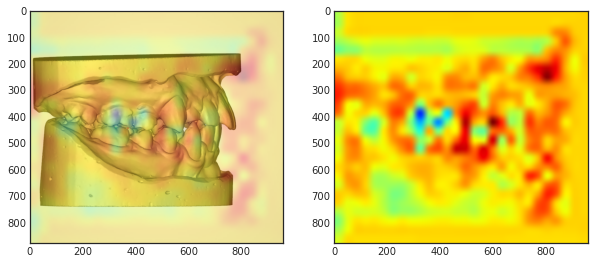

100%|██████████| 392/392 [07:17<00:00,  1.11s/it]


In [60]:
import matplotlib.cm as cm

# idx = widgets.IntSlider(min=0, max=len(x_test), step=1)

model_list = []
for i in model.layers:
    model_list.append(i.name)
    
last_conv_layer_name = "conv_7b_ac"
last_c_idx = model_list.index(last_conv_layer_name)
classifier_layer_names = model_list[last_c_idx+1:]

# disable classification softmax
model.layers[-2].activation = None
count=0

for idx in tqdm(range(len(x_test))):
    #input
    gen_img= x_test[idx:idx+1]
    gen_label= y_test[idx:idx+1]
    
    preds, heatmap = make_gradcam_heatmap(gen_img, model, last_conv_layer_name, pred_index = None)


    pred_idx = np.argmax(np.array(preds[1][0]))
    if pred_idx==2:
        pred_idx = int(-1)
    
    count +=1
    img= cv.cvtColor(gen_img[0], cv.COLOR_BGR2RGB)
    jet_heatmap, superimposed_img = overlay(heatmap, img)

    plt.figure(figsize=(10,5))
    plt.subplot(1,2,1)
    plt.imshow(superimposed_img)
    plt.subplot(1,2,2)
    plt.imshow(jet_heatmap)

    print(idx,'_label = ', y_test[idx], '   predict = ', pred_idx , ", pred = ", np.round(tf.nn.softmax(np.array(preds[1][0])), decimals=4))
    plt.show()